## Importing some stuff

In [17]:
import simpy
import random
import gym
import numpy as np
import pandas as pd

### Flow shop environment

In [18]:
observation_space = gym.spaces.Tuple((gym.spaces.Discrete(3),gym.spaces.Discrete(3),
                                                  gym.spaces.Discrete(3),gym.spaces.Discrete(3),
                                                  gym.spaces.Discrete(21),gym.spaces.Discrete(21),
                                                  gym.spaces.Discrete(21),gym.spaces.Discrete(21),
                                                  gym.spaces.Discrete(3)))

In [25]:
class flowshopGym:
    import random
    # --------------------------------------INITIALIZE THINGS------------------------------------------
    def __init__(self):
        self.NUM_PRODUCTS = 20
        self.IAT = 1 # change this to sample from some distribution
        self.action_space = gym.spaces.Discrete(2)
        self.observation_space = gym.spaces.Discrete(9)
        # Rich observation space
        # Product type for the 4 product type, time left for the 4 products, product type in machine
        # For more details Thesis notes book on Notability
        self.observation_space = gym.spaces.Tuple((gym.spaces.Discrete(3),gym.spaces.Discrete(3),
                                                  gym.spaces.Discrete(3),gym.spaces.Discrete(3),
                                                  gym.spaces.Discrete(21),gym.spaces.Discrete(21),
                                                  gym.spaces.Discrete(21),gym.spaces.Discrete(21),
                                                  gym.spaces.Discrete(3)))
        #self.observation_space = spaces.Box(-high, high, dtype=np.float32)
        self.prod_and_requests = []
        self.reward = 0 
        self.cumulative_reward = 0
        
        self.state_format = 'Hosp'
    # --------------------------------------DEFINE PROCESSES------------------------------------------
    
    # Process 1 - Spawn of products
    def _newProduct(self):
        print("Entered new product process")
        # Produce X number of products
        for i in range(self.NUM_PRODUCTS):
            
            # Creating instances of the product 
            self.instances.append(self.product(self,self.envSimpy,'Product_%d' % i,i/100, self.machine))
            #print("Product " + str(i) + "created")
            # call the Request machine process
            #self.envSimpy.process(self._requestMachine()) # removing this because this is being done inside instances
            # IAT TIMEOUT BEFORE THE NEXT SPAWN
            #next_admission = random.expovariate(1 / interarrival_time)
            yield self.envSimpy.timeout(self.IAT)
    

    
    # --------------------------------------DEFINE FUNCTIONS------------------------------------------
    
    def getObservation(self):
        # Calculate the states 
        states = []
        if self.machine.queue:
            for i in (self.machine.queue):
                states.append(((self.relater(i)).number)*100)
        
        #Checking the length of the states and filling the rest with zeros
        if len(states) < self.NUM_PRODUCTS:
            for i in range(self.NUM_PRODUCTS - len(states)):
                states.append(0)
        states = np.array(states).reshape(self.NUM_PRODUCTS,1)
        
        states = states.flatten()
        print("My states ----- ",states)
        return states
    
    def getObs(self): # delete the getObservation function once this function is properly defined. 

            
        states = dict()
        #states['current_time'] = self.envSimpy.now # current simulation time

        # Getting details of the product in machine queue
        if sim.machine.queue != []: # if the machine queue is not empty
            prod_req_1 = self.relater(sim.machine.queue[0]) # first product in the queue
            #states['MC1_queue1_due'] = prod_req_1.production_end # Due date of the first product in the queue at machine 1
            MC1_queue1_due = prod_req_1.production_end # Due date of the first product in the queue at machine 1

            states['MC1_queue1_type'] = prod_req_1.prod_type # Product type of the first product in the queue at machine 1
            #states['time left'] = MC1_queue1_due - self.envSimpy.now # +ve = good / -ve = bad
        else:
            #states['MC1_queue1_due'] = None
            states['MC1_queue1_type'] = 0 
            #states['time left'] = None

        # Getting details of the product inside the machine
        if sim.machine.users != []: #if there is someone using the machine
            states['MC1_prod_type'] = (self.relater(sim.machine.users[0])).prod_type # Product type of the product inside machine 1
        else:
            states['MC1_prod_type'] = 0


        
        
            
            
        obs = [v for k,v in states.items()]    
        print("------ obs ", obs)
        


        #return self.encode(obs)
        return tuple(obs)
    
    def encode(self, obs):
        print('Entered encode')
        # (3), 3 [Machine queue type, machine product type]
        i = obs[0] 
        i *= 3
        
        i += obs[1]
        print("Value of i inside encode ", i)
        return i
    
    def doneFn(self):
        # So the condition is, 
        #(no items in queue1 + queue2 + ...) AND 
        #(no machine is running)
        
        if self.machine.queue != None:
            lenQueue = len(self.machine.queue)
        else: 
            lenQueue = 0 
        lenMachinesUsed = self.machine.count
        #print("Queue length",lenQueue, "no machines used", lenMachinesUsed)
        if lenQueue == 0 and lenMachinesUsed == 0: 
            #print("length of queue ",lenQueue,"Machines used ", lenMachinesUsed)
            return True
        else:
            #print("length of queue ",lenQueue,"Machines used ", lenMachinesUsed)
            return False
    
    # A function to relate products and requests
    def relater(self,item):
        # Note that the input to this function shouldn't be a list. It should be of 
        # type request or product
        output_item = None
        if item == type(list):
            print("Error passed in a list. Expecting request or product object")
            return None
        # If the input is a request
        if type(item) == simpy.resources.resource.Request:
            for i, j in enumerate(self.prod_and_requests):
                if j[1] == item:
                    output_item = j[0]
                    return output_item
        elif type(item) == simpy.resources.resource.Request: #if the input is a product 
            for i, j in enumerate(self.prod_and_requests):
                if j[0] == item:
                    output_item = j[1]
                    return output_item   
    
    
    # --------------------------------------RENDER------------------------------------------
    
    
    
    
    # --------------------------------------RESET------------------------------------------
    def reset(self):
        print("Entered Reset")
        # Initialise simpy environemnt and a machine
        self.envSimpy = simpy.Environment()
        self.machine = simpy.Resource(self.envSimpy,capacity = 1)
        #self.machine.maxlen = 3 
        # Initial variable definitions
        self.time_start = self.envSimpy.now
        self.next_time_stop = self.time_start + 1
        self.time_step = 0.99 
        self.time_step_terminal = self.time_start + 100
        self.current_action = 0
        self.instances = []
         
        # Set up starting processes
        self.envSimpy.process(self._newProduct())
        
        # Set starting state values

        
        # Inital load of patients (to average occupancy)
        #self._load_patients()
        
        # Starting values of observations
        observations = self.getObs()
        
        # Put state dictionary items into observations list (Define observations)
        #observations = [v for k,v in self.state.items()]
        return observations
    
    
    
    
    # --------------------------------------STEP------------------------------------------
    
    def step(self, action):
        
        # Define params
        self.current_action = action
        self.action_taken = False 
        self.info = {}
        self.reward = 0 
        #print("machine is used by",sim.machine.users)
        # Run for time_step
        self.next_time_stop += self.time_step
        self.envSimpy.run(until = self.next_time_stop)
    
        # Get values
        observation = self.getObs()
        done = self.doneFn()
        info = self.info
        self.cumulative_reward += self.reward
        # Return values
        return (observation, sim.reward, done, info)
    
    
    class product(object):
        def __init__(self, flowshopGym, envSimpy, name, number, machine):
            
            # Creating the required resources and environment
            self.envSimpy = envSimpy

            # State space variables
            self.prod_type = random.randint(1,2) # the product type of the product.
            print("Product type ###---", self.prod_type)
            self.production_end = random.randint(20,90)
            
            # Rest of the variables
            self.prod_state = 1 # the state of production. 1 implies raw material. 2 implies first operation done and so on. 
            self.production_time = random.randint(1,8)  
            self.name = name
            self.number = number
            self.machine = machine 
            #self.production()
            self.envSimpy.process(self.production())
            
            #self.action_taken_event = envSimpy.event
            # Defining Events        
            #self.action_accepted_event = envSimpy.event()            
            # Defining processes
            #self.check_accepted_proc = envSimpy.process(self.check_accepted(envSimpy))


            
        def production(self):
            # the first step in production is requesting for a machine
            #print('entered production ' + self.name)
            with self.machine.request() as req:
                
                sim.prod_and_requests.append([self,req])
                #print('waiting for the request to succeed ' + str(self.name))
                yield req
                print('Start production of ' + str(self.name) + ' at '+ str(self.envSimpy.now)  )
                #print("Request of the product ", envGym.relater(self))
                print('Production time is ' + str(self.production_time))
                yield self.envSimpy.timeout(self.production_time)
                self.tardiness = self.envSimpy.now - self.production_end   # -ve is good; +ve is bad 
                
                # End of production 
                print('End production of ' + str(self.name) + ' at ' + str(self.envSimpy.now))
                
                
                # Wait for an acceptance only when there are products in the machine.queue
                if (sim.machine.queue) != []:
                    # Pass time when the action chosen by the agent is rejection
                    i = 0
                    while True:
                        if i == 0:
                            yield self.envSimpy.timeout(1)
                        i += 1

                        #print("Inside current_action", sim.current_action)

                        if sim.current_action == 1: #rejected
                            
                            # rearrange the machine queue to reflect the rejection
                            sim.machine.queue.insert(len(sim.machine.queue), sim.machine.queue.pop(0))
                            print("Action rejected; Passing time by 1 ", i)
                            print("Machine queue,prod types ", sim.machine.queue, sim.getObs())
                            print("Current time " + str(self.envSimpy.now))
                            print("Machine product type ",)
                            print("Queue item 1 product type ", )
                            yield self.envSimpy.timeout(1)




                            # rearrange the machine queue to reflect the rejection
                            #self.machine.queue.insert(len(self.machine.queue), self.machine.queue.pop(0))


                            # print the rearranged machine queue
                            #print('#observation_after')
                            #print(envGym.getObservation())



                        else: #if action accepted
                            print("Action accepted")
                            break
                else:
                    pass
                    
                
                # Decide the reward 
                if self.tardiness <= 0:
                    sim.reward = 10 
                else: 
                    sim.reward = 0
                print("Tardiness is ",self.tardiness)
                # Production has ended now I have to take the next action using take_action()
                # envGym.machine.queue = envGym.take_action()
                #envGym.machine.queue = []
        

### Overall flow - Mine

In [26]:
sim = flowshopGym()
sim.reset()
while True: # This while is for one full cycle of products (20 nos, currently)

    # Choosing the action
    #action = envGym.action_space.sample() # Random agent
    # action = 0 #FIFO
    #action = random.randint(0,1)
    action = sim.action_space.sample()
    print('Action space from the gym ', action)
    # Taking a step
    print("---------------New Cycle----------------")
    #print("Action from the agent " + str(action))
    obs, reward, done, info = sim.step(action) # the env here is gym
    if done:
        print( "End of simulation at " ,sim.envSimpy.now)
        print("Total cumulative reward ", sim.cumulative_reward)
        break
    print("Reward achieved is ", reward)

    #print("Action chosen by the agent ", action)
    #print("Action taken by the environment ", )
     

Entered Reset
------ obs  [0, 0]
Action space from the gym  1
---------------New Cycle----------------
Entered new product process
Product type ###--- 1
Start production of Product_0 at 0
Production time is 3
Product type ###--- 1
------ obs  [1, 1]
Reward achieved is  0
Action space from the gym  1
---------------New Cycle----------------
Product type ###--- 1
------ obs  [1, 1]
Reward achieved is  0
Action space from the gym  0
---------------New Cycle----------------
End production of Product_0 at 3
Product type ###--- 2
------ obs  [1, 1]
Reward achieved is  0
Action space from the gym  1
---------------New Cycle----------------
Action rejected; Passing time by 1  1
------ obs  [1, 1]
Machine queue,prod types  [<Request() object at 0x11f551e10>, <Request() object at 0x11f551518>, <Request() object at 0x11f551cc0>] (1, 1)
Current time 4
Machine product type 
Queue item 1 product type 
Product type ###--- 2
------ obs  [1, 1]
Reward achieved is  0
Action space from the gym  0
-------

Machine product type 
Queue item 1 product type 
------ obs  [1, 1]
Reward achieved is  0
Action space from the gym  1
---------------New Cycle----------------
Action rejected; Passing time by 1  7
------ obs  [1, 1]
Machine queue,prod types  [<Request() object at 0x11f5c4dd8>, <Request() object at 0x11f5c4fd0>, <Request() object at 0x11f521a58>] (1, 1)
Current time 118
Machine product type 
Queue item 1 product type 
------ obs  [1, 1]
Reward achieved is  0
Action space from the gym  0
---------------New Cycle----------------
Action accepted
Tardiness is  38
Start production of Product_5 at 119
Production time is 7
------ obs  [1, 1]
Reward achieved is  0
Action space from the gym  0
---------------New Cycle----------------
------ obs  [1, 1]
Reward achieved is  0
Action space from the gym  1
---------------New Cycle----------------
------ obs  [1, 1]
Reward achieved is  0
Action space from the gym  1
---------------New Cycle----------------
------ obs  [1, 1]
Reward achieved is  0
Ac

In [4]:
np.floor(-41.72999999999972)

-42.0

### Overall flow - Q-learning - Taxi env

#### Random agent

In [4]:
q_table = np.zeros([sim.observation_space.n, sim.action_space.n])

AttributeError: 'Resource' object has no attribute 'maxlen'

In [20]:
sim = flowshopGym()
state = sim.reset()
epochs = 0
penalties, reward = 0, 0
epsilon = 0.1
done = False

while not done:
    #action = sim.action_space.sample()
    action = np.argmax(Q1[state])
    if random.uniform(0, 1) < epsilon:
            action = sim.action_space.sample() # Explore action space
    else:
        action = np.argmax(Q1[state]) # Exploit learned values
    print("State ---",state)
    state, reward, done, info = sim.step(action)

    if reward == 0:
        penalties += 1
    


    epochs += 1
    
    
print("Timesteps taken: {}".format(epochs))
print("Penalties incurred: {}".format(penalties))

Entered Reset
------ obs  [0, 0]


NameError: name 'Q1' is not defined

In [161]:
for i,j in enumerate(sim.prod_and_requests):
    if sim.prod_and_requests[i][0].prod_type == 2:
        print(sim.prod_and_requests[i][0].prod_type, sim.prod_and_requests[i][1])


2 <Request() object at 0x1275fd080>
2 <Request() object at 0x127be5320>
2 <Request() object at 0x127827898>
2 <Request() object at 0x127827dd8>
2 <Request() object at 0x127827128>
2 <Request() object at 0x127bd1a58>
2 <Request() object at 0x127bd1898>
2 <Request() object at 0x127bd1ac8>
2 <Request() object at 0x127bd1470>
2 <Request() object at 0x127bd12b0>
2 <Request() object at 0x127538550>
2 <Request() object at 0x127538940>


In [115]:
test = [1,2,3]


2

In [6]:
q_table

array([[0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.],
       [0., 0.]])

#### Q-learning


In [117]:
import numpy as np
q_table = np.zeros([sim.observation_space.n, sim.action_space.n])
Q1 = defaultdict(lambda: np.zeros(sim.action_space.n)) 

In [118]:
%%time
sim = flowshopGym()
sim.reset()

"""Training the agent"""

import random
from IPython.display import clear_output

# Hyperparameters
alpha = 0.1
gamma = 0.6
epsilon = 0.1

# For plotting metrics
all_epochs = []
all_penalties = []


for i in range(1, 101):
    state = sim.reset()

    epochs, penalties, reward, = 0, 0, 0
    done = False
    
    while not done:
        if random.uniform(0, 1) < epsilon:
            action = sim.action_space.sample() # Explore action space
        else:
            action = np.argmax(Q1[state]) # Exploit learned values

        next_state, reward, done, info = sim.step(action) 
        print("state, action", state, action)
        old_value = Q1[state][action]
        next_max = np.max(Q1[next_state])
        
        new_value = (1 - alpha) * old_value + alpha * (reward + gamma * next_max)
        Q1[state][action] = new_value

        if reward == 0:
            penalties += 1

        state = next_state
        epochs += 1
    all_penalties.append(penalties)
        
    if i % 100 == 0:
        clear_output(wait=True)
        print(f"Episode: {i}")

print("Training finished.\n")

Episode: 100
Training finished.

CPU times: user 13.5 s, sys: 3.26 s, total: 16.8 s
Wall time: 22.3 s


In [97]:
Q1

defaultdict(<function __main__.<lambda>()>,
            {0: array([1.56510796, 1.05028461]),
             4: array([1.50000225, 1.57683317]),
             7: array([2.90819502, 1.32967736]),
             5: array([4.1500554 , 1.57449629]),
             8: array([2.8205365 , 1.36138743]),
             2: array([0.28803671, 0.39699348]),
             1: array([0.23291868, 0.38584855])})

In [119]:
Q1 

defaultdict(<function __main__.<lambda>()>,
            {(0, 0): array([1.63972553, 0.51607131]),
             (2, 1): array([1.63301715, 0.90905576]),
             (2, 2): array([0.95649143, 0.99376922]),
             (1, 2): array([2.04594213, 1.29976921]),
             (1, 1): array([2.39967208, 1.05223378]),
             (0, 2): array([0.25846174, 0.7329941 ]),
             (0, 1): array([0.23148586, 0.47297879])})

#### Q - learning implementation 2 

In [13]:
import gym 

import itertools 

import matplotlib 

import matplotlib.style 

import numpy as np 

import pandas as pd 

import sys 

from collections import defaultdict 
import plotting 
import numpy as np
  

matplotlib.style.use('ggplot') 

In [32]:
def createEpsilonGreedyPolicy(Q, epsilon, num_actions): 

    """ 

    Creates an epsilon-greedy policy based 

    on a given Q-function and epsilon. 

       

    Returns a function that takes the state 
a
    as an input and returns the probabilities 

    for each action in the form of a numpy array  

    of length of the action space(set of possible actions). 

    """

    def policyFunction(state):
        

        Action_probabilities = np.ones(num_actions, 

                dtype = float) * epsilon / num_actions 

                  

        best_action = np.argmax(Q[state]) 

        Action_probabilities[best_action] += (1.0 - epsilon) 

        return Action_probabilities 

   

    return policyFunction 
 

def qLearning(env, num_episodes, discount_factor = 1.0, 

                            alpha = 0.6, epsilon = 0.1): 

    """ 

    Q-Learning algorithm: Off-policy TD control. 

    Finds the optimal greedy policy while improving 

    following an epsilon-greedy policy"""

       

    # Action value function 

    # A nested dictionary that maps 

    # state -> (action -> action-value). 

    Q = defaultdict(lambda: np.zeros(env.action_space.n)) 

   

    # Keeps track of useful statistics 

    stats = plotting.EpisodeStats( 

        episode_lengths = np.zeros(num_episodes), 

        episode_rewards = np.zeros(num_episodes))     

       

    # Create an epsilon greedy policy function 

    # appropriately for environment action space 

    policy = createEpsilonGreedyPolicy(Q, epsilon, env.action_space.n) 

       

    # For every episode 

    for ith_episode in range(num_episodes): 

           

        # Reset the environment and pick the first action 

        state = env.reset() 
        #print("This is my state format ",state)
           

        for t in itertools.count(): 

               

            # get probabilities of all actions from current state 

            action_probabilities = policy(state) 

   

            # choose action according to  

            # the probability distribution 

            action = np.random.choice(np.arange( 

                      len(action_probabilities)), 

                       p = action_probabilities) 

   

            # take action and get reward, transit to next state 

            next_state, reward, done, _ = env.step(action) 
            print("This is the next state from step ",next_state)
               

            # Update statistics 

            stats.episode_rewards[ith_episode] += reward 

            stats.episode_lengths[ith_episode] = t 

               

            # TD Update 

            best_next_action = np.argmax(Q[next_state])     

            td_target = reward + discount_factor * Q[next_state][best_next_action] 

            td_delta = td_target - Q[state][action] 

            Q[state][action] += alpha * td_delta 

   

            # done is True if episode terminated    

            if done: 

                break

                   

            state = next_state 

       

    return Q, stats 

In [38]:
sim = flowshopGym()

In [39]:
%%time
Q, stats = qLearning(sim, 1000) 

Entered Reset
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
Entered new product process
Start production of Product_0 at 0
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5


Start production of Product_17 at 71
Production time is 3
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_17 at 74
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -1
Start production of Product_18 at 75
Production time is 1
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_18 at 76
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the n

Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_19 at 78
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 79
------ obs  {'MC1_queue1_typ

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 44
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  11
Start production of Product_12 at 45
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_12 at 47
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  -28
Start production of Product_13 at 48
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Ent

Action rejected; Passing time by 1  14
Current time 151
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 152
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 153
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 154
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 155
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  19
Current tim

Action rejected; Passing time by 1  4
Current time 238
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 239
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 240
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 241
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 242
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 243


Action rejected; Passing time by 1  1
Current time 6
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -57
Start production of Product_2 at 7
Production time is 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_2 at 12
------ obs  {'MC1_q

Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  12
Current time 115
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 116
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 117
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 118
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 119
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 217
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  12
Current time 218
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 219
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 220
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 221
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 370
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 371
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 372
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 373
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 374
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is

Action rejected; Passing time by 1  67
Current time 471
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  68
Current time 472
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  69
Current time 473
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  70
Current time 474
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  71
Current time 475
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  72
Current tim

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  27
Current time 85
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  28
Current time 86
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  29
Current time 87
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  30
Current time 88
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  31
Current time 89
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


This is the next state from step  4
Action rejected; Passing time by 1  59
Current time 185
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  60
Current time 186
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  61
Current time 187
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  62
Current time 188
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  63
Current time 189
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejecte

Current time 288
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 289
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 290
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 291
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 292
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 293
------ obs  {'MC1_queue1_type': 1, '

Action rejected; Passing time by 1  3
Current time 36
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  11
Start production of Product_10 at 37
Production time is 3
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_10 at 40
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -16
Start production of Product_11 at 41
Production time is 4
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Ent

Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  72
Current time 144
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  73
Current time 145
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  74
Current time 146
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  75
Current time 147
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  76
Current time 148
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is

This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_18 at 270
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 271
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 272
------ obs  {'

Action rejected; Passing time by 1  15
Current time 119
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 120
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 121
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 122
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  19
Current time 123
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  20
Current tim

Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 226
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 227
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 228
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 229
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 230
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 350
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 351
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 352
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 353
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 354
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1

This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 101
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 102
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 103
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 104
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 105
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Pa

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  35
Current time 200
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  36
Current time 201
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  37
Current time 202
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  38
Current time 203
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  39
Current time 204
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_0 at 6
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 9
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_15 at 127
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 128
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 129
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 130
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 131
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Valu

This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_4 at 212
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 213
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  144
Start production of Product_18 at 214
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the n

Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 76
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 77
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 78
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 79
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 80
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step

Action rejected; Passing time by 1  13
Current time 188
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 189
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 190
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 191
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 192
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current tim

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 19
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 20
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  4
Current time 21
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  5
Current time 22
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  6
Current time 23
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Enter

This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_6 at 133
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 134
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 135
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 136
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 137
------ obs  {'MC1_queue1_type': 1, 'MC1

This is the next state from step  4
Action rejected; Passing time by 1  35
Current time 245
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  36
Current time 246
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  37
Current time 247
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  38
Current time 248
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  39
Current time 249
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejecte

Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 65
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 66
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  4
Current time 67
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  5
Current time 68
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  6
Current time 69
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step

Action rejected; Passing time by 1  62
Current time 181
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  63
Current time 182
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  64
Current time 183
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  65
Current time 184
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  66
Current time 185
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  67
Current tim

Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  241
Start production of Product_8 at 324
Production time is 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_8 at 329
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Actio

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  15
Current time 61
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  16
Current time 62
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  17
Current time 63
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  18
Current time 64
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  19
Current time 65
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}


Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  117
Start production of Product_18 at 161
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1

Start production of Product_6 at 265
Production time is 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_6 at 268
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 269
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 270
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from s

Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_15 at 56
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  33
Start production of Product_16 at 57
Production time is 2
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_16 at 59
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  22
Start production of Product_17 at 60
Production time is 2
------ obs  {'

End production of Product_12 at 27
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 28
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -13
Start production of Product_14 at 29
Production time is 6
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'M

Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
End production of Product_8 at 147
Tardiness is  67
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
This is the next state from step  0
Entered Reset
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
Entered new product process
Start production of Product_0 at 0
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_

Current time 107
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  38
Current time 108
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  39
Current time 109
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  40
Current time 110
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  41
Current time 111
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  42
Current time 112
------ obs  {'MC1_queue1_type': 1

Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_7 at 30
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 31
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -35
Start prod

Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_1 at 14
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5


Action rejected; Passing time by 1  53
Current time 119
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  54
Current time 120
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  55
Current time 121
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  56
Current time 122
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  57
Current time 123
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  58
Current tim

This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_11 at 215
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 216
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 217
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 218
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 219
------ obs  {'MC1_queue1_type': 1, 'MC

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_15 at 48
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 49
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 50
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -1
Start production of 

Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  32
Current time 139
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  33
Current time 140
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  34
Current time 141
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  35
Current time 142
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  36
Current time 143
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state

Action rejected; Passing time by 1  34
Current time 236
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  35
Current time 237
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  36
Current time 238
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  148
Start production of Product_19 at 239
Production time is 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode

Action rejected; Passing time by 1  34
Current time 331
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  35
Current time 332
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  36
Current time 333
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  37
Current time 334
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  38
Current time 335
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  39
Current tim

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_2 at 103
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 104
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  16
Start production of Product_11 at 105
Production time is 1
------ obs  {'

Action rejected; Passing time by 1  4
Current time 185
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 186
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 187
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 188
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 189
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 190


Start production of Product_6 at 66
Production time is 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_6 at 72
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is

Action rejected; Passing time by 1  4
Current time 174
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 175
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 176
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 177
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 178
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 179


This is the next state from step  4
Action rejected; Passing time by 1  97
Current time 267
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  98
Current time 268
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  99
Current time 269
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  100
Current time 270
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  101
Current time 271
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejec

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 364
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 365
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  12
Current time 366
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 367
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 368
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_11 at 60
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing ti

Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 156
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 157
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 158
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 159
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 160
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is

This is the next state from step  4
Action rejected; Passing time by 1  22
Current time 237
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  23
Current time 238
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  24
Current time 239
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  25
Current time 240
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  26
Current time 241
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejecte

Action rejected; Passing time by 1  30
Current time 108
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  31
Current time 109
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  32
Current time 110
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  33
Current time 111
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  34
Current time 112
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  39
Start production 

Action rejected; Passing time by 1  5
Current time 199
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 200
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 201
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 202
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 203
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_7 at 31
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 32
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is th

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_11 at 138
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 139
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 140
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 141
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from ste

This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_6 at 22
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -59
Start production of Product_7 at 23
Production time is 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 

Action rejected; Passing time by 1  8
Current time 113
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  24
Start production of Product_16 at 114
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_16 at 116
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 117
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 118
------ obs  {'MC1_queue1_type': 1, 'M

Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  -6
Start production of Product_7 at 71
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_7 at 75
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  4
Start production of Product_8 at 76
Production time is 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 43
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -6
Start production of Product_11 at 44
Production time is 8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type':

Tardiness is  35
Start production of Product_4 at 116
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_4 at 118
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  83
Start production of Product_6 at 119
Production time is 1
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_6 at 120
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  84
Start production of Product_9 at 121
Production time is 2
---

Action rejected; Passing time by 1  28
Current time 88
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  29
Current time 89
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  30
Current time 90
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  -10
Start production of Product_17 at 91
Production time is 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Val

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_1 at 10
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -44
Start production of Product_3 at 11
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_3 at 13
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1

Production time is 8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_p

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_12 at 133
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  106
Start production of Product_13 at 134
Production time is 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered enco

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  34
Start production of Product_14 at 55
Production time is 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_6 at 101
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 102
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 103
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 104
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step

Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  42
Current time 173
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  43
Current time 174
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  44
Current time 175
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  45
Current time 176
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  46
Current time 177
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  81
Current time 284
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  82
Current time 285
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  83
Current time 286
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  84
Current time 287
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  85
Current time 288
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

Action rejected; Passing time by 1  4
Current time 352
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  277
Start production of Product_5 at 353
Production time is 4
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
End production of Product_5 at 357
Tardiness is  315
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
This is the next state from step

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  15
Current time 60
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  16
Current time 61
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  17
Current time 62
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  18
Current time 63
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  19
Current time 64
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_15 at 128
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 129
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 130
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 131
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from ste

Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_12 at 216
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 217
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 218
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state

Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_0 at 6
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_2 at 108
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 109
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 110
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 111
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 188
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 189
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 190
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 191
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 192
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


Action rejected; Passing time by 1  50
Current time 265
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  51
Current time 266
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  52
Current time 267
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  53
Current time 268
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  54
Current time 269
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  55
Current tim

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 331
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  258
Start production of Product_6 at 332
Production time is 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_6 at 335
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action reject

End production of Product_15 at 57
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  16
Start production of Product_16 at 58
Production time is 5
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_16 at 63
------ obs  {'MC1_queue1_type': 2, 

Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  22
Current time 166
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  23
Current time 167
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  24
Current time 168
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  25
Current time 169
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  26
Current time 170
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_17 at 51
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -16
Start production of Product_18 at 52
Production time is 6
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode

This is the next state from step  4
End production of Product_11 at 143
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  62
Start production of Product_13 at 144
Production time is 8
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_19 at 77
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 78
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 79
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 80
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  4
Current time 81
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of 

Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 159
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 160
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 161
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 162
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 163
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the 

Action rejected; Passing time by 1  9
Current time 50
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -4
Start production of Product_18 at 51
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_18 at 55
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected;

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  24
Current time 155
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  85
Start production of Product_13 at 156
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_13 at 160
------ obs  

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  31
Current time 258
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  32
Current time 259
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  33
Current time 260
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  34
Current time 261
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  35
Current time 262
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  224
Start production of Product_7 at 345
Production time is 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_7 at 350
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode

Action rejected; Passing time by 1  43
Current time 427
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  44
Current time 428
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  45
Current time 429
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  46
Current time 430
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  47
Current time 431
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  48
Current tim

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_17 at 54
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  25
Start production of Product_18 at 55
Production time is 2
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_18 at 57
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -13
S

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_5 at 32
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 33
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is th

Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 115
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  93
Start production of Product_6 at 116
Production time is 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_17 at 72
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 73
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 74
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 75
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  4
Current time 76
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of 

Start production of Product_6 at 157
Production time is 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_6 at 163
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_2 at 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 9
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 10
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -45
Start production of Pr

Current time 96
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  27
Current time 97
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  4
Start production of Product_19 at 98
Production time is 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 

Action rejected; Passing time by 1  2
Current time 180
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 181
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 182
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  103
Start production of Product_10 at 183
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_10 at 185
------ obs  {'MC1_queue1_type': 1, '

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 30
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 31
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  3
Start production of Product_1 at 32
Production time is 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_9 at 116
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  52
Start production of Product_10 at 117
Production time is 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode

Current time 43
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 44
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 45
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  4
Current time 46
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -23
Start production of Product_16 at 47
Production time is 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Enter

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_5 at 166
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 167
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  4
Current time 9
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  5
Current time 10
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  6
Current time 11
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  7
Current time 12
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered

This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_3 at 122
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 123
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 124
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected

This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_7 at 224
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 225
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 226
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 227
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode

Current time 323
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  264
Start production of Product_4 at 324
Production time is 7
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside

Action rejected; Passing time by 1  12
Current time 109
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  13
Current time 110
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  14
Current time 111
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  15
Current time 112
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  16
Current time 113
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  17
Current tim

Action rejected; Passing time by 1  2
Current time 200
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 201
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 202
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 203
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 204
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 205


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_1 at 14
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -19
Start production of Product_2 at 15
Production time is 5
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
V

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_5 at 114
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 115
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 116
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 117
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 204
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 205
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 206
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 207
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 208
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  27
Current time 284
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  28
Current time 285
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  29
Current time 286
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  209
Start production of Product_4 at 287
Production time is 8
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode


Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 87
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 88
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  31
Start production of Product_5 at 89
Production time is 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encod

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_12 at 182
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 183
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 184
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 185
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 186
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Valu

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_1 at 11
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -66
Start production of Product_2 at 12
Production time is 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
V

Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  42
Start production of Product_16 at 105
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_16 at 109
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  89
Start production of Product_8 at 110
Production time is 6
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_ty

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 92
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 93
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 94
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 95
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 96
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Enter

Start production of Product_17 at 177
Production time is 1
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_17 at 178
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 179
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 180
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 181
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 182
------ obs  {'M

Action rejected; Passing time by 1  28
Current time 76
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  29
Current time 77
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  30
Current time 78
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  31
Current time 79
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  32
Current time 80
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  33
Current time 81


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  105
Start production of Product_8 at 150
Production time is 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This i

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  21
Current time 245
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  22
Current time 246
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  23
Current time 247
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  24
Current time 248
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  25
Current time 249
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  53
Current time 333
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  54
Current time 334
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  55
Current time 335
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  56
Current time 336
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  57
Current time 337
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  48
Current time 416
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  49
Current time 417
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  50
Current time 418
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  51
Current time 419
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  52
Current time 420
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_11 at 41
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -27
Start production of Product_12 at 42
Production time is 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode

Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 107
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 108
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 109
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 110
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  34
Start production of Product_14 at 111
Production time is 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i insid

Action rejected; Passing time by 1  17
Current time 169
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 170
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  19
Current time 171
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  20
Current time 172
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  21
Current time 173
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  22
Current tim

Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  

This is the next state from step  5
Action accepted
Tardiness is  21
Start production of Product_8 at 111
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  22
Current time 214
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  23
Current time 215
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  139
Start production of Product_10 at 216
Production time is 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_3 at 13
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing tim

Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 122
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 123
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  12
Current time 124
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 125
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 126
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is

Tardiness is  -59
Start production of Product_1 at 8
Production time is 2
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_1 at 10
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -20
Start production of Product_2 at 11
Production time is 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step 

This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 113
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 114
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 115
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  19
Current time 116
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  20
Current time 117
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejecte

Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 215
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 216
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 217
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  19
Current time 218
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  20
Current time 219
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_6 at 36
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 37
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -53
Start production of Product_8 at 38
Production time is 7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  23
Current time 139
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  24
Current time 140
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  25
Current time 141
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  26
Current time 142
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  27
Current time 143
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_4 at 21
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 22
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  -21
Start production of Product_6 at 23
Production time is 6
------ obs  {'MC1

Action rejected; Passing time by 1  9
Current time 126
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 127
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 128
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  12
Current time 129
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 130
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  35
Start production o

Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 71
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  -7
Start production of Product_8 at 72
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_8 at 76
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Val

Tardiness is  154
Start production of Product_17 at 179
Production time is 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_17 at 185
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i in

Action accepted
Tardiness is  12
Start production of Product_18 at 81
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_18 at 83
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -4
Start production of Product_4 at 84
Production time is 4
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next

This is the next state from step  5
Action rejected; Passing time by 1  14
Current time 93
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  15
Current time 94
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  16
Current time 95
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  17
Current time 96
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  18
Current time 97
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Pa

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_7 at 36
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 37
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 38
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 39
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -50
Start production of Product_11 at 40
Production time is 2
------ obs  {'MC1_queue1_type': 2, 'MC1_pr

Action rejected; Passing time by 1  27
Current time 127
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  28
Current time 128
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  29
Current time 129
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  30
Current time 130
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  31
Current time 131
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  32
Current tim

Action rejected; Passing time by 1  13
Current time 199
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 200
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 201
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 202
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 203
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 265
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 266
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 267
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 268
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 269
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


Action rejected; Passing time by 1  34
Current time 346
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  35
Current time 347
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  36
Current time 348
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  37
Current time 349
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  38
Current time 350
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  39
Current tim

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 40
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  4
Current time 41
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  5
Current time 42
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -20
Start production of Product_17 at 43
Production time is 1
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_17 at 44
------ obs  {'MC1_queue1_type': 1, 'MC1_p

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 139
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  82
Start production of Product_5 at 140
Production time is 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_5 at 143
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 219
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 220
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 221
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 222
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 223
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_0 at 7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -82
Start production of Product_1 at 8
Production time is 2
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_1 at 10
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -64
Start production of Product_2 at 11
Production time is 4
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i i

This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 191
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 192
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 193
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 194
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  19
Current time 195
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  13
Current time 90
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  14
Current time 91
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  15
Current time 92
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  16
Current time 93
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  17
Current time 94
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from

Start production of Product_9 at 192
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_9 at 196
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 197
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current ti

Action rejected; Passing time by 1  2
Current time 261
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 262
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 263
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 264
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 265
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 266


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  4
Current time 68
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  5
Current time 69
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  6
Current time 70
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -11
Start production of Product_3 at 71
Production time is 8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value o

This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 180
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 181
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  121
Start production of Product_15 at 182
Production time is 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside enc

Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -25
Start production of Product_3 at 8
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_3 at 12
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside e

End production of Product_11 at 119
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 120
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 121
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 122
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 123
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 124
------ obs  {'MC1_q

This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 223
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  192
Start production of Product_13 at 224
Production time is 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_13 at 227
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 228
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


This is the next state from step  4
Action rejected; Passing time by 1  96
Current time 323
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  97
Current time 324
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  98
Current time 325
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  99
Current time 326
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  100
Current time 327
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action reject

Tardiness is  10
Start production of Product_14 at 89
Production time is 8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_1 at 15
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -32
Start production of Product_2 at 16
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_2 at 18
------ obs  {'MC1_queue1_type': 1, 'M

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_19 at 103
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_10 at 43
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  1
Start production of Product_4 at 44
Production time is 8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Va

Action rejected; Passing time by 1  8
Current time 147
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  9
Current time 148
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  10
Current time 149
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  11
Current time 150
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  12
Current time 151
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  13
Current time 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_8 at 78
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing tim

This is the next state from step  8
Action rejected; Passing time by 1  71
Current time 160
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  72
Current time 161
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  73
Current time 162
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  74
Current time 163
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  75
Current time 164
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejecte

Current time 248
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  17
Current time 249
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  18
Current time 250
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  19
Current time 251
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  20
Current time 252
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  21
Current time 253
------ obs  {'MC1_queue1_type': 2

Action rejected; Passing time by 1  3
Current time 63
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  4
Current time 64
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  -16
Start production of Product_5 at 65
Production time is 3
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_5 at 68
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8

Action rejected; Passing time by 1  3
Current time 157
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  4
Current time 158
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  5
Current time 159
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  6
Current time 160
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  7
Current time 161
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  8
Current time 162


Start production of Product_16 at 82
Production time is 5
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_16 at 87
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  46
Start production of Product_17 at 88
Production time is 8
------ obs  

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 159
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 160
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  4
Current time 161
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  5
Current time 162
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  6
Current time 163
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  61
Current time 246
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  62
Current time 247
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  63
Current time 248
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  64
Current time 249
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  65
Current time 250
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_12 at 67
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  -11
Start production of Product_13 at 68
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode

Value of i inside encode  0
Entered new product process
Start production of Product_0 at 0
Production time is 7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_0 at 7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type':

Action rejected; Passing time by 1  1
Current time 85
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 86
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 87
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  4
Current time 88
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  5
Current time 89
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  6
Current time 90
------

This is the next state from step  8
Action rejected; Passing time by 1  21
Current time 194
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  22
Current time 195
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  23
Current time 196
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  24
Current time 197
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  25
Current time 198
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejecte

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  40
Current time 285
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  41
Current time 286
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  42
Current time 287
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  169
Start production of Product_8 at 288
Production time is 5
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_6 at 354
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 355
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 356
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 357
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  308
Start production of Product_19 at 358
Production time is 1
------ obs  {'MC1_queue1_type': 0, 'M

Action rejected; Passing time by 1  18
Current time 106
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  19
Current time 107
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  20
Current time 108
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  21
Current time 109
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  22
Current time 110
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  23
Current tim

Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  34
Current time 208
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  35
Current time 209
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  36
Current time 210
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  37
Current time 211
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  38
Current time 212
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -4
Start production of Product_17 at 57
Production time is 5
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_17 at 62
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 127
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 128
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 129
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  4
Current time 130
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  5
Current time 131
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  16
Current time 220
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  17
Current time 221
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  18
Current time 222
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  19
Current time 223
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  20
Current time 224
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

This is the next state from step  8
Action rejected; Passing time by 1  15
Current time 272
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  16
Current time 273
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  17
Current time 274
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  18
Current time 275
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  19
Current time 276
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejecte

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_7 at 39
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -3
Start production of Product_8 at 40
Production time is 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Va

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_17 at 123
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 124
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  86
Start production of Product_4 at 125
Production time is 2
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'

Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  8
Current time 209
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  9
Current time 210
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  10
Current time 211
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  11
Current time 212
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  12
Current time 213
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is t

Current time 34
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -51
Start production of Product_9 at 35
Production time is 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside e

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  22
Current time 116
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  23
Current time 117
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  13
Start production of Product_12 at 118
Production time is 6
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  38
Current time 195
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  39
Current time 196
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  40
Current time 197
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  41
Current time 198
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  42
Current time 199
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  3
Current time 51
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  4
Current time 52
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  5
Current time 53
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  6
Current time 54
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  7
Current time 55
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Enter

Action rejected; Passing time by 1  15
Current time 138
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  16
Current time 139
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  17
Current time 140
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  18
Current time 141
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  19
Current time 142
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  20
Current tim

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 232
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 233
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 234
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  4
Current time 235
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  5
Current time 236
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  13
Current time 323
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  14
Current time 324
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  15
Current time 325
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  16
Current time 326
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  17
Current time 327
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_16 at 83
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 84
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 85
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 86
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  4
Current time 87
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of 

Action rejected; Passing time by 1  48
Current time 172
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  49
Current time 173
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  50
Current time 174
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  51
Current time 175
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  52
Current time 176
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  53
Current tim

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_7 at 260
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 261
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 262
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type':

End production of Product_7 at 28
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 29
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -26
Start production of Product_8 at 30
Production time is 1
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_8 at 31
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 32
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 33
------ ob

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_2 at 115
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  92
Start production of Product_3 at 116
Production time is 3
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode


Tardiness is  35
Start production of Product_6 at 118
Production time is 3
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_6 at 121
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  70
Start production of Product_18 at 122
Production time is 8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from st

Current time 20
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  3
Current time 21
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  4
Current time 22
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  5
Current time 23
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -32
Start production of Product_9 at 24
Production time is 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entere

Entered new product process
Start production of Product_0 at 0
Production time is 1
End production of Product_0 at 1
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -48
Start production of Product_1 at 2
Production time is 2
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_1 at 4
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -72
Start production of Product_2 at 5
Production time is 8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8


Action rejected; Passing time by 1  28
Current time 116
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  29
Current time 117
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  30
Current time 118
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  31
Current time 119
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  32
Current time 120
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  33
Current tim

This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_11 at 89
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  59
Start production of Product_13 at 90
Production time is 1
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_13 at 91
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  14
Start production of Product_14 at 92
Production time is 1
------ obs  {'MC1_queue1_type': 2, 'MC1_pr

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  2
Current time 61
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  3
Current time 62
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  4
Current time 63
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  5
Current time 64
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  6
Current time 65
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Enter

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  12
Current time 137
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  13
Current time 138
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  14
Current time 139
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  15
Current time 140
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  16
Current time 141
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

This is the next state from step  8
Action rejected; Passing time by 1  12
Current time 222
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  13
Current time 223
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  14
Current time 224
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  15
Current time 225
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  16
Current time 226
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejecte

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_5 at 96
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 97
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is th

Value of i inside encode  8
This is the next state from step  8
End production of Product_6 at 195
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 196
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 197
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 198
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  4
Current time 199
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  26
Start production of Product_19 at 77
Production time is 7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is

Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  18
Current time 171
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  19
Current time 172
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  20
Current time 173
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  21
Current time 174
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  22
Current time 175
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state

This is the next state from step  4
Action accepted
Tardiness is  13
Start production of Product_16 at 41
Production time is 7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode

Action rejected; Passing time by 1  12
Current time 130
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  13
Current time 131
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  14
Current time 132
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  15
Current time 133
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  16
Current time 134
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  17
Current tim

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 212
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 213
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  4
Current time 214
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  5
Current time 215
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  6
Current time 216
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}


Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  7
Current time 302
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  8
Current time 303
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  9
Current time 304
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  10
Current time 305
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  11
Current time 306
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state fr

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -44
Start production of Product_6 at 35
Production time is 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_6 at 38
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -20
Start production of Product_7 at 39
Production time is 7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  8
Current time 125
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  87
Start production of Product_11 at 126
Production time is 7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_4 at 20
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 21
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -49
Start production of Product_6 at 22
Production time is 1
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_6 at 23
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next st

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  24
Current time 104
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  25
Current time 105
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  26
Current time 106
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  27
Current time 107
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  28
Current time 108
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  4
Current time 187
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  5
Current time 188
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  6
Current time 189
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  7
Current time 190
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  8
Current time 191
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}


Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_15 at 65
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 66
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  2
Current time 67
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state fr

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  6
Current time 146
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  62
Start production of Product_19 at 147
Production time is 5
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  12
Current time 88
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  13
Current time 89
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  14
Current time 90
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  15
Current time 91
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  16
Current time 92
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  3
Current time 21
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -58
Start production of Product_8 at 22
Production time is 6
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type':

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  11
Current time 106
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  12
Current time 107
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  13
Current time 108
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  14
Current time 109
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  15
Current time 110
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  8
Current time 191
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  9
Current time 192
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  10
Current time 193
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  11
Current time 194
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  12
Current time 195
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_7 at 253
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 254
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 255
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type':

Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  24
Current time 296
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  25
Current time 297
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  26
Current time 298
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  27
Current time 299
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  219
Start pr

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 24
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  2
Current time 25
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -64
Start production of Product_9 at 26
Production time is 7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_8 at 113
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 114
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 115
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_13 at 200
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 201
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 202
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  16
Current time 243
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  17
Current time 244
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  18
Current time 245
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  19
Current time 246
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  20
Current time 247
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_15 at 62
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 63
------ obs  {'MC1_queue1_typ

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  22
Current time 147
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  64
Start production of Product_9 at 148
Production time is 2
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_9 at 150
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 151
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encod

Action rejected; Passing time by 1  22
Current time 219
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  23
Current time 220
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  24
Current time 221
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  25
Current time 222
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  26
Current time 223
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  27
Current tim

Current time 27
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -56
Start production of Product_11 at 28
Production time is 4
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_11 at 32
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 33

Current time 112
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  10
Current time 113
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  11
Current time 114
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  12
Current time 115
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  13
Current time 116
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  14
Current time 117
------ obs  {'MC1_queue1_type': 2

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  5
Current time 178
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  6
Current time 179
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  7
Current time 180
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  8
Current time 181
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  9
Current time 182
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  31
Current time 260
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  32
Current time 261
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  33
Current time 262
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  34
Current time 263
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  35
Current time 264
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

Value of i inside encode  7
This is the next state from step  7
End production of Product_5 at 29
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 30
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  2
Current time 31
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  3
Current time 32
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  4
Current time 33
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected;

Action rejected; Passing time by 1  15
Current time 95
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  16
Current time 96
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  17
Current time 97
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  18
Current time 98
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  19
Current time 99
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_6 at 176
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  135
Start production of Product_7 at 177
Production time is 7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode

Production time is 4
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_9 at 44
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 45
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -36
Start production of Product_11 at 46
Production time 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_6 at 113
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  27
Start production of Product_10 at 114
Production time is 1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
End production of Product_10 at 115
Tardiness is  53
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
This is the next state from step  0
Entered Reset
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
Entered new product process
Start production of Product_0 at 0
Production time is 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_14 at 78
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 79
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 80
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 81
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8

Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_16 at 170
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_11 at 61
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  5
Start production of Product_5 at 62
Production time is 2
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Va

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  10
Current time 137
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  11
Current time 138
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  12
Current time 139
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  13
Current time 140
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  14
Current time 141
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  5
Current time 225
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  6
Current time 226
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  7
Current time 227
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  8
Current time 228
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  9
Current time 229
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}


Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_10 at 62
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -28
Start production of Product_11 at 63
Production time is 2
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state fro

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  41
Current time 154
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  42
Current time 155
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  43
Current time 156
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  79
Start production of Product_13 at 157
Production time is 6
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_3 at 18
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 19
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -4
Start production of Product_5 at 20
Production time is 5
------ obs  {'MC1_

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  50
Start production of Product_15 at 116
Production time is 4
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_15 at 120
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 121
------ obs  {

Action rejected; Passing time by 1  22
Current time 191
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  23
Current time 192
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  24
Current time 193
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  25
Current time 194
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  26
Current time 195
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  27
Current tim

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_3 at 16
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 17
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -49
Start production of Product_5 at 18
Production time is 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 114
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 115
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 116
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  4
Current time 117
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  5
Current time 118
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}


Action rejected; Passing time by 1  4
Current time 193
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  5
Current time 194
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  6
Current time 195
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  7
Current time 196
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  8
Current time 197
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  9
Current time 198


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_3 at 20
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -26
Start production of Product_4 at 21
Production time is 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_4 at 24
------ obs  {'MC1_queue1_type': 1, 'M

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_2 at 104
------ obs  {'MC1_queue1_ty

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  153
Start production of Product_8 at 187
Production time is 5
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_8 at 192
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode

Action rejected; Passing time by 1  2
Current time 33
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  3
Current time 34
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -40
Start production of Product_12 at 35
Production time is 4
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step

Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  29
Current time 117
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  30
Current time 118
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  31
Current time 119
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  26
Start production of Product_13 at 120
Production time is 6
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_19 at 205
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing t

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  13
Current time 277
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  197
Start production of Product_11 at 278
Production time is 1
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_11 at 279
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 280
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 281
------ obs  {'MC1_queue1_type': 2, 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  68
Current time 362
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  69
Current time 363
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  70
Current time 364
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  71
Current time 365
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  72
Current time 366
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  4
Current time 74
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  5
Current time 75
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  6
Current time 76
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  7
Current time 77
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  8
Current time 78
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Enter

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  32
Current time 143
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  33
Current time 144
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  34
Current time 145
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  35
Current time 146
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  36
Current time 147
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  10
Current time 258
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  11
Current time 259
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  12
Current time 260
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  13
Current time 261
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  14
Current time 262
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  21
Current time 319
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  22
Current time 320
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  23
Current time 321
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  24
Current time 322
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  25
Current time 323
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_4 at 20
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -61
Start production of Product_5 at 21
Production time is 8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
V

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  16
Current time 92
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  37
Start production of Product_6 at 93
Production time is 1
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_6 at 94
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 95
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 96
------ obs  {'MC1_queue1_type': 2, 'MC1_pro

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  16
Current time 189
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  17
Current time 190
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  18
Current time 191
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  19
Current time 192
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  20
Current time 193
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  32
Current time 244
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  33
Current time 245
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  34
Current time 246
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  35
Current time 247
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  36
Current time 248
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_15 at 61
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 62
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -5
Start production of Product_16 at 63
Production time is 2
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_11 at 129
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 130
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 131
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_8 at 45
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -6
Start production of Product_9 at 46
Production time is 2
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_9 at 48
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 49
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next sta

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  43
Current time 116
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  44
Current time 117
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  45
Current time 118
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  46
Current time 119
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  47
Current time 120
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 46
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -28
Start production of Product_11 at 47
Production time is 4
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_11 at 51
------ obs  {'M

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_18 at 67
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 68
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  2
Current time 69
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  3
Current time 70
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_7 at 147
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness i

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_15 at 55
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 56
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  18
Start production of Product_16 at 57
Production time is 3
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production o

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_12 at 41
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing ti

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_3 at 122
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  94
Start production of Product_14 at 123
Production time is 3
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode

Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_15 at 58
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  -15
Start production of Product_16 at 59
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
-----

Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_6 at 21
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  -66
Start production of Product_3 at 22
Production time is 8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from 

Current time 100
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  20
Current time 101
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  21
Current time 102
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  38
Start production of Product_13 at 103
Production time is 2
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_13 at 105
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Val

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  10
Start production of Product_11 at 59
Production time is 5
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_11 at 64
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_15 at 138
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  54
Start production of Product_17 at 139
Production time is 6
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encod

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_19 at 67
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 68
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is t

Tardiness is  117
Start production of Product_2 at 159
Production time is 3
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_2 at 162
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 163
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 164
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  7
Current time 237
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  8
Current time 238
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  9
Current time 239
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  10
Current time 240
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  11
Current time 241
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2

This is the next state from step  8
Action rejected; Passing time by 1  84
Current time 314
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  85
Current time 315
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  86
Current time 316
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  87
Current time 317
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  88
Current time 318
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejecte

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_14 at 60
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  -7
Start production of Product_15 at 61
Production time is 3
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode


Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  28
Start production of Product_16 at 123
Production time is 6
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
End production of Product_16 at 129
Tard

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_16 at 88
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  16
Start production of Product_17 at 89
Production time is 8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode


This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_9 at 50
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 51
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  -18
Start production of Product_11 at 52
Production time is 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next

Action rejected; Passing time by 1  25
Current time 142
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  26
Current time 143
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  27
Current time 144
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  28
Current time 145
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  29
Current time 146
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  30
Current tim

This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_11 at 68
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  -5
Start production of Product_12 at 69
Production time is 1
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_12 at 70

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_5 at 22
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 23
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  -40
Start production of Product_7 at 24
Production time is 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  29
Current time 107
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  30
Current time 108
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  31
Current time 109
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  32
Current time 110
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  33
Current time 111
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 169
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 170
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 171
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  4
Current time 172
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  5
Current time 173
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}


This is the next state from step  8
Action rejected; Passing time by 1  20
Current time 248
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  21
Current time 249
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  22
Current time 250
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  23
Current time 251
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  24
Current time 252
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejecte

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_1 at 53
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 54
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  -32
Start production of Product_3 at 55
Production time is 3
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_5 at 124
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 125
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 126
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  3
Current time 127
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  4
Current time 128
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 21
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 22
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  12
Current time 23
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 24
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 25
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_16 at 80
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  -9
Start production of Product_7 at 81
Production time is 8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
V

Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 165
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  4
Current time 166
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  5
Current time 167
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  6
Current time 168
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  7
Current time 169
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_11 at 44
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  -4
Start production of Product_12 at 45
Production time is 1
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_12 at 46
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  15
Start production of Product_13 at 47
Production time is 6
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  32
Current time 118
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  33
Current time 119
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  34
Current time 120
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  35
Current time 121
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  36
Current time 122
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  98
Start production of Product_18 at 193
Production time is 5
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
End production of Product_18 at 198
Tardiness is  115
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 73
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 74
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 75
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 76
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 77
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  31
Current time 157
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  32
Current time 158
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  33
Current time 159
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  79
Start production of Product_2 at 160
Production time is 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
V

Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  22
Current time 241
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  23
Current time 242
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  24
Current time 243
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  25
Current time 244
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  26
Current time 245
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is

Action accepted
Tardiness is  0
Start production of Product_4 at 26
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is t

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  21
Current time 106
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  22
Current time 107
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  23
Current time 108
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  24
Current time 109
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  25
Current time 110
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 169
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 170
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 171
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 172
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 173
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_7 at 29
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -53
Start production of Product_8 at 30
Production time is 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_8 at 33
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1

Action rejected; Passing time by 1  13
Current time 111
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 112
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 113
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 114
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 115
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  11
Start production 

Action rejected; Passing time by 1  5
Current time 35
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  6
Current time 36
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -47
Start production of Product_18 at 37
Production time is 1
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_18 at 38
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 39
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -47
Start p

Action rejected; Passing time by 1  25
Current time 106
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  26
Current time 107
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  27
Current time 108
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  28
Current time 109
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  29
Current time 110
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  30
Current tim

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 188
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 189
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 190
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 191
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 192
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 254
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 255
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 256
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 257
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 258
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  47
Current time 316
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  48
Current time 317
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  49
Current time 318
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  50
Current time 319
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  51
Current time 320
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 396
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 397
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 398
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 399
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_11 at 44
------ obs  {'MC1_queue1_ty

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  21
Current time 111
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  22
Current time 112
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  23
Current time 113
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  24
Current time 114
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  25
Current time 115
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 179
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 180
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 181
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 182
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 183
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 253
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 254
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 255
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 256
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 257
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 319
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 320
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 321
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 322
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 323
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 376
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  308
Start production of Product_5 at 377
Production time is 8
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type

Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_14 at 55
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  26
Start production of Product_15 at 56
Production time is 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from

Action rejected; Passing time by 1  2
Current time 121
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 122
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 123
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 124
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 125
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 126


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  41
Current time 218
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  42
Current time 219
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  43
Current time 220
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  44
Current time 221
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  45
Current time 222
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_10 at 40
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -13
Start production of Product_11 at 41
Production time is 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state fro

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 118
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 119
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 120
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 121
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 122
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_16 at 199
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 200
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 201
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 202
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from ste

This is the next state from step  8
Action rejected; Passing time by 1  4
Current time 49
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  5
Current time 50
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  6
Current time 51
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  7
Current time 52
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  8
Current time 53
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 134
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 135
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 136
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 137
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 138
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}


This is the next state from step  8
Action accepted
Tardiness is  1
Start production of Product_5 at 25
Production time is 6
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_5 at 31
------ obs  {'MC1_queue1_type': 2, 'M

Action rejected; Passing time by 1  4
Current time 112
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 113
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 114
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 115
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 116
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 117


Production time is 7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_11 at 53
------

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_2 at 128
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 129
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 130
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 131
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step

Action rejected; Passing time by 1  27
Current time 205
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  28
Current time 206
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  29
Current time 207
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  30
Current time 208
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  31
Current time 209
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  32
Current tim

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 274
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 275
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 276
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 277
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 278
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  4
Start production of Product_15 at 57
Production time is 1
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_15 at 58
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 59
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  -6
Start production of Product_17 at 60
Production time is 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Enter

Action rejected; Passing time by 1  13
Current time 129
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 130
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 131
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 132
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 133
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current tim

Action accepted
Tardiness is  82
Start production of Product_14 at 177
Production time is 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_14 at 180
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 181
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 182
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside enco

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_19 at 232
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 233
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 234
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_16 at 280
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 281
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 282
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 283
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from ste

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_6 at 17
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 18
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -33
Start production of Product_7 at 19
Production time is 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_1 at 84
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 85
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 86
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 87
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 88
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  38
Start production of Product_13 at 172
Production time is 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This i

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_2 at 21
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -60
Start production of Product_3 at 22
Production time is 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
V

Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 84
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 85
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 86
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 87
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 88
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 158
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 159
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 160
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  12
Current time 161
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 162
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type':

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_4 at 23
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -41
Start production of Product_5 at 24
Production time is 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
V

Action rejected; Passing time by 1  10
Current time 90
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  11
Current time 91
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  12
Current time 92
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  13
Current time 93
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  14
Current time 94
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  15
Current time 95


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_2 at 12
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -72
Start production of Product_3 at 13
Production time is 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
V

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  13
Current time 85
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  14
Current time 86
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  15
Current time 87
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  16
Current time 88
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  17
Current time 89
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}


Action rejected; Passing time by 1  21
Current time 147
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  47
Start production of Product_4 at 148
Production time is 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_4 at 151
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 152
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encod

Current time 208
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 209
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 210
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 211
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 212
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 213
------ obs  {'MC1_queue1_type': 1, 'M

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -7
Start production of Product_8 at 31
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 94
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 95
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 96
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 97
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 98
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Enter

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  12
Current time 150
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 151
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 152
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 153
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 154
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
End production of Product_6 at 206
Tardiness is  168
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
This is the next state from step  0
Entered Reset
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
Entered new product process
Start production of Product_0 at 0
Production time is 5
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 70
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 71
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 72
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 73
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 74
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Enter

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  76
Start production of Product_5 at 132
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_5 at 134
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  86
Start production of Product_6 at 135
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the nex

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_7 at 31
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing tim

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 100
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 101
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 102
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  12
Current time 103
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 104
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type':

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_18 at 166
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 167
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 168
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 169
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from ste

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 223
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  187
Start production of Product_1 at 224
Production time is 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_1 at 227
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejecte

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  28
Current time 122
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  29
Current time 123
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  30
Current time 124
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  31
Current time 125
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  32
Current time 126
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 195
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 196
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 197
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 198
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 199
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_2 at 16
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 17
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 18
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 19
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5


This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_10 at 81
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 82
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
V

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_8 at 157
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 158
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 159
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 160
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 161
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 228
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  19
Current time 229
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  20
Current time 230
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  21
Current time 231
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  188
Start production of Product_5 at 232
Production time is 8
------ obs  {'

Start production of Product_11 at 34
Production time is 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_15 at 111
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 112
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 113
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time

Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next st

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 272
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 273
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 274
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 275
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  19
Current time 276
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_9 at 55
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -1
Start production of Product_10 at 56
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_10 at 58
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_18 at 127
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  39
Start production of Product_19 at 128
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_19 at 130
------ obs  {'MC1_queue1_type': 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_15 at 64
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 65
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 66
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 20
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 21
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -26
Start production of Product_9 at 22
Production time is 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step 

Action rejected; Passing time by 1  23
Current time 91
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  24
Current time 92
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  25
Current time 93
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  26
Current time 94
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  27
Current time 95
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  28
Current time 96


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -81
Start production of Product_2 at 9
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_2 at 13
------ obs  {'MC1_q

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  7
Current time 89
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  8
Current time 90
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  9
Current time 91
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  10
Current time 92
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  11
Current time 93
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Ent

Action rejected; Passing time by 1  24
Current time 162
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  25
Current time 163
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  26
Current time 164
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  27
Current time 165
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  28
Current time 166
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  29
Current tim

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 224
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 225
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 226
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 227
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 228
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 281
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 282
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 283
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 284
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  223
Start production of Product_15 at 285
Production time is 8
------ obs  {'MC

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_16 at 61
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 62
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  15
Start production of Product_18 at 63
Production time is 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 123
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 124
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 125
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 126
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  12
Current time 127
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 

Action rejected; Passing time by 1  4
Current time 179
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 180
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 181
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 182
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 183
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 184


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_2 at 15
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -71
Start production of Product_3 at 16
Production time is 1
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_3 at 17
------ obs  {'MC1_queue1_type': 2, 'M

Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  27
Current time 96
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  6
Start production of Product_1 at 97
Production time is 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state f

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 170
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 171
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 172
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 173
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  75
Start production of Product_6 at 174
Production time is 3
------ obs  {'M

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  19
Current time 246
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  20
Current time 247
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  21
Current time 248
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  22
Current time 249
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  23
Current time 250
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  28
Current time 302
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  29
Current time 303
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  30
Current time 304
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  31
Current time 305
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  32
Current time 306
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_3 at 17
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -18
Start production of Product_4 at 18
Production time is 1
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_4 at 19
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -27
Start production of Product_5 at 20
Production time is 1
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_5 at 21
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_t

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  47
Start production of Product_13 at 93
Production time is 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_13 at 98
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode


Tardiness is  92
Start production of Product_6 at 152
Production time is 1
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_6 at 153
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 154
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 155
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 156
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 157


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  28
Current time 226
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  29
Current time 227
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  30
Current time 228
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  31
Current time 229
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  32
Current time 230
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_11 at 45
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  17
Start production of Product_12 at 46
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_12 at 48
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 49
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 111
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 112
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 113
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 114
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 115
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 168
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  147
Start production of Product_8 at 169
Production time is 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  28
Current time 238
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  29
Current time 239
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  30
Current time 240
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  31
Current time 241
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  32
Current time 242
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

Action rejected; Passing time by 1  1
Current time 53
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 54
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 55
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  4
Current time 56
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  5
Current time 57
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  6
Current time 58
------

Action accepted
Tardiness is  36
Start production of Product_10 at 125
Production time is 1
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_10 at 126
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 127
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 128
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 129
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_4 at 192
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 193
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 194
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 195
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_5 at 258
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 259
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 260
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 261
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 262
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value

Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_13 at 56
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 57
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 58
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state fr

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  37
Current time 120
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  3
Start production of Product_8 at 121
Production time is 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 180
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 181
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 182
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  19
Current time 183
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  20
Current time 184
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  29
Current time 242
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  30
Current time 243
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  31
Current time 244
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  32
Current time 245
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  33
Current time 246
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state

Action rejected; Passing time by 1  29
Current time 294
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  187
Start production of Product_1 at 295
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_1 at 299
------ obs  {

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_2 at 61
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 62
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 63
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 64
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 65
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i

This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 105
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 106
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 107
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 108
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 109
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejecte

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  70
Current time 162
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  71
Current time 163
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  72
Current time 164
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  73
Current time 165
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  74
Current time 166
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  46
Current time 232
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  47
Current time 233
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  48
Current time 234
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  49
Current time 235
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  50
Current time 236
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 308
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  12
Current time 309
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 310
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 311
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  251
Start production of Product_19 at 312
Production time is 1
------ obs  {

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_11 at 43
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -4
Start production of Product_12 at 44
Production time is 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode


This is the next state from step  5
Action rejected; Passing time by 1  37
Current time 120
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  38
Current time 121
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  39
Current time 122
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  40
Current time 123
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  41
Current time 124
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepte

Action rejected; Passing time by 1  2
Current time 192
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 193
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 194
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  153
Start production of Product_4 at 195
Production time is 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Val

Current time 44
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  7
Current time 45
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  8
Current time 46
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  9
Current time 47
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  10
Current time 48
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  11
Current time 49
------ obs  {'MC1_queue1_type': 2, 'MC1_pr

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_4 at 109
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  66
Start production of Product_13 at 110
Production time is 1
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_13 at 111
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  59


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 41
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 42
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  -44
Start production of Product_3 at 43
Production time is 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_19 at 121
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 122
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 123
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  18
Current time 41
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  19
Current time 42
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  20
Current time 43
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -46
Start production of Product_6 at 44
Production time is 4
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Valu

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  15
Current time 101
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  16
Current time 102
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  17
Current time 103
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  18
Current time 104
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  19
Current time 105
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
End production of Product_12 at 172
Tardiness is  91
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
This is the next state from step  0
Entered Reset
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
Entered new product process
Start production of Product_0 at 0
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  -1
Start production of Product_11 at 74
Production time is 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_11 at 77
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  31
Start production of Product_14 at 78
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the nex

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -23
Start production of Product_7 at 24
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_7 at 28
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 29
------ obs  {'MC1

Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  34
Current time 100
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  35
Current time 101
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  36
Current time 102
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  37
Current time 103
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  38
Cur

Action rejected; Passing time by 1  13
Current time 162
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 163
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 164
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 165
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 166
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current tim

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  29
Current time 228
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  30
Current time 229
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  31
Current time 230
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  32
Current time 231
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  33
Current time 232
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 291
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 292
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  254
Start production of Product_14 at 293
Production time is 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from s

Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_8 at 36
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 37
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 38
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state fro

Action rejected; Passing time by 1  5
Current time 122
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 123
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 124
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 125
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 126
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 127

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 193
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 194
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 195
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 196
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  91
Start production of Product_16 at 197
Production time is 6
------ obs  {'

This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_1 at 10
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  -45
Start production of Product_2 at 11
Production time is 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 73
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 74
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 75
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 76
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 77
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Enter

This is the next state from step  4
Action rejected; Passing time by 1  32
Current time 141
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  33
Current time 142
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  34
Current time 143
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  35
Current time 144
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  36
Current time 145
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejecte

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  105
Start production of Product_12 at 208
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_12 at 212
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 213
------ obs  

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  37
Current time 283
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  38
Current time 284
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  39
Current time 285
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  40
Current time 286
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  41
Current time 287
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_13 at 45
------ obs  {'MC1_queue1_ty

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 110
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 111
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 112
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 113
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 114
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


Action rejected; Passing time by 1  17
Current time 182
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 183
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  19
Current time 184
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  20
Current time 185
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  107
Start production of Product_12 at 186
Production time is 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 246
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 247
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 248
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 249
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 250
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 65
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 66
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  27
Start production of Product_18 at 67
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  81
Start production of Product_2 at 131
Production time is 1
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_2 at 132
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 133
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 134
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 135
------ obs  {'MC1_queue1_type': 1, 'MC1

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  66
Current time 198
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  67
Current time 199
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  68
Current time 200
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  69
Current time 201
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 263
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 264
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 265
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 266
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 267
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  63
Current time 325
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  64
Current time 326
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  65
Current time 327
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  66
Current time 328
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  67
Current time 329
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_0 at 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 6
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  -24
Start production of Product_2 at 7
Production time is 8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_qu

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 74
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  4
Current time 75
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  5
Current time 76
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  6
Current time 77
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  26
Start production of Product_16 at 78
Production time is 6
------ obs  {'MC1_queue

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_1 at 183
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 184
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 185
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_17 at 59
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  9
Start production of Product_18 at 60
Production time is 1
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_18 at 61
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -25
Start production of Product_19 at 62
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of

Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_1 at 14
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -15
Start production of Product_2 at 15
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 78
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 79
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 80
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 81
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 82
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Ente

Action rejected; Passing time by 1  29
Current time 138
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  42
Start production of Product_14 at 139
Production time is 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_typ

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  35
Current time 209
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  36
Current time 210
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  37
Current time 211
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  38
Current time 212
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  39
Current time 213
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  22
Current time 272
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  23
Current time 273
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  24
Current time 274
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  25
Current time 275
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  26
Current time 276
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_0 at 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 5
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  -36
Start production of Product_2 at 6
Production time is 2
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_2 at 8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_15 at 82
------ obs  {'MC1_queue1_ty

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 149
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 150
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 151
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 152
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 153
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 53
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -2
Start production of Product_11 at 54
Production time is 6
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type':

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 126
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 127
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  12
Current time 128
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 129
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 130
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

Action accepted
Tardiness is  161
Start production of Product_18 at 198
Production time is 1
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_18 at 199
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 200
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 201
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 202
------ obs  {'MC1_queue1_type': 1, '

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_13 at 46
------ obs  {'MC1_queue1_ty

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 107
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 108
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 109
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 110
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 111
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  21
Current time 170
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  22
Current time 171
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  23
Current time 172
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  24
Current time 173
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  25
Current time 174
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  19
Current time 234
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  20
Current time 235
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  21
Current time 236
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  22
Current time 237
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  23
Current time 238
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_2 at 20
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 21
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 22
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -39
Start production of Product_5 at 23
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  16
Current time 86
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  17
Current time 87
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  18
Current time 88
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  19
Current time 89
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  20
Current time 90
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}


Action rejected; Passing time by 1  79
Current time 149
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  80
Current time 150
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  81
Current time 151
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  82
Current time 152
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  83
Current time 153
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  84
Current tim

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  142
Current time 212
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  -19
Start production of Product_15 at 213
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_15 at 217
------ obs

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  28
Current time 278
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  29
Current time 279
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  30
Current time 280
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  31
Current time 281
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  32
Current time 282
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  12
Current time 337
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 338
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 339
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 340
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 341
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -52
Start production of Product_1 at 3
Production time is 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_1 at 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Val

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  5
Current time 65
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  6
Current time 66
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  7
Current time 67
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  8
Current time 68
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  9
Current time 69
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Enter

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  68
Current time 128
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  69
Current time 129
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  70
Current time 130
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  -30
Start production of Product_7 at 131
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  143
Start production of Product_16 at 183
Production time is 1
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_16 at 184
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 185
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 186
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 187
------ obs  {'MC1_queue1_type': 1, '

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_10 at 250
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 251
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 252
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 253
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from ste

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -17
Start production of Product_5 at 10
Production time is 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_5 at 13
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -42
Start production of Product_3 at 14
Production time is 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered

Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_8 at 22
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 23
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 24
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 25
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  4
Current time 26
-

Action rejected; Passing time by 1  42
Current time 91
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  43
Current time 92
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  44
Current time 93
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  45
Current time 94
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  46
Current time 95
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  47
Current time 96


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_16 at 155
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  87
Start production of Product_6 at 156
Production time is 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_6 at 159
------ obs  {'MC1_queue1_type': 1,

This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 41
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 42
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  4
Current time 43
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  5
Current time 44
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -9
Start production of Product_13 at 45
Production time is 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_9 at 114
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 115
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  39
Start production of Product_2 at 116
Production time is 7
------ obs  {'M

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  34
Start production of Product_18 at 57
Production time is 1
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_18 at 58
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  22
Start production of Product_19 at 59
Production time is 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the nex

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_2 at 17
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -63
Start production of Product_3 at 18
Production time is 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
V

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_16 at 92
------ obs  {'MC1_queue1_ty

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_10 at 51
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 52
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  5
Start production of Product_12 at 53
Production time is 8
------ obs  {'MC1

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_7 at 120
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 121
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  19
Current time 182
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  20
Current time 183
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  21
Current time 184
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  22
Current time 185
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  23
Current time 186
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 17
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 18
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -61
Start production of Product_6 at 19
Production time is 2
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_6 at 21
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  40
Start production of Product_18 at 85
Production time is 7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_4 at 146
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 147
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is 

Action rejected; Passing time by 1  20
Current time 193
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  21
Current time 194
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  22
Current time 195
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  23
Current time 196
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  24
Current time 197
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  25
Current tim

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  25
Current time 259
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  26
Current time 260
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  27
Current time 261
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  28
Current time 262
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  29
Current time 263
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 317
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  12
Current time 318
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 319
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 320
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 321
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_10 at 52
------ obs  {'MC1_queue1_ty

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 100
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 101
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 102
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 103
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 104
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 155
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  124
Start production of Product_12 at 156
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_12 at 160
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered enc

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 208
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 209
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 210
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 211
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 212
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_0 at 5
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  -19
Start production of Product_1 at 6
Production time is 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ ob

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  -22
Start production of Product_6 at 69
Production time is 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_6 at 72
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 73
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
T

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_4 at 19
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  -52
Start production of Product_1 at 20
Production time is 8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
V

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  4
Current time 69
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  5
Current time 70
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  6
Current time 71
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  7
Current time 72
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  8
Current time 73
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Enter

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  43
Start production of Product_3 at 134
Production time is 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_17 at 198
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 199
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 200
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 201
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from ste

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 3
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -34
Start production of Product_1 at 4
Production time is 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_1 at 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Pas

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  7
Current time 71
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  8
Current time 72
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  9
Current time 73
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  10
Current time 74
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  -25
Start production of Product_7 at 75
Production time is 6
------ obs  {'MC1_queu

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  9
Current time 79
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  10
Current time 80
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  11
Current time 81
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  12
Current time 82
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  13
Current time 83
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
E

End production of Product_9 at 145
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  66
Start production of Product_12 at 146
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_12 at 150
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  73


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -15
Start production of Product_15 at 45
Production time is 1
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_15 at 46
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -20
Start production of Product_16 at 47
Production time is 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the n

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_8 at 114
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  60
Start production of Product_10 at 115
Production time is 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  5
Current time 42
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -28
Start production of Product_14 at 43
Production time is 7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  41
Current time 112
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  42
Current time 113
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  43
Current time 114
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  44
Current time 115
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  45
Current time 116
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
End production of Product_16 at 175
Tardiness is  120
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
This is the next state from step  0
Entered Reset
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
Entered new product process
Start production of Product_0 at 0
Production time is 3
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_0 at 3
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_ty

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_14 at 83
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness i

Start production of Product_10 at 51
Production time is 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_10 at 54
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 55
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -28
Start production of Product_12 at 56
Production time is 8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside enc

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  10
Current time 113
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  11
Current time 114
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  12
Current time 115
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  13
Current time 116
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  36
Start production of Product_18 at 117
Production time is 1
------ obs  {'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_14 at 47
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing ti

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  17
Current time 112
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  18
Current time 113
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  19
Current time 114
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  20
Current time 115
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  21
Current time 116
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_16 at 179
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 180
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_3 at 40
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  -39
Start production of Product_19 at 41
Production time is 7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_17 at 101
------ obs  {'MC1_queue1_t

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_15 at 155
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 156
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 157
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 158
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  4
Current time 159
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Valu

------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
End production of Product_12 at 221
Tardiness is  145
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
This is the next state from step  0
Entered Reset
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
Entered new product process
Start production of Product_0 at 0
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_18 at 73
------ obs  {'MC1_queue1_ty

Action rejected; Passing time by 1  28
Current time 131
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  29
Current time 132
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  83
Start production of Product_8 at 133
Production time is 6
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from s

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_1 at 14
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -36
Start production of Product_2 at 15
Production time is 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
V

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_11 at 69
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  -8
Start production of Product_12 at 70
Production time is 4
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_12 at 74
------ obs  {'MC1_queue1_type': 2, 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  13
Current time 124
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  14
Current time 125
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  15
Current time 126
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  16
Current time 127
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  17
Current time 128
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_1 at 10
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -39
Start production of Product_2 at 11
Production time is 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
V

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_14 at 68
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  25
Start production of Product_15 at 69
Production time is 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_6 at 28
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 29
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  2
Current time 30
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  3
Current time 31
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  16
Current time 94
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  17
Current time 95
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  18
Current time 96
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  19
Current time 97
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  20
Current time 98
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  6
Current time 153
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  7
Current time 154
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  8
Current time 155
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  9
Current time 156
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  10
Current time 157
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  8
Current time 215
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  9
Current time 216
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  10
Current time 217
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  11
Current time 218
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  12
Current time 219
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 

This is the next state from step  8
Action rejected; Passing time by 1  16
Current time 275
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  17
Current time 276
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  18
Current time 277
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  235
Start production of Product_2 at 278
Production time is 7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2,

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  53
Current time 338
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  54
Current time 339
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  259
Start production of Product_19 at 340
Production time is 2
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
End production of Product_19 at 342
Tardiness is  270
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
V

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  58
Start production of Product_19 at 85
Production time is 7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  19
Current time 135
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  28
Start production of Product_12 at 136
Production time is 6
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_typ

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  15
Current time 195
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  16
Current time 196
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  99
Start production of Product_7 at 197
Production time is 2
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_7 at 199
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside enco

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -39
Start production of Product_11 at 36
Production time is 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_11 at 39
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  8
Start production of Product_12 at 40
Production time is 8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the nex

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  39
Start production of Product_6 at 96
Production time is 8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is 

Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  124
Start production of Product_16 at 159
Production time is 1
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_16 at 160
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  75
Start production of Product_17 at 161
Production time is 7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_7 at 28
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 29
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -52
Start production of Product_9 at 30
Production time is 8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  13
Current time 88
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  14
Current time 89
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  15
Current time 90
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  16
Current time 91
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  17
Current time 92
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  80
Current time 155
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  81
Current time 156
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -4
Start production of Product_3 at 157
Production time is 3
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from s

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_0 at 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -50
Start production of Product_1 at 3
Production time is 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Val

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  2
Current time 69
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  3
Current time 70
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  2
Start production of Product_5 at 71
Production time is 6
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_0 at 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -49
Start production of Product_1 at 9
Production time is 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Val

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  23
Current time 69
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  24
Current time 70
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  25
Current time 71
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  26
Current time 72
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  27
Current time 73
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  31
Current time 132
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  32
Current time 133
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  33
Current time 134
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  34
Current time 135
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  35
Current time 136
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_12 at 192
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  125
Start production of Product_13 at 193
Production time is 4
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered enco

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  42
Current time 254
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  43
Current time 255
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  44
Current time 256
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  45
Current time 257
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  46
Current time 258
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -59
Start production of Product_2 at 8
Production time is 1
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_2 at 9
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -48
Start production of Product_3 at 10
Production time is 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next s

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 76
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  11
Start production of Product_19 at 77
Production time is 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type':

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  21
Current time 137
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  22
Current time 138
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  23
Current time 139
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  24
Current time 140
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  25
Current time 141
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_16 at 195
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 196
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 197
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 198
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from ste

------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
End production of Product_12 at 248
Tardiness is  221
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
This is the next state from step  0
Entered Reset
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
Entered new product process
Start production of Product_0 at 0
Production time is 1
End production of Product_0 at 1
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 2
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  2
Current time 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  59
Current time 78
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  60
Current time 79
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  61
Current time 80
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  62
Current time 81
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -41
Start production of Product_14 at 82
Production time is 4
------ obs  {'MC1_

Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  130
Start production of Product_2 at 156
Production time is 7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_5 at 20
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -16
Start production of Product_6 at 21
Production time is 1
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_6 at 22
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 23
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  2
Current time 24
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  20
Current time 81
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  21
Current time 82
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  22
Current time 83
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  23
Current time 84
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  24
Current time 85
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}


This is the next state from step  8
End production of Product_4 at 142
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  92
Start production of Product_17 at 143
Production time is 3
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_17 at 146
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  76
Start production of Product_7 at 147
Production time is 6
------ obs  {'MC1_queue1_type': 0, 'MC1_

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 54
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 55
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 56
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  4
Current time 57
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  5
Current time 58
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Enter

End production of Product_16 at 118
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 119
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 120
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 121
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  4
Current time 122
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  5
Current time 123
------ obs  {'MC1_q

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  50
Current time 182
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  51
Current time 183
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  52
Current time 184
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  53
Current time 185
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  54
Current time 186
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

Action rejected; Passing time by 1  23
Current time 238
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  24
Current time 239
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  25
Current time 240
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  26
Current time 241
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  27
Current time 242
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  28
Current tim

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  82
Current time 297
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  83
Current time 298
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  84
Current time 299
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  85
Current time 300
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  33
Current time 359
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  34
Current time 360
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  35
Current time 361
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  36
Current time 362
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  37
Current time 363
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  87
Current time 413
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  88
Current time 414
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  89
Current time 415
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  90
Current time 416
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  91
Current time 417
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
End production of Product_14 at 471
Tardiness is  435
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
This is the next state from step  0
Entered Reset
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
Entered new product process
Start production of Product_0 at 0
Production time is 1
End production of Product_0 at 1
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -44
Start product

Start production of Product_10 at 87
Production time is 2
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_10 at 89
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 90
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 91
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 92
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  52
Current time 141
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  53
Current time 142
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  54
Current time 143
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  55
Current time 144
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  56
Current time 145
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  54
Start production of Product_14 at 188
Production time is 8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This i

Action accepted
Tardiness is  161
Start production of Product_8 at 260
Production time is 8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This i

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  15
Current time 337
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  16
Current time 338
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  17
Current time 339
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  18
Current time 340
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  19
Current time 341
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  60
Current time 382
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  61
Current time 383
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  245
Start production of Product_4 at 384
Production time is 4
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_18 at 74
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 75
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  2
Current time 76
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  3
Current time 77
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  4
Current time 78
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  30
Current time 136
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  31
Current time 137
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  32
Current time 138
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  33
Current time 139
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  34
Current time 140
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  6
Current time 190
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  7
Current time 191
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  8
Current time 192
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  9
Current time 193
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  10
Current time 194
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  15
Current time 240
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  16
Current time 241
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  17
Current time 242
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  18
Current time 243
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  19
Current time 244
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_7 at 301
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 302
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 303
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type':

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  42
Current time 395
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  43
Current time 396
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  44
Current time 397
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  45
Current time 398
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  20
Current time 446
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  21
Current time 447
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  22
Current time 448
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  23
Current time 449
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  24
Current time 450
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_13 at 51
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness i

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_7 at 104
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  16
Start production of Product_19 at 105
Production time is 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -62
Start production of Product_3 at 18
Production time is 2
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_3 at 20
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 21
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  2
Current time 22
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_11 at 79
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  38
Start production of Product_13 at 80
Production time is 1
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_13 at 81
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  12
St

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -16
Start production of Product_6 at 16
Production time is 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  12
Current time 73
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  13
Current time 74
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  14
Current time 75
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  15
Current time 76
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  16
Current time 77
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_14 at 136
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  80
Start production of Product_5 at 137
Production time is 5
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_14 at 45
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  1
Start production of Product_15 at 46
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_15 at 48
------ obs  {'MC1_queue1_type': 1, '

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_10 at 104
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  9
Current time 39
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -34
Start production of Product_16 at 40
Production time is 1
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_16 at 41
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 42
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  18
Start production of Product_17 at 43
Production time is 1
----

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  33
Current time 85
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  34
Current time 86
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  35
Current time 87
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  36
Current time 88
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  37
Current time 89
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_14 at 140
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  83
Start production of Product_4 at 141
Production time is 6
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode

------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
End production of Product_13 at 196
Tardiness is  130
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
This is the next state from step  0
Entered Reset
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
Entered new product process
Start production of Product_0 at 0
Production time is 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i

Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  22
Start production of Product_8 at 101
Production time is 1
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_8 at 102
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  45
Start production of Product_10 at 103
Production time is 3
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_10 at 1

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_12 at 65
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 66
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is t

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  22
Current time 120
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  23
Current time 121
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  24
Current time 122
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  25
Current time 123
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  26
Current time 124
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_4 at 177
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 178
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 179
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 180
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  4
Current time 181
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_3 at 20
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -11
Start production of Product_4 at 21
Production time is 2
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_4 at 23
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -46
Start production of Product_5 at 24
Production time is 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_18 at 75
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 76
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  2
Current time 77
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -2
Start production of 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  2
Current time 50
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  1
Start production of Product_13 at 51
Production time is 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_0 at 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -82
Start production of Product_1 at 3
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_1 at 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -32
Start production of Product_2 at 6
Production time is 4
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i ins

Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_17 at 63
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -16
Start production of Product_18 at 64
Production time is 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
-----

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_15 at 114
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  69
Start production of Product_7 at 115
Production time is 7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_9 at 42
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 43
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 44
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  8
Current time 125
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  9
Current time 126
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  10
Current time 127
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  11
Current time 128
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  12
Current time 129
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  6
Current time 178
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  7
Current time 179
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  8
Current time 180
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  9
Current time 181
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  10
Current time 182
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}

This is the next state from step  8
Action rejected; Passing time by 1  15
Current time 237
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  16
Current time 238
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  17
Current time 239
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  18
Current time 240
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  19
Current time 241
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepte

Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -68
Start production of Product_2 at 6
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_2 at 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -55
Start production of Product_3 at 9
Production time is 3
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  5
Current time 100
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  6
Current time 101
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  7
Current time 102
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  8
Current time 103
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  9
Current time 104
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  66
Current time 178
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  67
Current time 179
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  68
Current time 180
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  69
Current time 181
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  70
Current time 182
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  115
Current time 227
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  116
Current time 228
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  117
Current time 229
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  118
Current time 230
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  119
Current time 231
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 287
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  4
Current time 288
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  5
Current time 289
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  6
Current time 290
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  7
Current time 291
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  9
Current time 340
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  10
Current time 341
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  11
Current time 342
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  12
Current time 343
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  13
Current time 344
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type':

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_10 at 67
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  42
Start production of Product_11 at 68
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode


Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  5
Current time 120
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  6
Current time 121
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  68
Start production of Product_15 at 122
Production time is 1
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_15 at 123
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 124
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside enco

This is the next state from step  8
Action accepted
Tardiness is  78
Start production of Product_16 at 164
Production time is 6
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
End production of Product_16 at 170
Tardiness is  136
------ obs  {'

This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_14 at 45
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -22
Start production of Product_15 at 46
Production time is 1
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_15 at 47
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 48
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  2
Current time 49
------ obs  {'MC1_queue1

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  12
Current time 182
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  13
Current time 183
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  14
Current time 184
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  15
Current time 185
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  16
Current time 186
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  11
Current time 250
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  12
Current time 251
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  13
Current time 252
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  215
Start production of Product_6 at 253
Production time is 2
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode


Value of i inside encode  2
This is the next state from step  2
End production of Product_19 at 303
Tardiness is  224
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
This is the next state from step  0
Entered Reset
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
Entered new product process
Start production of Product_0 at 0
Production time is 2
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_0 at 2
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 3
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  2
Current time 4
------ obs 

Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_11 at 62
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  32
Start production of Product_12 at 63
Production time is 1
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_12 at 64
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  -11
Start production of Product_13 at 65
Production time is 1
------ obs  {

This is the next state from step  8
Action rejected; Passing time by 1  25
Current time 113
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  26
Current time 114
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  27
Current time 115
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  28
Current time 116
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  29
Current time 117
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejecte

Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  8
Current time 164
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  9
Current time 165
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  10
Current time 166
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  11
Current time 167
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  12
Current time 168
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is t

Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_6 at 31
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  3
Start production of Product_7 at 32
Production time

Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_4 at 88
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 89
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 90
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the

This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_5 at 23
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  -28
Start production of Product_6 at 24
Production time is 8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  8
Current time 112
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  9
Current time 113
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  10
Current time 114
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  11
Current time 115
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  12
Current time 116
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  53
Current time 157
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  54
Current time 158
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  55
Current time 159
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  56
Current time 160
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  57
Current time 161
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  89
Start production of Product_4 at 235
Production time is 2
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_4 at 237
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 238
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 239
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_9 at 48
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -13
Start production of Product_10 at 49
Production time is 6
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  22
Current time 135
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  23
Current time 136
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  24
Current time 137
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  25
Current time 138
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  26
Current time 139
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_6 at 30
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  8
Start production of Product_7 at 31
Production time is 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_7 at 34
------ obs  {'MC1_queue1_type': 1, 'MC1

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_19 at 81
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 82
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 83
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 84
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8

Production time is 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_6 at 32
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  1
Start production of Product_7 at 33
Production time is 6
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  12
Current time 108
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  13
Current time 109
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  14
Current time 110
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  15
Current time 111
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  16
Current time 112
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  -2
Start production of Product_9 at 68
Production time is 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_10 at 150
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 151
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 152
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 153
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from ste

Action rejected; Passing time by 1  14
Current time 195
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 196
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 197
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 198
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 199
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 69
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 70
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 71
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  4
Current time 72
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  5
Current time 73
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardines

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  6
Current time 117
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  47
Start production of Product_17 at 118
Production time is 3
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_17 at 121
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action reject

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_3 at 57
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  34
Start production of Product_16 at 58
Production time is 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
V

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  31
Current time 143
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  32
Current time 144
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  33
Current time 145
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  34
Current time 146
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  35
Current time 147
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_18 at 194
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 195
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 196
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 197
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from ste

Action accepted
Tardiness is  -19
Start production of Product_18 at 70
Production time is 5
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_18 at 75
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  10
Start production of Product_19 at 76

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 121
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  62
Start production of Product_16 at 122
Production time is 5
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_19 at 54
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 55
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  4
Start production of Product_10 at 56
Production time is 8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1

Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_12 at 142
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 143
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 144
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  25
Current time 198
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  26
Current time 199
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  27
Current time 200
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  28
Current time 201
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_11 at 67
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  44
Start production of Product_12 at 68
Production time is 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_12 at 71
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  45
St

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 123
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  63
Start production of Product_1 at 124
Production time is 8
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  5
Current time 97
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  11
Start production of Product_1 at 98
Production time is 3
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_1 at 101
------ obs  {'MC1

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  9
Current time 146
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  10
Current time 147
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  11
Current time 148
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  12
Current time 149
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  13
Current time 150
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type':

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  6
Current time 194
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  7
Current time 195
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  8
Current time 196
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  9
Current time 197
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  10
Current time 198
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}

Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -16
Start production of Product_6 at 32
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_p

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_8 at 89
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 90
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 91
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}

Action rejected; Passing time by 1  22
Current time 179
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  23
Current time 180
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  24
Current time 181
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  25
Current time 182
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  26
Current time 183
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  27
Current tim

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -6
Start production of Product_3 at 20
Production time is 8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is 

Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_6 at 101
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 102
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 103
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 104
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type':

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_8 at 149
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 150
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 151
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 152
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  119
Start production of Product_16 at 153
Production time is 5
------ obs  {'MC1_queue1_type': 2, 'M

Value of i inside encode  8
This is the next state from step  8
End production of Product_17 at 202
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 203
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 204
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 205
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  4
Current time 206
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rej

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  38
Current time 252
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  39
Current time 253
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  40
Current time 254
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  41
Current time 255
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  42
Current time 256
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  147
Start production of Product_19 at 298
Production time is 5
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  16
Current time 75
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  17
Current time 76
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  18
Current time 77
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  -18
Start production of Product_3 at 78
Production time is 6
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Valu

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_14 at 126
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  44
Start production of Product_15 at 127
Production time is 8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encod

Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -19
Start production of Product_18 at 64
Production time is 3
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_18 at 67
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 68
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  2
Current time 69
------ obs  {'MC1_queue1_type':

This is the next state from step  8
Action rejected; Passing time by 1  22
Current time 110
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  23
Current time 111
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  24
Current time 112
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  25
Current time 113
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  26
Current time 114
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejecte

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  7
Current time 161
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  8
Current time 162
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  9
Current time 163
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  10
Current time 164
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  11
Current time 165
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_16 at 209
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 210
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 211
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  24
Current time 272
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  170
Start production of Product_6 at 273
Production time is 2
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
End production of Product_6 at 275
Tardiness is  245
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
This is the next state from step  0
Entered Reset
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
Entered new produ

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_7 at 81
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  34
Start production of Product_18 at 82
Production time is 1
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_18 at 83
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  61
Start production of Product_19 at 84
Production time is 6
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_12 at 43
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -44
Start production of Product_13 at 44
Production time is 5
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  2
Current time 9
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -42
Start production of Product_3 at 10
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_3 at 12
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -32
Start production of Product_4 at 13
Production time is 8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entere

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  12
Current time 71
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  13
Current time 72
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  14
Current time 73
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  15
Current time 74
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  16
Current time 75
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_2 at 21
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -31
Start production of Product_3 at 22
Production time is 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
V

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_17 at 79
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  33
Start production of Product_18 at 80
Production time is 4
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_18 at 84
------ obs  {'MC1_queue1_type': 2, 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_3 at 18
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 19
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  2
Current time 20
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_18 at 105
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  21
Start production of Product_4 at 106
Production time is 5
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 37
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  2
Current time 38
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -8
Start production of Product_15 at 39
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_15 at 41
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  

This is the next state from step  8
End production of Product_19 at 86
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 87
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 88
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 89
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  4
Current time 90
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  5
Curre

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  88
Start production of Product_13 at 169
Production time is 3
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_13 at 172
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 173
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action reject

Current time 236
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  10
Current time 237
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  11
Current time 238
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  12
Current time 239
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  13
Current time 240
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  14
Current time 241
------ obs  {'MC1_queue1_type': 2

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -17
Start production of Product_3 at 6
Production time is 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_3 at 9
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -17
Start production of Product_4 at 10
Production time is 7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next s

Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_8 at 73
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  0
Start production of Product_10 at 74
Production time is 4
------ o

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_1 at 13
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 14
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -56
Start production of Product_3 at 15
Production time is 1
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_3 at 16
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next st

Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_14 at 77
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  52
Start production of Product_15 at 78
Production t

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_3 at 11
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  -28
Start production of Product_4 at 12
Production time is 3
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_4 at 15
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_19 at 62
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 63
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  2
Current time 64
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  3
Current time 65
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7

Action rejected; Passing time by 1  42
Current time 104
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  43
Current time 105
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  44
Current time 106
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  45
Current time 107
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  46
Current time 108
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  47
Current tim

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_18 at 177
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  96
Start production of Product_2 at 178
Production time is 6
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_8 at 47
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 48
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  17
Start production of Product_10 at 49
Production time is 1
------ obs  {'MC1

------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
End production of Product_17 at 133
Tardiness is  75
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
This is the next state from step  0
Entered Reset
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
Entered new product process
Start production of Product_0 at 0
Production time is 5
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_15 at 55
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 56
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -11
Start production of Product_16 at 57
Production time is 1
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_16 at 58
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  9
Start production of Product_17 at 59
Production time is 3
------ obs  {'MC1_queue1

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  56
Current time 136
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  57
Current time 137
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  -9
Start production of Product_7 at 138
Production time is 1
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_7 at 139
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 140
------ obs  {'MC1_queue1_type': 2, 'M

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  18
Current time 182
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  19
Current time 183
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  20
Current time 184
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  21
Current time 185
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  22
Current time 186
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  13
Current time 229
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  14
Current time 230
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  15
Current time 231
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  16
Current time 232
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  17
Current time 233
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  27
Current time 305
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  28
Current time 306
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  29
Current time 307
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  30
Current time 308
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  31
Current time 309
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  35
Current time 349
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  36
Current time 350
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  37
Current time 351
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  38
Current time 352
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  39
Current time 353
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_4 at 20
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 21
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -3
Start production of Product_6 at 22
Production time is 2
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_6 at 24
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next sta

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  22
Start production of Product_17 at 71
Production time is 8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  18
Current time 119
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  19
Current time 120
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  20
Current time 121
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  21
Current time 122
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  22
Current time 123
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  46
Current time 192
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  47
Current time 193
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  48
Current time 194
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  49
Current time 195
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  50
Current time 196
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  6
Current time 294
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  235
Start production of Product_13 at 295
Production time is 7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_typ

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  54
Current time 370
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  55
Current time 371
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  56
Current time 372
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  57
Current time 373
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  58
Current time 374
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
End production of Product_10 at 417
Tardiness is  349
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
This is the next state from step  0
Entered Reset
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
Entered new product process
Start production of Product_0 at 0
Production time is 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i

This is the next state from step  7
Action rejected; Passing time by 1  13
Current time 78
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  14
Current time 79
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  15
Current time 80
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  16
Current time 81
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  17
Current time 82
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Pa

Start production of Product_8 at 128
Production time is 6
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_8 at 134
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This 

Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 182
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  4
Current time 183
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  5
Current time 184
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  6
Current time 185
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  7
Current time 186
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  6
Current time 235
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  7
Current time 236
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  8
Current time 237
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  9
Current time 238
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  10
Current time 239
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  27
Current time 287
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  28
Current time 288
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  29
Current time 289
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  30
Current time 290
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  31
Current time 291
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  20
Current time 337
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  21
Current time 338
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  22
Current time 339
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  23
Current time 340
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  24
Current time 341
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_7 at 27
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 28
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  2
Current time 29
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}

End production of Product_11 at 81
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 82
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  47
Start production of Product_16 at 83
Production time is 2
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_16 at 85
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 86
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entere

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_8 at 134
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 135
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 136
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_2 at 11
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -78
Start production of Product_3 at 12
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
V

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_18 at 76
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -7
Start production of Product_19 at 77
Production time is 7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  36
Current time 158
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  37
Current time 159
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  38
Current time 160
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  39
Current time 161
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  40
Current time 162
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  24
Current time 218
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  25
Current time 219
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  26
Current time 220
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  27
Current time 221
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  28
Current time 222
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  31
Start production of Product_7 at 78
Production time is 6
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  23
Current time 126
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  24
Current time 127
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  25
Current time 128
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  26
Current time 129
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  27
Current time 130
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  33
Current time 180
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  34
Current time 181
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  35
Current time 182
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  36
Current time 183
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  37
Current time 184
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_4 at 230
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 231
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 232
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type':

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_18 at 79
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 80
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  2
Current time 81
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  5
Current time 131
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  6
Current time 132
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  7
Current time 133
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  8
Current time 134
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  9
Current time 135
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_0 at 8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 9
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 10
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
E

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  35
Current time 103
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  36
Current time 104
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  37
Current time 105
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  38
Current time 106
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  39
Current time 107
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  86
Current time 154
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  87
Current time 155
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  88
Current time 156
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  89
Current time 157
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  90
Current time 158
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_19 at 205
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 206
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 207
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 208
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  4
Current time 209
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Valu

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  23
Current time 260
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  24
Current time 261
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  25
Current time 262
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  26
Current time 263
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  27
Current time 264
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  20
Current time 310
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  21
Current time 311
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  22
Current time 312
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  23
Current time 313
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  24
Current time 314
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  23
Current time 365
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  319
Start production of Product_7 at 366
Production time is 2
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_7 at 368
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 369
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside enco

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 31
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  2
Current time 32
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  3
Current time 33
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  4
Current time 34
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  5
Current time 35
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Enter

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  29
Current time 120
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  30
Current time 121
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  31
Current time 122
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  32
Current time 123
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  33
Current time 124
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  14
Current time 177
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  15
Current time 178
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  16
Current time 179
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  17
Current time 180
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  18
Current time 181
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
End production of Product_10 at 230
Tardiness is  173
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
This is the next state from step  0
Entered Reset
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
Entered new product process
Start production of Product_0 at 0
Production time is 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_16 at 61
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 62
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  2
Current time 63
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  15
Current time 116
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  16
Current time 117
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  17
Current time 118
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  18
Current time 119
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  19
Current time 120
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

Action rejected; Passing time by 1  65
Current time 166
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  66
Current time 167
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  67
Current time 168
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  68
Current time 169
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  69
Current time 170
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  70
Current tim

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  18
Current time 214
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  19
Current time 215
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  20
Current time 216
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  21
Current time 217
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  22
Current time 218
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_14 at 59
------ obs  {'MC1_queue1_ty

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  39
Current time 133
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  40
Current time 134
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  41
Current time 135
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  42
Current time 136
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  43
Current time 137
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

Action rejected; Passing time by 1  4
Current time 231
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  5
Current time 232
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  6
Current time 233
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  7
Current time 234
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  8
Current time 235
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  9
Current time 236


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_14 at 42
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -26
Start production of Product_15 at 43
Production time is 5
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  24
Current time 99
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  25
Current time 100
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  26
Current time 101
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  27
Current time 102
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is t

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  26
Current time 184
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  27
Current time 185
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  28
Current time 186
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  29
Current time 187
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  82
Start production of Product_8 at 188
Production time is 5
------ obs  {'M

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 231
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 232
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  4
Current time 233
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  5
Current time 234
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  6
Current time 235
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}


Action rejected; Passing time by 1  50
Current time 310
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  51
Current time 311
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  52
Current time 312
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  53
Current time 313
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  54
Current time 314
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  55
Current tim

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -35
Start production of Product_8 at 26
Production time is 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is

Action rejected; Passing time by 1  12
Current time 100
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  13
Current time 101
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  14
Current time 102
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  15
Current time 103
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  16
Current time 104
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  17
Current tim

Production time is 3
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_2 at 154
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 155
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 156
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  47
Current time 201
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  48
Current time 202
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  49
Current time 203
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  50
Current time 204
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  51
Current time 205
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 245
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 246
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 247
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  4
Current time 248
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  5
Current time 249
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_17 at 295
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing t

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_10 at 35
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -43
Start production of Product_5 at 36
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  7
Current time 123
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  8
Current time 124
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  9
Current time 125
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  10
Current time 126
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  11
Current time 127
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  27
Current time 202
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  28
Current time 203
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  29
Current time 204
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  30
Current time 205
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  154
Start production of Product_16 at 206
Production time is 3
------ obs  {

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  48
Current time 257
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  49
Current time 258
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  50
Current time 259
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  133
Start production of Product_13 at 260
Production time is 6
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  47
Current time 313
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  48
Current time 314
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  49
Current time 315
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  50
Current time 316
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  190
Start production of Product_17 at 317
Production time is 8
------ obs  {

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  13
Current time 59
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  14
Current time 60
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  15
Current time 61
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  16
Current time 62
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  17
Current time 63
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_1 at 145
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 146
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 147
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  9
Current time 198
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  10
Current time 199
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  11
Current time 200
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  12
Current time 201
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is t

Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  35
Current time 246
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  36
Current time 247
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  37
Current time 248
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  38
Current time 249
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  39
Current time 250
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is

Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  4
Current time 299
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  5
Current time 300
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  6
Current time 301
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  7
Current time 302
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  8
Current 

Action rejected; Passing time by 1  5
Current time 350
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  6
Current time 351
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  7
Current time 352
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  8
Current time 353
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  319
Start production of Product_5 at 354
Production time is 4
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
------ obs  {'MC1_

Action rejected; Passing time by 1  1
Current time 50
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  2
Current time 51
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  3
Current time 52
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  4
Current time 53
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  5
Current time 54
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -34
Start production of Produc

Action rejected; Passing time by 1  37
Current time 101
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  38
Current time 102
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  39
Current time 103
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  40
Current time 104
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  41
Current time 105
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  42
Current tim

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  89
Current time 153
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  5
Start production of Product_17 at 154
Production time is 4
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_17 at 158
------ obs  {

This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_5 at 206
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 207
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 208
------ obs  {'M

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  35
Current time 256
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  36
Current time 257
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  37
Current time 258
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  38
Current time 259
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  39
Current time 260
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  6
Current time 306
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  7
Current time 307
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  8
Current time 308
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  9
Current time 309
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  10
Current time 310
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}

Action rejected; Passing time by 1  4
Current time 41
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  5
Current time 42
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  6
Current time 43
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  12
Start production of Product_14 at 44
Production time is 7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value o

Action rejected; Passing time by 1  6
Current time 92
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  7
Current time 93
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  40
Start production of Product_11 at 94
Production time is 4
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step 

This is the next state from step  8
Action rejected; Passing time by 1  20
Current time 140
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  21
Current time 141
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  22
Current time 142
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  23
Current time 143
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  24
Current time 144
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejecte

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  149
Start production of Product_15 at 191
Production time is 1
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_15 at 192
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 193
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 194
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 195
------ obs  {'MC1_queue1_type': 2, '

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_2 at 9
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  -66
Start production of Product_1 at 10
Production time is 7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Va

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  17
Start production of Product_18 at 106
Production time is 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This i

This is the next state from step  5
Action rejected; Passing time by 1  6
Current time 28
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  7
Current time 29
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  8
Current time 30
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  9
Current time 31
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  10
Current time 32
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passin

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  3
Current time 95
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 96
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  5
Current time 97
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 98
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 99
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Enter

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  29
Current time 145
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  30
Current time 146
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  31
Current time 147
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  32
Current time 148
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  33
Current time 149
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  39
Current time 195
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  40
Current time 196
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  41
Current time 197
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  42
Current time 198
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  43
Current time 199
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_13 at 246
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 247
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 248
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time

Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_7 at 297
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 298
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  2
Current time 299
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  3
Current time 300
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered enc

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  7
Current time 348
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  8
Current time 349
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  9
Current time 350
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  10
Current time 351
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  11
Current time 352
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  12
Current time 396
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 397
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  314
Start production of Product_6 at 398
Production time is 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_8 at 448
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 449
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  377
Start production of Product_1 at 450
Production time is 6
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'

------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
Entered new product process
Start production of Product_0 at 0
Production time is 4
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_0 at 4
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 6
------ ob

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_11 at 55
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 56
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  -22
Start production of Product_13 at 57
Production time is 1
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_13 at 58
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  -27
Start production of Product_14 at 59
Production time is 3
------ obs  {'MC1_queu

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 197
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  156
Start production of Product_3 at 198
Production time is 4
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_9 at 101
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  36
Start production of Product_13 at 102
Production time is 1
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_13 at 103
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 104
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the ne

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_0 at 7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  -66
Start production of Product_1 at 8
Production time is 2
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Val

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_18 at 64
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  -23
Start production of Product_19 at 65
Production time is 3
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_19 at 68
------ obs  {'MC1_queue1_type': 2,

Action rejected; Passing time by 1  7
Current time 118
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  8
Current time 119
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  9
Current time 120
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  10
Current time 121
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  11
Current time 122
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  77
Start production of 

This is the next state from step  8
Action rejected; Passing time by 1  9
Current time 172
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  10
Current time 173
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  11
Current time 174
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  12
Current time 175
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  13
Current time 176
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected

This is the next state from step  8
Action rejected; Passing time by 1  4
Current time 224
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  5
Current time 225
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  6
Current time 226
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  7
Current time 227
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  8
Current time 228
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Pa

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  -26
Start production of Product_1 at 2
Production time is 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 61
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 62
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 63
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  38
Start production of Product_15 at 64
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value o

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_12 at 119
------ obs  {'MC1_queue1_t

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 168
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 169
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 170
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 171
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 172
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 73
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  43
Start production of Product_4 at 74
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  33
Current time 152
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  34
Current time 153
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  35
Current time 154
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  36
Current time 155
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  37
Current time 156
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 210
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 211
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 212
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 213
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 214
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 17
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  -8
Start production of Product_4 at 18
Production time is 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  47
Start production of Product_19 at 87
Production time is 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  33
Current time 132
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  34
Current time 133
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  35
Current time 134
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  36
Current time 135
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  37
Current time 136
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 213
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 214
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 215
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  12
Current time 216
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 217
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type':

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_7 at 265
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 266
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 267
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type':

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  33
Start production of Product_14 at 65
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is

Action accepted
Tardiness is  101
Start production of Product_18 at 131
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  71
Current time 210
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  72
Current time 211
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  73
Current time 212
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  74
Current time 213
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  75
Current time 214
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 257
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 258
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 259
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 260
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 261
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_4 at 21
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 22
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 23
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 24
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 73
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 74
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 75
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 76
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 77
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Enter

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  21
Current time 124
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  22
Current time 125
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  23
Current time 126
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  24
Current time 127
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  25
Current time 128
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 186
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 187
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 188
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  19
Current time 189
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  149
Start production of Product_10 at 190
Production time is 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the n

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 252
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 253
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 254
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 255
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 256
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

Action accepted
Tardiness is  -56
Start production of Product_10 at 34
Production time is 7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This i

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 101
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 102
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 103
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 104
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 105
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 147
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 148
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 149
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  19
Current time 150
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  55
Start production of Product_5 at 151
Production time is 2
------ obs  {'M

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_8 at 208
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 209
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 210
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 211
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 212
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_18 at 59
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 60
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 61
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 62

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 108
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 109
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 110
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 111
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  19
Current time 112
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 157
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 158
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 159
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 160
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 161
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  55
Current time 205
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  56
Current time 206
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  57
Current time 207
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  58
Current time 208
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  59
Current time 209
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_1 at 256
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 257
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 258
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 259
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 260
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 305
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 306
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 307
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 308
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  239
Start production of Product_17 at 309
Production time is 5
------ obs  {'MC1

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_6 at 27
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 28
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 29
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 30
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -48
Start production of Product_8 at 31
Production time is 7
------ obs  {'MC1_queue1_type': 1, 'MC1_pro

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 78
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -8
Start production of Product_7 at 79
Production time is 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_7 at 82
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; P

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  42
Current time 124
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  43
Current time 125
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  44
Current time 126
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  45
Current time 127
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  23
Start production of Product_3 at 128
Production time is 7
------ obs  {'M

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 176
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  19
Current time 177
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  20
Current time 178
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  21
Current time 179
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  22
Current time 180
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  42
Current time 285
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  43
Current time 286
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  44
Current time 287
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  45
Current time 288
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  46
Current time 289
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -34
Start production of Product_2 at 9
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_2 at 13
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  -14
Start production of Product_3 at 14
Pr

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_5 at 104
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 105
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 106
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 107
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 108
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value

Current time 183
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 184
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 185
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  136
Start production of Product_13 at 186
Production time is 1
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_13 at 187
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 188
------ obs  {'MC1_q

Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  12
Current time 238
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  162
Start production of Product_8 at 239
Production time is 5
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This 

Action rejected; Passing time by 1  8
Current time 84
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 85
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 86
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 87
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  12
Current time 88
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 89
--

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 168
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  19
Current time 169
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  20
Current time 170
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  21
Current time 171
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  22
Current time 172
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 253
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 254
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 255
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 256
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 257
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


Action accepted
Tardiness is  -10
Start production of Product_13 at 62
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This i

End production of Product_0 at 4
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -61
Start production of Product_1 at 5
Production time is 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_1 at 10
------ obs  {'MC1_queue1_type': 1, 'MC1

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  32
Current time 114
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  33
Current time 115
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  34
Current time 116
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  35
Current time 117
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  36
Current time 118
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_4 at 21
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 22
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -29
Start production of Product_6 at 23
Production time is 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1

Current time 71
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  6
Current time 72
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  7
Current time 73
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  8
Current time 74
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  9
Current time 75
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  10
Current time 76
------ obs  {'MC1_queue1_type': 1, 'MC1_pro

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 122
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 123
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 124
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  19
Current time 125
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  20
Current time 126
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 189
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 190
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 191
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 192
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 193
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

Current time 275
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  35
Current time 276
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  36
Current time 277
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  37
Current time 278
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  38
Current time 279
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  39
Current time 280
------ obs  {'MC1_queue1_type': 1

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_14 at 49
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing ti

Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_15 at 131
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 132
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 133
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_10 at 39
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 40
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 41
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 42

Current time 124
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 125
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 126
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 127
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  19
Current time 128
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  20
Current time 129
------ obs  {'MC1_queue1_type': 1

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  26
Current time 205
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  27
Current time 206
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  28
Current time 207
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  29
Current time 208
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  30
Current time 209
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_19 at 59
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 60
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 61
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 62
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  4
Current time 63
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of 

Action rejected; Passing time by 1  14
Current time 112
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 113
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 114
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 115
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 116
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  19
Current tim

Current time 163
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  23
Current time 164
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  24
Current time 165
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  25
Current time 166
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  26
Current time 167
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  27
Current time 168
------ obs  {'MC1_queue1_type': 1

Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  36
Current time 215
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  37
Current time 216
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  38
Current time 217
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  39
Current time 218
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  40
Current time 219
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 263
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 264
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 265
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 266
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 267
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 342
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 343
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  296
Start production of Product_7 at 344
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from s

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_1 at 14
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -71
Start production of Product_2 at 15
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
V

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  21
Start production of Product_15 at 65
Production time is 7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_18 at 155
------ obs  {'MC1_queue1_t

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 236
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 237
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 238
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 239
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 240
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  28
Current time 280
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  29
Current time 281
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  30
Current time 282
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  31
Current time 283
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  32
Current time 284
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

Start production of Product_8 at 366
Production time is 2
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
End production of Product_8 at 368
Tardiness is  343
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
This is the next state from step  0
Entered Reset
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
Entered new product process
Start production of Product_0 at 0
Production time is 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 86
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 87
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 88
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 89
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 90
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Enter

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 172
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 173
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 174
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  19
Current time 175
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  20
Current time 176
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 232
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 233
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 234
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 235
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 236
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state fro

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_10 at 39
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 40
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -43
Start production of Product_11 at 41
Production time is 3
------ obs  {'M

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  76
Start production of Product_15 at 112
Production time is 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_15 at 117
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encod

Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 189
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 190
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 191
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 192
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 193
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_8 at 243
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 244
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 245
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 324
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 325
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 326
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  19
Current time 327
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  20
Current time 328
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

This is the next state from step  4
Action rejected; Passing time by 1  63
Current time 371
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  64
Current time 372
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  65
Current time 373
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  244
Start production of Product_9 at 374
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_9 at 376

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_0 at 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  2
Current time 9
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 10
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Act

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  10
Current time 98
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  11
Current time 99
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  12
Current time 100
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  13
Current time 101
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is th

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 145
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  116
Start production of Product_19 at 146
Production time is 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_typ

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  31
Current time 231
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  32
Current time 232
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  33
Current time 233
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  34
Current time 234
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  35
Current time 235
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  76
Current time 320
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  77
Current time 321
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  78
Current time 322
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  79
Current time 323
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  80
Current time 324
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 369
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 370
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  12
Current time 371
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 372
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 373
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  59
Current time 418
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  60
Current time 419
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  61
Current time 420
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  62
Current time 421
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  63
Current time 422
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  281
Start production of Product_3 at 477
Production time is 8
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This i

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_12 at 50
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 51
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -27
Start production of Product_14 at 52
Production time is 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 100
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  49
Start production of Product_13 at 101
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_13 at 105
------ obs  {

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_10 at 149
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 150
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 151
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 152
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from ste

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  34
Current time 238
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  35
Current time 239
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  36
Current time 240
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  37
Current time 241
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  38
Current time 242
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_7 at 33
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -46
Start production of Product_8 at 34
Production time is 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_8 at 37
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_17 at 90
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 91
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 92
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  20
Current time 134
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  21
Current time 135
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  22
Current time 136
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  23
Current time 137
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  24
Current time 138
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 182
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  12
Current time 183
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 184
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 185
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 186
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  21
Current time 229
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  158
Start production of Product_1 at 230
Production time is 2
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
End production of Product_1 at 232
Tardiness is  182
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
This is the next state from step  0
Entered Reset
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
Entered new produ

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 47
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -10
Start production of Product_13 at 48
Production time is 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  8
Start production of Product_15 at 95
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_15 at 99
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
V

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 146
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 147
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 148
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 149
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 150
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  20
Current time 195
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  21
Current time 196
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  22
Current time 197
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  23
Current time 198
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  24
Current time 199
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

Action rejected; Passing time by 1  14
Current time 242
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 243
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 244
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 245
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 246
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  19
Current tim

Action rejected; Passing time by 1  14
Current time 327
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  252
Start production of Product_16 at 328
Production time is 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_16 at 333
------ obs 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_3 at 31
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 32
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 33
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 34
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -42
Start production of Product_7 at 35
Production time is 6
------ obs  {'MC1_queue1_type': 2, 'MC1_pro

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_10 at 97
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 98
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 99
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  28
Current time 142
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  29
Current time 143
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  30
Current time 144
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  31
Current time 145
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  32
Current time 146
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  141
Start production of Product_16 at 234
Production time is 2
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
End production of Product_16 at 236
Tardiness is  168
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
This is the next state from step  0
Entered Reset
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
Entered new product process
Start production of Product_0 at 0
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_9 at 52
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  -7
Start production of Product_2 at 53
Production time is 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Va

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 98
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 99
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 100
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 101
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the ne

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 146
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 147
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  79
Start production of Product_11 at 148
Production time is 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from 

Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 199
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 200
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 201
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 202
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  111
Start produc

This is the next state from step  4
Action rejected; Passing time by 1  40
Current time 250
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  41
Current time 251
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  42
Current time 252
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  43
Current time 253
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  44
Current time 254
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejecte

Action rejected; Passing time by 1  5
Current time 299
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 300
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 301
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 302
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 303
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  243
Start production of P

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_11 at 43
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 44
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  7
Start production of Product_12 at 45
Production time is 3
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 94
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 95
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 96
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 97
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  22
Start production of Product_7 at 98
Production time is 6
------ obs  {'MC1_queue1

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 143
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  19
Current time 144
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  20
Current time 145
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  21
Current time 146
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  22
Current time 147
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 192
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 193
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 194
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 195
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 196
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_5 at 33
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 34
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  8
Start production of Product_7 at 35
Production time is 8
------ obs  {'MC1_q

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_2 at 128
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 129
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  77
Start production of Product_19 at 130
Production time is 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'

------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
End production of Product_18 at 179
Tardiness is  101
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
This is the next state from step  0
Entered Reset
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
Entered new product process
Start production of Product_0 at 0
Production time is 7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  8
Current time 81
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  26
Start production of Product_19 at 82
Production time is 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_19 at 85
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected;

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_11 at 134
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 135
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  79
Start production of Product_5 at 136
Production time is 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_0 at 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 9
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -49
Start production of Product_2 at 10
Production time is 2
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_q

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  32
Current time 101
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  33
Current time 102
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  34
Current time 103
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  35
Current time 104
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  36
Current time 105
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 147
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 148
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 149
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 150
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 151
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 194
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 195
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 196
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  12
Current time 197
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 198
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type':

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_0 at 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 9
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -37
Start production of Product_2 at 10
Production time is 4
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_q

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 60
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 61
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 62
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  4
Current time 63
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  5
Current time 64
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Enter

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  20
Current time 147
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  21
Current time 148
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  22
Current time 149
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  23
Current time 150
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  24
Current time 151
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  25
Current time 193
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  26
Current time 194
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  27
Current time 195
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  81
Start production of Product_12 at 196
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 57
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 58
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 59
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 60
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 61
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Enter

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 104
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 105
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 106
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 107
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 108
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 186
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 187
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 188
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 189
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 190
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 234
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  19
Current time 235
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  20
Current time 236
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  21
Current time 237
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  22
Current time 238
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  47
Current time 303
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  48
Current time 304
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  49
Current time 305
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  50
Current time 306
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  51
Current time 307
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  96
Current time 352
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  97
Current time 353
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  98
Current time 354
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  99
Current time 355
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  100
Current time 356
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This i

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  141
Current time 397
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  142
Current time 398
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  143
Current time 399
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  144
Current time 400
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_12 at 443
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 444
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 445
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 528
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 529
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 530
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 531
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  492
Start production of Product_17 at 532
Production time is 4
------ obs  {'MC1

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  41
Current time 577
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  42
Current time 578
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  43
Current time 579
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  44
Current time 580
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  45
Current time 581
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -19
Start production of Product_2 at 11
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_2 at 13
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 14
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 15
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  20
Current time 106
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  21
Current time 107
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  22
Current time 108
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  23
Current time 109
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  24
Current time 110
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_9 at 155
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 156
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 157
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 158
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 159
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 204
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 205
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 206
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 207
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 208
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 255
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 256
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 257
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 258
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 259
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejecte

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -10
Start production of Product_8 at 18
Production time is 6
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_9 at 69
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 70
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 71
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 72
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 114
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 115
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  12
Current time 116
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 117
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 118
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

Action rejected; Passing time by 1  16
Current time 163
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 164
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 165
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  19
Current time 166
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  20
Current time 167
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  21
Current tim

This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_3 at 211
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 212
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 213
------ obs  {'M

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_1 at 16
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_15 at 78
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 79
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  36
Start production of Product_17 at 80
Production time is 5
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_0 at 6
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  -84
Start production of Product_1 at 7
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Val

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered

Production time is 3
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_13 at 46
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -17
Start production of Product_14 at 47
Production time is 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_typ

Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  28
Current time 99
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  29
Current time 100
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  30
Current time 101
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  31
Current time 102
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing tim

This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_4 at 154
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 155
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 156
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected

Action rejected; Passing time by 1  32
Current time 202
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  33
Current time 203
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  34
Current time 204
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  35
Current time 205
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  36
Current time 206
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  37
Current tim

Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 253
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 254
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  12
Current time 255
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 256
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 257
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state

This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_0 at 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 4
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  -19
Start production of Product_2 at 5
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next sta

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 98
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 99
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 100
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 101
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the ne

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 147
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 148
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 149
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 150
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 151
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_12 at 197
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 198
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 199
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  19
Current time 244
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  20
Current time 245
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  21
Current time 246
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  22
Current time 247
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  23
Current time 248
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_13 at 297
------ obs  {'MC1_queue1_t

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_7 at 37
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 38
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -11
Start production of Product_9 at 39
Production time is 6
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  14
Current time 86
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  37
Start production of Product_19 at 87
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_19 at 91
------ obs  {'M

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 166
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 167
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  99
Start production of Product_13 at 168
Production time is 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from st

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 236
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 237
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 238
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 239
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 240
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_6 at 32
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 33
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 34
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 35
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_12 at 119
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 120
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 121
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 122
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 123
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Valu

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 15
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -35
Start production of Product_5 at 16
Production time is 2
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_5 at 18
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -2
Start production of Product_6 at 19
Production time is 2
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entere

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 119
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 120
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 121
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 122
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 123
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 168
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 169
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 170
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 171
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 172
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  25
Current time 215
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  26
Current time 216
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  27
Current time 217
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  28
Current time 218
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  29
Current time 219
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_4 at 263
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 264
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 265
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 266
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_6 at 67
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 68
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 69
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 70
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  32
Current time 157
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  33
Current time 158
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  34
Current time 159
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  35
Current time 160
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  36
Current time 161
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  78
Current time 203
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  79
Current time 204
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  72
Start production of Product_10 at 205
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  46
Current time 293
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  47
Current time 294
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  48
Current time 295
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  49
Current time 296
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  50
Current time 297
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  91
Current time 338
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  92
Current time 339
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  93
Current time 340
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  94
Current time 341
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  95
Current time 342
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  335
Start production of Product_1 at 439
Production time is 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_1 at 442
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 443
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejecte

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  23
Current time 503
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  24
Current time 504
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  25
Current time 505
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  26
Current time 506
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  27
Current time 507
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 32
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 33
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  4
Current time 34
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -14
Start production of Product_16 at 35
Production time is 2
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_3 at 80
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 81
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  13
Start production of Product_18 at 82
Production time is 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 174
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 175
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 176
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  19
Current time 177
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  20
Current time 178
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  20
Current time 219
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  21
Current time 220
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  22
Current time 221
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  23
Current time 222
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  24
Current time 223
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

This is the next state from step  4
Action rejected; Passing time by 1  29
Current time 267
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  30
Current time 268
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  31
Current time 269
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  32
Current time 270
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  33
Current time 271
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejecte

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  31
Current time 311
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  32
Current time 312
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  33
Current time 313
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  34
Current time 314
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  35
Current time 315
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_9 at 36
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  0
Start production of Product_10 at 37
Production time is 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Va

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  12
Current time 85
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  13
Current time 86
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  14
Current time 87
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  15
Current time 88
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  16
Current time 89
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 135
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 136
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 137
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  12
Current time 138
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 139
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type':

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  42
Current time 186
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  43
Current time 187
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  44
Current time 188
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  45
Current time 189
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  46
Current time 190
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 234
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 235
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 236
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 237
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 238
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 280
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 281
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 282
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 283
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 284
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  51
Current time 326
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  52
Current time 327
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  53
Current time 328
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  54
Current time 329
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  55
Current time 330
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

Action rejected; Passing time by 1  26
Current time 370
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  27
Current time 371
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  28
Current time 372
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  29
Current time 373
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  30
Current time 374
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  31
Current tim

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 418
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 419
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 420
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 421
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 422
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 150
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  65
Start production of Product_5 at 151
Production time is 5
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_14 at 55
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  17
Start production of Product_15 at 56
Production time is 3
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode


Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_13 at 152
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  83
Start production of Product_2 at 153
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
-----

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 135
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 136
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 137
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 138
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 139
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


Tardiness is  111
Start production of Product_12 at 181
Production time is 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next stat

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  17
Current time 65
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  18
Current time 66
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  19
Current time 67
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  20
Current time 68
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  21
Current time 69
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  10
Current time 149
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  11
Current time 150
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  12
Current time 151
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  13
Current time 152
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  14
Current time 153
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  11
Current time 199
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  99
Start production of Product_12 at 200
Production time is 1
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_12 at 201
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 202
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside enc

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  -31
Start production of Product_6 at 17
Production time is 7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is

End production of Product_11 at 66
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 67
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -24
Start production of Product_12 at 68
Production time is 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'M

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  31
Current time 159
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  32
Current time 160
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  33
Current time 161
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  34
Current time 162
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  35
Current time 163
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_16 at 239
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing t

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_13 at 317
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 318
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 319
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 320
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 321
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Valu

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_10 at 86
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  59
Start production of Product_1 at 87
Production time is 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
V

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_14 at 44
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 45
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  -31
Start production of Product_15 at 46
Production time is 7
------ obs  {'M

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_5 at 126
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  95
Start production of Product_11 at 127
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 70
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 71
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  25
Start production of Product_18 at 72
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_12 at 121
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 122
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 123
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 124
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from ste

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  30
Current time 207
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  31
Current time 208
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  32
Current time 209
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  33
Current time 210
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  34
Current time 211
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -81
Start production of Product_2 at 10
Production time is 4
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_2 at 14
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -48
Start production of Product_3 at 15
Production time is 3
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  14
Current time 102
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  15
Current time 103
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  16
Current time 104
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  17
Current time 105
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  18
Current time 106
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  61
Current time 149
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  62
Current time 150
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  63
Current time 151
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  64
Current time 152
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  65
Current time 153
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  102
Start production of Product_1 at 233
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_1 at 237
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 238
------ obs  {'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 317
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 318
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 319
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 320
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 321
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 89
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 90
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 91
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 92
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 93
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Enter

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  21
Current time 140
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  22
Current time 141
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  23
Current time 142
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  24
Current time 143
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  25
Current time 144
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

Action rejected; Passing time by 1  33
Current time 189
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  34
Current time 190
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  35
Current time 191
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  36
Current time 192
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  37
Current time 193
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  38
Current tim

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 245
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 246
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 247
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 248
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 249
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


Current time 294
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  54
Current time 295
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  55
Current time 296
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  56
Current time 297
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  57
Current time 298
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside e

Value of i inside encode  0
Entered new product process
Start production of Product_0 at 0
Production time is 2
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_0 at 2
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  -43
Start production of Product_2 at 4
Production time is 3
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_pr

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  8
Start production of Product_19 at 58
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_19 at 60
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 61
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 62
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 147
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  19
Current time 148
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  94
Start production of Product_15 at 149
Production time is 1
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_15 at 150
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 151
------ obs  {'MC1_queue1_type': 1, 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  43
Current time 193
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  44
Current time 194
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  45
Current time 195
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  46
Current time 196
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  47
Current time 197
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  30
Current time 279
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  31
Current time 280
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  195
Start production of Product_10 at 281
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  26
Current time 324
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  27
Current time 325
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  254
Start production of Product_13 at 326
Production time is 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_8 at 29
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -31
Start production of Product_9 at 30
Production time is 1
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_9 at 31
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 32
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next st

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  18
Current time 78
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  19
Current time 79
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  20
Current time 80
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  21
Current time 81
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  22
Current time 82
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  46
Current time 165
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  47
Current time 166
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  44
Start production of Product_3 at 167
Production time is 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from s

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  20
Current time 210
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  21
Current time 211
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  22
Current time 212
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  23
Current time 213
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  24
Current time 214
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 290
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 291
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 292
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 293
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 294
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_1 at 11
------ obs  {'MC1_queue1_typ

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 102
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 103
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  12
Current time 104
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 105
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 106
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_7 at 177
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 178
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  88
Start production of Product_11 at 179
Production time is 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_3 at 14
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 15
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 16
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 17
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  4
Current time 18
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  10
Current time 94
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  11
Current time 95
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  12
Current time 96
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  13
Current time 97
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  14
Current time 98
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}


Action rejected; Passing time by 1  9
Current time 179
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 180
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 181
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  12
Current time 182
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 183
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  34
Current time 223
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  35
Current time 224
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  36
Current time 225
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  135
Start production of Product_16 at 226
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_4 at 13
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 14
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 15
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -40
Start production of 

Action rejected; Passing time by 1  14
Current time 98
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  15
Current time 99
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  16
Current time 100
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  17
Current time 101
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  18
Current time 102
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 

Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  71
Current time 181
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  72
Current time 182
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  73
Current time 183
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  74
Current time 184
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  75
Current time 185
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 267
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 268
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 269
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 270
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 271
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 39
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  2
Start production of Product_13 at 40
Production time is 4
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_13 at 44
------ obs  {'MC1

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 90
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  19
Current time 91
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  20
Current time 92
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  21
Current time 93
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  22
Current time 94
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


Current time 184
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 185
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 186
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 187
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  12
Current time 188
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 189
------ obs  {'MC1_queue1_type': 1,

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 237
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 238
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 239
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 240
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 241
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  56
Current time 287
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  57
Current time 288
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  58
Current time 289
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  157
Start production of Product_6 at 290
Production time is 8
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_12 at 50
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 51
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  7
Start production of Product_13 at 52
Production time is 7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 100
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 101
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 102
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 103
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 104
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


This is the next state from step  4
Action rejected; Passing time by 1  47
Current time 145
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  48
Current time 146
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  49
Current time 147
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  50
Current time 148
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  51
Current time 149
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejecte

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  94
Current time 192
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  95
Current time 193
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  96
Current time 194
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  97
Current time 195
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  98
Current time 196
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  38
Current time 282
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  39
Current time 283
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  40
Current time 284
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  41
Current time 285
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  42
Current time 286
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  82
Current time 326
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  83
Current time 327
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  84
Current time 328
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  85
Current time 329
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  86
Current time 330
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  126
Current time 370
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  127
Current time 371
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  128
Current time 372
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  129
Current time 373
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  130
Current time 374
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_3 at 421
------ obs  {'MC1_queue1_ty

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_15 at 78
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 79
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 80
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 81
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 162
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 163
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  19
Current time 164
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  20
Current time 165
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  21
Current time 166
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  61
Current time 240
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  62
Current time 241
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  63
Current time 242
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  64
Current time 243
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  65
Current time 244
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 294
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 295
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 296
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 297
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 298
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  -26
Start production of Product_1 at 2
Production time is 4
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_1 at 6
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -15
Start production of Product_2 at 7
Prod

Action rejected; Passing time by 1  7
Current time 102
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 103
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 104
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 105
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 106
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  12
Current time 1

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 153
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  120
Start production of Product_16 at 154
Production time is 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_typ

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 224
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 225
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 226
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 227
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 228
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_19 at 60
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 61
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 62
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 63
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  4
Current time 64
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  72
Start production of Product_17 at 143
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_17 at 147
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  117
Start production of Product_18 at 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_3 at 20
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 21
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -61
Start production of Product_5 at 22
Production time is 6
------ obs  {'MC1

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_19 at 103
------ obs  {'MC1_queue1_t

This is the next state from step  5
End production of Product_14 at 48
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 49
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -5
Start production of Product_15 at 50
Production time is 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_15 at 53
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  18
Current time 100
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  19
Current time 101
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  20
Current time 102
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  21
Current time 103
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  22
Current time 104
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_1 at 159
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  129
Start production of Product_8 at 160
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode

Action rejected; Passing time by 1  3
Current time 48
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 49
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 50
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  22
Start production of Product_11 at 51
Production time is 5
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value o

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 103
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 104
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 105
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 106
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 107
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_13 at 157
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 158
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 159
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_4 at 19
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 20
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 21
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -19
Start production of 

Action rejected; Passing time by 1  17
Current time 95
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 96
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  19
Current time 97
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  20
Current time 98
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  21
Current time 99
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 144
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  12
Current time 145
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 146
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 147
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 148
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  130
Start production of Product_9 at 229
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_9 at 233
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 234
------ obs  {'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 31
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 32
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  4
Current time 33
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  5
Current time 34
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  6
Current time 35
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Enter

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  17
Current time 79
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  18
Current time 80
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  19
Current time 81
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  20
Current time 82
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  21
Current time 83
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}


Action rejected; Passing time by 1  3
Current time 164
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 165
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 166
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 167
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 168
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 169


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  20
Current time 250
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  21
Current time 251
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  22
Current time 252
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  23
Current time 253
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  24
Current time 254
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 331
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 332
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  19
Current time 333
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  20
Current time 334
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  21
Current time 335
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  30
Current time 391
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  31
Current time 392
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  32
Current time 393
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  33
Current time 394
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  34
Current time 395
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -67
Start production of Product_8 at 26
Production time is 7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_19 at 85
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 86
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is t

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_15 at 160
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 161
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  131
Start production of Product_5 at 162
Production time is 1
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_5 at 163
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 164
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
En

End production of Product_1 at 240
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 241
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 242
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 243
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 244
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 245
------ obs  {'MC1_qu

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_7 at 35
------ obs  {'MC1_queue1_typ

Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 120
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  12
Current time 121
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 122
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 123
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 124
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_6 at 168
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 169
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 170
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  140
Start production 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 13
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 14
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  -11
Start production of Product_5 at 15
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 85
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 86
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  4
Current time 87
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  5
Current time 88
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  6
Current time 89
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Enter

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  28
Current time 145
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  29
Current time 146
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  30
Current time 147
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  31
Current time 148
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  32
Current time 149
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_10 at 195
------ obs  {'MC1_queue1_t

Current time 266
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 267
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 268
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 269
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 270
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 271
------ obs  {'MC1_queue1_type': 1, 'MC

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  33
Current time 334
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  34
Current time 335
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  35
Current time 336
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  36
Current time 337
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  37
Current time 338
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_6 at 21
------ obs  {'MC1_queue1_typ

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  29
Current time 93
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  30
Current time 94
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  31
Current time 95
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  23
Start production of Product_4 at 96
Production time is 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  52
Current time 168
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  53
Current time 169
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  54
Current time 170
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  37
Start production of Product_8 at 171
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
V

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 248
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  161
Start production of Product_5 at 249
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_5 at 251
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  201
Start production of Product_13 at 252
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  23
Current time 320
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  24
Current time 321
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  25
Current time 322
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  26
Current time 323
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  27
Current time 324
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_12 at 51
------ obs  {'MC1_queue1_ty

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 100
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 101
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 102
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 103
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 104
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 151
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  72
Start production of Product_3 at 152
Production time is 1
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_3 at 153
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 154
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 155
------ obs  {'MC1_queue1_type': 1, 'MC1

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  39
Current time 223
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  40
Current time 224
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  41
Current time 225
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  42
Current time 226
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  43
Current time 227
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 306
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 307
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 308
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 309
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 310
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}

This is the next state from step  8
Action accepted
Tardiness is  4
Start production of Product_18 at 69
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_18 at 73
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 74
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 140
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 141
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 142
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  19
Current time 143
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  20
Current time 144
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  12
Current time 216
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 217
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 218
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 219
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 220
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 18
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -15
Start production of Product_6 at 19
Production time is 6
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type':

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  10
Current time 83
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  11
Current time 84
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  12
Current time 85
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  13
Current time 86
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  14
Current time 87
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_11 at 139
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 140
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 141
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 142
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 143
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Valu

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 193
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 194
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 195
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 196
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  12
Current time 197
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 

This is the next state from step  4
Action rejected; Passing time by 1  25
Current time 238
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  26
Current time 239
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  27
Current time 240
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  28
Current time 241
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  151
Start production of Product_19 at 242
Production time is 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the n

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_10 at 47
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 48
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  15
Start production of Product_12 at 49
Production time is 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC

Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 132
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 133
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 134
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 135
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  12
Current time 136
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state f

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 203
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 204
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 205
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 206
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 207
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_6 at 28
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  2
Start production of Product_7 at 29
Production time is 1
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Val

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 77
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  28
Start production of Product_4 at 78
Production time is 1
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_4 at 79
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 80
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 81
------ obs  {'MC1_queue1_type': 1, 'MC1_prod

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  21
Current time 147
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  22
Current time 148
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  23
Current time 149
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  24
Current time 150
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  25
Current time 151
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

Action rejected; Passing time by 1  17
Current time 222
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 223
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  19
Current time 224
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  20
Current time 225
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  21
Current time 226
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  22
Current tim

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 18
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 19
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -50
Start production of Product_5 at 20
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_5 at 22
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_6 at 107
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 108
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 109
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 110
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 111
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  36
Current time 188
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  37
Current time 189
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  38
Current time 190
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  39
Current time 191
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  40
Current time 192
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 22
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 23
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -44
Start production of Product_8 at 24
Production time is 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  27
Current time 101
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  28
Current time 102
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  29
Current time 103
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  30
Current time 104
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  31
Current time 105
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  25
Current time 185
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  26
Current time 186
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  27
Current time 187
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  28
Current time 188
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  29
Current time 189
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_3 at 16
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 17
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -29
Start production of Product_5 at 18
Production time is 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  21
Current time 94
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  22
Current time 95
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  23
Current time 96
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  24
Current time 97
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  25
Current time 98
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 173
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 174
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 175
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 176
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 177
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  43
Current time 243
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  44
Current time 244
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  45
Current time 245
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  46
Current time 246
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  47
Current time 247
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  59
Current time 316
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  60
Current time 317
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  61
Current time 318
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  207
Start production of Product_8 at 319
Production time is 3
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_17 at 48
------ obs  {'MC1_queue1_ty

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  43
Current time 91
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  44
Current time 92
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  45
Current time 93
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  46
Current time 94
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  47
Current time 95
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  29
Current time 144
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  30
Current time 145
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  31
Current time 146
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  32
Current time 147
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  33
Current time 148
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_4 at 188
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 189
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 190
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 191
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 192
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_11 at 274
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 275
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 276
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 277
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from ste

Tardiness is  297
Start production of Product_15 at 321
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_15 at 325
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 326
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing tim

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 371
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 372
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 373
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 374
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  12
Current time 375
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 

Action rejected; Passing time by 1  2
Current time 23
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 24
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -69
Start production of Product_9 at 25
Production time is 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_9 at 28
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_14 at 108
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 109
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 110
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 111
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from ste

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 198
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 199
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 200
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 201
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  36
Current time 282
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  37
Current time 283
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  38
Current time 284
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  39
Current time 285
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  40
Current time 286
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_0 at 7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -69
Start production of Product_1 at 8
Production time is 1
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_1 at 9
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  -72
Start 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  12
Current time 80
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 81
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 82
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  35
Start production of Product_7 at 83
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value

Action rejected; Passing time by 1  37
Current time 154
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  38
Current time 155
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  39
Current time 156
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  40
Current time 157
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  41
Current time 158
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  42
Current tim

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_6 at 41
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 42
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 43
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -43
Start production of 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  28
Current time 105
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  29
Current time 106
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  30
Current time 107
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  31
Current time 108
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  32
Current time 109
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  26
Current time 175
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  27
Current time 176
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  28
Current time 177
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  29
Current time 178
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  30
Current time 179
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_0 at 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  -30
Start production of Product_3 at 9
Production time is 7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
Thi

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 61
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 62
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 63
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  4
Current time 64
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  5
Current time 65
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Enter

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 142
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 143
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 144
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 145
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 146
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  55
Current time 208
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  56
Current time 209
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  57
Current time 210
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  58
Current time 211
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  75
Start production of Product_19 at 212
Production time is 4
------ obs  {'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 280
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 281
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 282
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 283
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 284
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_13 at 67
------ obs  {'MC1_queue1_ty

This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 134
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 135
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 136
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  59
Start production of Product_4 at 137
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  34
Current time 180
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  114
Start production of Product_17 at 181
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_17 at 185
------ obs 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -14
Start production of Product_9 at 42
Production time is 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  19
Current time 105
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  13
Start production of Product_15 at 106
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_15 at 108
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 109
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside enc

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 153
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 154
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  19
Current time 155
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  20
Current time 156
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  21
Current time 157
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

Action rejected; Passing time by 1  71
Current time 207
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  72
Current time 208
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  73
Current time 209
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  74
Current time 210
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  75
Current time 211
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  76
Current tim

Action rejected; Passing time by 1  5
Current time 281
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 282
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 283
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 284
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 285
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 286

Value of i inside encode  8
This is the next state from step  8
End production of Product_2 at 10
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -28
Start production of Product_3 at 11
Production time is 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_3 at 14
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 15
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2

Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  25
Current time 64
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  26
Current time 65
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  27
Current time 66
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  28
Current time 67
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  29
Current time 68
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_18 at 122
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 123
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 190
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 191
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 192
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 193
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 194
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 265
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  19
Current time 266
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  20
Current time 267
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  21
Current time 268
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  22
Current time 269
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 330
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 331
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 332
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  19
Current time 333
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  20
Current time 334
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -46
Start production of Product_1 at 3
Production time is 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  13
Start production of Product_19 at 64
Production time is 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_19 at 69
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  53
Current time 133
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  54
Current time 134
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  55
Current time 135
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  56
Current time 136
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  57
Current time 137
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 180
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  118
Start production of Product_11 at 181
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_11 at 183
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 184
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside en

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 249
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 250
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 251
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 252
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 253
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


Action rejected; Passing time by 1  48
Current time 293
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  169
Start production of Product_3 at 294
Production time is 1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
End production of Product_3 at 295
Tardiness is  252
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
This is the next state from step  0
Entered Reset
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
Entered new product process
Start production of Product_0 at 0
Production time is 8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered enco

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_13 at 61
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  7
Start production of Product_14 at 62
Production time is 1
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_14 at 63
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 112
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  12
Current time 113
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 114
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 115
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 116
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

Action rejected; Passing time by 1  35
Current time 170
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  36
Current time 171
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  37
Current time 172
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  112
Start production of Product_16 at 173
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 229
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 230
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  12
Current time 231
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 232
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 233
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_3 at 280
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 281
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 282
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_15 at 346
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 347
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 348
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 349
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 350
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Valu

Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_3 at 21
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -59
Start production of Product_4 at 22
Production time is 4
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End pro

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 93
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 94
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  4
Start production of Product_9 at 95
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4

Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_6 at 25
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -55
Start production of Product_7 at 26
Production time is 5
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_19 at 85
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 86
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 87
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 88
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  4
Current time 89
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of 

Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  11
Start production of Product_7 at 40
Production time is 2
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_7 at 42
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -37
Start production of Product_8 at 43
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type':

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  26
Current time 100
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  27
Current time 101
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  28
Current time 102
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  29
Current time 103
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  30
Current time 104
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  15
Current time 168
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  16
Current time 169
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  17
Current time 170
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  18
Current time 171
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  19
Current time 172
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  4
Current time 238
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  5
Current time 239
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  6
Current time 240
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  7
Current time 241
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  8
Current time 242
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_2 at 302
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  234
Start production of Product_15 at 303
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encod

Current time 54
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  47
Current time 55
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  48
Current time 56
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  49
Current time 57
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  50
Current time 58
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  51
Current time 59
------ obs  {'MC1_queue1_type': 1, 'MC1

Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_4 at 128
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 129
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  91
Start pro

Action rejected; Passing time by 1  1
Current time 188
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 189
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 190
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  4
Current time 191
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  5
Current time 192
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  6
Current time 193


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  5
Current time 258
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  6
Current time 259
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  7
Current time 260
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  8
Current time 261
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  9
Current time 262
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  5
Current time 8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  6
Current time 9
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  7
Current time 10
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  8
Current time 11
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  9
Current time 12
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  11
Current time 82
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  12
Current time 83
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  13
Current time 84
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  14
Current time 85
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  15
Current time 86
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  10
Current time 161
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  11
Current time 162
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  12
Current time 163
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  13
Current time 164
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  14
Current time 165
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_18 at 227
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 228
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 299
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  12
Current time 300
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 301
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 302
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is 

------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
End production of Product_14 at 379
Tardiness is  312
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
This is the next state from step  0
Entered Reset
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
Entered new product process
Start production of Product_0 at 0
Production time is 5
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_16 at 49
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -3
Start production of Product_17 at 50
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  24
Current time 116
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  25
Current time 117
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  26
Current time 118
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  27
Current time 119
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  28
Current time 120
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 190
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 191
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 192
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  19
Current time 193
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  20
Current time 194
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

This is the next state from step  4
Action rejected; Passing time by 1  37
Current time 246
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  38
Current time 247
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  39
Current time 248
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  40
Current time 249
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  41
Current time 250
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejecte

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  27
Current time 317
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  28
Current time 318
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  29
Current time 319
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  256
Start production of Product_5 at 320
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_16 at 53
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 54
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 55
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 122
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 123
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 124
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 125
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  19
Current time 126
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 181
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  95
Start production of Product_10 at 182
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_12 at 244
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 245
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 246
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 247
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 248
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Valu

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_12 at 43
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 44
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  22
Start production of Product_14 at 45
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 109
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 110
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  55
Start production of Product_13 at 111
Production time is 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from st

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  41
Current time 191
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  42
Current time 192
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  43
Current time 193
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  44
Current time 194
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  45
Current time 195
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 244
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 245
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 246
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  12
Current time 247
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 248
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type':

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  32
Current time 304
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  33
Current time 305
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  34
Current time 306
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  35
Current time 307
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  36
Current time 308
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

Action rejected; Passing time by 1  2
Current time 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 4
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -70
Start production of Product_3 at 5
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered

Action rejected; Passing time by 1  10
Current time 118
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 119
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  12
Current time 120
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 121
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 122
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current tim

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 170
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 171
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  12
Current time 172
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 173
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 174
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_7 at 240
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 241
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 242
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 285
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 286
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 287
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 288
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 289
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_8 at 28
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 29
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 30
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 102
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 103
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 104
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 105
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 106
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 167
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 168
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 169
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 170
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 171
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_14 at 243
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 244
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 245
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 246
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 247
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Valu

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 30
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 31
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -21
Start production of Product_9 at 32
Production time is 4
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_2 at 99
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  15
Start production of Product_13 at 100
Production time is 1
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_6 at 31
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -24
Start production of Product_7 at 32
Production time is 4
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
V

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  39
Current time 100
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  40
Current time 101
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  41
Current time 102
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  6
Start production of Product_5 at 103
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Va

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 163
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 164
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 165
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  4
Current time 166
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  5
Current time 167
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  58
Current time 220
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  59
Current time 221
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  60
Current time 222
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  61
Current time 223
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  62
Current time 224
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  49
Current time 66
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  50
Current time 67
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  51
Current time 68
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  52
Current time 69
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  53
Current time 70
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_11 at 116
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 117
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 118
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 119
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from ste

Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  19
Current time 173
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  20
Current time 174
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  21
Current time 175
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  100
Start production of Product_6 at 176
Production time is 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  13
Current time 245
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  14
Current time 246
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  15
Current time 247
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  16
Current time 248
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  17
Current time 249
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  10
Current time 71
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  -6
Start production of Product_16 at 72
Production time is 1
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_16 at 73
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  3
Start production of Product_8 at 74
Production time is 3
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Enter

Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_2 at 17
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 18
------ obs  {'MC1_queue1_type': 1, 'MC1_prod

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  43
Current time 80
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  44
Current time 81
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  45
Current time 82
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  46
Current time 83
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  47
Current time 84
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}


Action accepted
Tardiness is  -23
Start production of Product_6 at 147
Production time is 2
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_6 at 149
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 150
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 151
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 152
------ obs  {'MC1_queue1_type': 1, 'MC

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_15 at 223
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing t

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  21
Current time 277
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  22
Current time 278
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  23
Current time 279
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  24
Current time 280
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  184
Start production of Product_3 at 281
Production time is 2
------ obs  {'

Action rejected; Passing time by 1  3
Current time 38
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  8
Start production of Product_3 at 39
Production time is 1
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_3 at 40
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -27
Start production of Product_11 at 41
Production time is 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entere

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  60
Start production of Product_15 at 101
Production time is 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This i

Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_6 at 25
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -64
Start production of Product_7 at 26
Production time is 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 110
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 111
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 112
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 113
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  78
Start production of Product_14 at 114
Production time is 6
------ obs  {'MC1_

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 160
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 161
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  85
Start production of Product_4 at 162
Production time is 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from s

This is the next state from step  4
Action rejected; Passing time by 1  35
Current time 213
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  36
Current time 214
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  37
Current time 215
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  38
Current time 216
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  39
Current time 217
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejecte

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_2 at 11
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 12
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is th

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 86
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 87
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 88
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 89
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 90
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Enter

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_3 at 162
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 163
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 164
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 165
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 46
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 47
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -29
Start production of Product_14 at 48
Production time is 4
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  26
Current time 113
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  27
Current time 114
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  28
Current time 115
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  29
Current time 116
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  17
Start production of Product_1 at 117
Production time is 5
------ obs  {'M

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 179
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 180
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 181
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  12
Current time 182
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 183
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type':

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  42
Current time 252
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  43
Current time 253
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  44
Current time 254
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  45
Current time 255
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  46
Current time 256
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

Action accepted
Tardiness is  -54
Start production of Product_10 at 30
Production time is 4
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_10 at 34
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  2
Start production of Product_2 at 35
Production time is 3
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  33
Current time 112
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  34
Current time 113
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  35
Current time 114
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  36
Current time 115
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  37
Current time 116
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_18 at 54
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 55
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  15
Start production of Product_19 at 56
Production time is 1
------ obs  {'MC

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_6 at 124
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  62
Start production of Product_3 at 125
Production time is 3
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
End production of Product_3 at 128
Tardiness is  38
------ obs  {'MC1_

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_8 at 49
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 50
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 51
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 52


Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  27
Current time 138
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  28
Current time 139
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  29
Current time 140
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  30
Current time 141
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  31
Current time 142
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_8 at 52
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 53
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is th

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_18 at 127
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  104
Start production of Product_19 at 128
Production time is 8
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered enco

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -27
Start production of Product_15 at 58
Production time is 7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This i

End production of Product_11 at 119
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  55
Start production of Product_17 at 120
Production time is 7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encod

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -37
Start production of Product_2 at 36
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  48
Start production of Product_4 at 105
Production time is 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 50
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  18
Start production of Product_3 at 51
Production time is 1
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_3 at 52
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 53
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  3
Start production of Product_4 at 54
Production time is 6
------ ob

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_16 at 121
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  77
Start production of Product_17 at 122
Production time is 6
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encod

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_18 at 69
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  17
Start production of Product_19 at 70
Production time is 3
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  14
Current time 116
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  15
Current time 117
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  16
Current time 118
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  17
Current time 119
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  18
Current time 120
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  7
Current time 190
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  8
Current time 191
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  9
Current time 192
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  10
Current time 193
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  11
Current time 194
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state fr

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_5 at 20
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -25
Start production of Product_6 at 21
Production time is 1
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
V

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_13 at 92
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  25
Start production of Product_14 at 93
Production time is 2
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_14 at 95
------ obs  {'MC1_queue1_type': 2, 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_9 at 41
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -12
Start production of Product_10 at 42
Production time is 1
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_10 at 43
------ obs  {'MC1_queue1_type': 2, 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  9
Current time 113
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  10
Current time 114
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  63
Start production of Product_14 at 115
Production time is 5
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from s

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_1 at 12
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -50
Start production of Product_2 at 13
Production time is 1
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_2 at 14
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 15
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next st

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  3
Current time 75
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  4
Current time 76
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  5
Current time 77
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  6
Current time 78
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  7
Current time 79
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Enter

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  17
Current time 143
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  18
Current time 144
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  19
Current time 145
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  20
Current time 146
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  21
Current time 147
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  15
Current time 216
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  16
Current time 217
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  17
Current time 218
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  18
Current time 219
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  19
Current time 220
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  28
Current time 291
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  29
Current time 292
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  30
Current time 293
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  31
Current time 294
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  32
Current time 295
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

Action rejected; Passing time by 1  79
Current time 342
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  80
Current time 343
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  81
Current time 344
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  82
Current time 345
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  83
Current time 346
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  84
Current tim

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_4 at 410
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 411
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 412
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 413
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  4
Current time 414
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_10 at 46
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 47
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  17
Start production of Product_11 at 48
Production time is 5
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC

Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  20
Current time 113
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  42
Start production of Product_17 at 114
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_17 at 116
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  83
Start production of Product_19 at 117
Production time is 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state fro

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_9 at 42
------ obs  {'MC1_queue1_typ

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_10 at 106
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 107
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 108
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  3
Current time

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  30
Current time 164
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  31
Current time 165
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  32
Current time 166
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  33
Current time 167
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  34
Current time 168
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 215
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 216
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 217
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 218
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  8
Current time 219
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  45
Current time 282
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  46
Current time 283
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  47
Current time 284
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  48
Current time 285
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  49
Current time 286
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  299
Start production of Product_2 at 345
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_2 at 142
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  82
Start production of Product_7 at 143
Production time is 1
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_7 at 144
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  69
Start production of Product_15 at 145
Production time is 7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value o

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_17 at 41
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing ti

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  11
Current time 94
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  12
Current time 95
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  13
Current time 96
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  14
Current time 97
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  15
Current time 98
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}


Action rejected; Passing time by 1  6
Current time 157
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  7
Current time 158
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  8
Current time 159
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  9
Current time 160
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  10
Current time 161
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  11
Current time 16

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  19
Current time 218
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  20
Current time 219
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  21
Current time 220
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  22
Current time 221
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  121
Start production of Product_10 at 222
Production time is 5
------ obs  {

Current time 288
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  25
Current time 289
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  26
Current time 290
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  27
Current time 291
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  226
Start production of Product_14 at 292
Production time is 5
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  22
Current time 371
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  23
Current time 372
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  24
Current time 373
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  25
Current time 374
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  26
Current time 375
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
End production of Product_6 at 442
Tardiness is  406
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
This is the next state from step  0
Entered Reset
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
Entered new product process
Start production of Product_0 at 0
Production time is 2
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i 

Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  5
Current time 70
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  6
Current time 71
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  7
Current time 72
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  32
Start production of Product_1 at 73
Production time is 7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_3 at 139
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  58
Start production of Product_13 at 140
Production time is 6
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_14 at 56
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness i

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  10
Current time 131
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  11
Current time 132
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  12
Current time 133
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  13
Current time 134
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  14
Current time 135
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_11 at 193
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing t

------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
End production of Product_6 at 248
Tardiness is  159
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
This is the next state from step  0
Entered Reset
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
Entered new product process
Start production of Product_0 at 0
Production time is 1
End production of Product_0 at 1
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -59
Start production of Product_1 at 2
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside enco

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_7 at 67
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 68
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 69
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 70
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  4
Current time 71
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  9
Current time 124
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  10
Current time 125
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  11
Current time 126
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  12
Current time 127
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  13
Current time 128
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type':

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_7 at 35
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -40
Start production of Product_8 at 36
Production time is 1
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
V

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 99
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  2
Current time 100
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  3
Current time 101
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  4
Current time 102
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the n

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  29
Current time 220
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  30
Current time 221
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  31
Current time 222
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  32
Current time 223
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  33
Current time 224
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_9 at 64
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 65
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  2
Current time 66
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_11 at 135
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness 

Action rejected; Passing time by 1  5
Current time 53
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 54
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  7
Current time 55
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 56
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 57
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 58
-----

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  11
Current time 120
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  12
Current time 121
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  13
Current time 122
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  14
Current time 123
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  15
Current time 124
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

Action rejected; Passing time by 1  68
Current time 177
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  69
Current time 178
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  70
Current time 179
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  71
Current time 180
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  72
Current time 181
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  73
Current tim

This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_10 at 41
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -19
Start production of Product_11 at 42
Production time is 1
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_11 at 43
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 44
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  16
Start production of Product_13 at 45
Producti

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  24
Current time 107
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  25
Current time 108
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  26
Current time 109
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  27
Current time 110
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  28
Current time 111
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

This is the next state from step  5
Action accepted
Tardiness is  -39
Start production of Product_7 at 35
Production time is 3
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_7 at 38
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 39
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  2
Current time 40
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entere

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_13 at 105
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -29
Start production of Product_15 at 46
Production time is 2
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_15 at 48
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 49
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 50
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  61
Start production of Product_8 at 114
Production time is 5
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_8 at 119
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  19
Current time 186
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  20
Current time 187
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  21
Current time 188
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  22
Current time 189
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  23
Current time 190
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  47
Current time 252
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  48
Current time 253
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  49
Current time 254
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  50
Current time 255
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  51
Current time 256
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_8 at 32
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 33
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is th

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  9
Current time 100
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  10
Current time 101
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  11
Current time 102
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  12
Current time 103
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is t

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_6 at 173
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 174
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  9
Current time 222
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  10
Current time 223
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  11
Current time 224
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  12
Current time 225
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  13
Current time 226
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type':

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_3 at 19
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 20
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 21
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_13 at 68
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 69
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 70
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 71
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  4
Current time 112
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  5
Current time 113
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  6
Current time 114
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  7
Current time 115
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  8
Current time 116
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  27
Current time 178
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  28
Current time 179
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  29
Current time 180
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  30
Current time 181
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  31
Current time 182
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 254
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 255
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  4
Current time 256
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  5
Current time 257
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  6
Current time 258
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}


Current time 327
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  76
Current time 328
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  77
Current time 329
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  78
Current time 330
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  79
Current time 331
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  80
Current time 332
------ obs  {'MC1_queue1_type': 2

Action accepted
Tardiness is  -51
Start production of Product_5 at 12
Production time is 5
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_5 at 17
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 18
------ obs  {'MC1

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  6
Current time 90
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  7
Current time 91
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  8
Current time 92
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  9
Current time 93
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  10
Current time 94
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Ente

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 161
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  4
Current time 162
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  5
Current time 163
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  6
Current time 164
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  7
Current time 165
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  74
Current time 232
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  75
Current time 233
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  76
Current time 234
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  77
Current time 235
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  78
Current time 236
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  39
Current time 301
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  40
Current time 302
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  41
Current time 303
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  42
Current time 304
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  43
Current time 305
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_3 at 14
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -61
Start production of Product_4 at 15
Production time is 5
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
V

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  32
Current time 109
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  33
Current time 110
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  34
Current time 111
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  35
Current time 112
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  36
Current time 113
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  14
Current time 178
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  15
Current time 179
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  16
Current time 180
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  17
Current time 181
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  18
Current time 182
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  9
Current time 256
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  10
Current time 257
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  210
Start production of Product_6 at 258
Production time is 1
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_6 at 259
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 260
------ obs  {'MC1_queue1_type': 2, 'M

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  2
Current time 34
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -54
Start production of Product_12 at 35
Production time is 3
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_12 at 38
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  8
Current time 109
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  9
Current time 110
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  10
Current time 111
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  11
Current time 112
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  12
Current time 113
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  35
Current time 180
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  36
Current time 181
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  37
Current time 182
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  38
Current time 183
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  39
Current time 184
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  20
Current time 250
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  21
Current time 251
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  22
Current time 252
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  23
Current time 253
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  24
Current time 254
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_4 at 21
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -2
Start production of Product_5 at 22
Production time is 8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Va

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  12
Current time 171
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  13
Current time 172
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  14
Current time 173
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  15
Current time 174
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  16
Current time 175
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_12 at 48
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 49
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  2
Current time 50
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  3
Current time 51
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7

Current time 106
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  7
Current time 107
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  8
Current time 108
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  9
Current time 109
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  10
Current time 110
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  11
Current time 111
------ obs  {'MC1_queue1_type': 2, '

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  84
Start production of Product_5 at 172
Production time is 5
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_5 at 177
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  201
Start production of Product_14 at 241
Production time is 4
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_14 at 245
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 246
------ obs  

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  11
Current time 306
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  253
Start production of Product_13 at 307
Production time is 6
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_ty

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 33
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  2
Current time 34
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -47
Start production of Product_15 at 35
Production time is 7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  43
Current time 102
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  44
Current time 103
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  45
Current time 104
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  46
Current time 105
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  47
Current time 106
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  32
Current time 172
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  107
Start production of Product_14 at 173
Production time is 1
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_14 at 174
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 175
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 176
------ obs  {'MC1_queue1_type': 2, 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  33
Current time 225
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  34
Current time 226
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  35
Current time 227
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  36
Current time 228
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  37
Current time 229
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  29
Current time 307
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  30
Current time 308
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  31
Current time 309
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  32
Current time 310
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  33
Current time 311
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  9
Current time 378
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  10
Current time 379
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  11
Current time 380
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  12
Current time 381
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  13
Current time 382
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type':

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -24
Start production of Product_9 at 34
Production time is 6
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_10 at 117
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness 

Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 24
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  2
Current time 25
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  3
Current time 26
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -16
Start production of Product_6 at 27
Production time is 2
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  13
Current time 91
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  14
Current time 92
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  15
Current time 93
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  16
Current time 94
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  17
Current time 95
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}


Action rejected; Passing time by 1  16
Current time 140
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  17
Current time 141
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  18
Current time 142
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  19
Current time 143
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  20
Current time 144
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  21
Current tim

Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  35
Current time 199
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  36
Current time 200
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  37
Current time 201
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  136
Start production of Product_10 at 202
Production time is 8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
-----

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_0 at 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 9
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  2
Current time 10
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -48
Start production of Product_3 at 11
Production time is 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
T

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_17 at 68
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 69
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  2
Current time 70
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  18
Start production of Product_19 at 71
Production time is 3
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 133
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 134
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  4
Current time 135
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  5
Current time 136
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  86
Start production of Product_13 at 137
Production time is 8
------ obs  {'MC1_

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_7 at 193
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing ti

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  29
Current time 248
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  30
Current time 249
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  31
Current time 250
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  32
Current time 251
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  33
Current time 252
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_9 at 48
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  16
Start production of Product_10 at 49
Production time is 5
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
V

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  6
Current time 103
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  7
Current time 104
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  8
Current time 105
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  9
Current time 106
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  10
Current time 107
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_14 at 165
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 166
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 167
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 168
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from ste

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  24
Current time 245
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  25
Current time 246
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  26
Current time 247
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  27
Current time 248
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  28
Current time 249
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_12 at 45
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 46
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  11
Start production of Product_14 at 47
Production time is 2
------ obs  {'MC

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_3 at 110
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 111
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 112
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type':

Action rejected; Passing time by 1  9
Current time 167
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  10
Current time 168
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  11
Current time 169
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  12
Current time 170
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  13
Current time 171
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  14
Current time

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_0 at 6
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  -58
Start production of Product_1 at 7
Production time is 6
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Val

Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_16 at 72
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 73
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  21
Start production of Product_17 at 74
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
V

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  6
Current time 133
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  38
Start production of Product_9 at 134
Production time is 7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  120
Start production of Product_13 at 186
Production time is 4
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_13 at 190
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 191
------ obs  

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_3 at 22
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -27
Start production of Product_4 at 23
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
V

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  25
Start production of Product_16 at 95
Production time is 4
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_16 at 99
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_7 at 179
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing ti

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  13
Start production of Product_11 at 38
Production time is 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_11 at 43
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode


Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  11
Current time 109
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  12
Current time 110
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  13
Current time 111
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  14
Current time 112
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  15
Current time 113
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_10 at 46
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 47
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  2
Current time 48
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  7
Start production of Product_12 at 49
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  8
Current time 117
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  9
Current time 118
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  10
Current time 119
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  11
Current time 120
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  12
Current time 121
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 

Action rejected; Passing time by 1  16
Current time 183
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  17
Current time 184
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  18
Current time 185
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  19
Current time 186
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  20
Current time 187
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  21
Current tim

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  23
Current time 243
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  24
Current time 244
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  25
Current time 245
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  26
Current time 246
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  27
Current time 247
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
End production of Product_4 at 329
Tardiness is  279
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
This is the next state from step  0
Entered Reset
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
Entered new product process
Start production of Product_0 at 0
Production time is 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_18 at 71
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 72
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is t

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  63
Start production of Product_17 at 131
Production time is 4
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_17 at 135
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 136
------ obs  {

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  31
Current time 202
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  32
Current time 203
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  33
Current time 204
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  34
Current time 205
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  35
Current time 206
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  11
Current time 260
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  12
Current time 261
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  13
Current time 262
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  14
Current time 263
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  15
Current time 264
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

Action rejected; Passing time by 1  3
Current time 18
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  4
Current time 19
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  5
Current time 20
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  6
Current time 21
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  7
Current time 22
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  8
Current time 23
------

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  13
Current time 83
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  28
Start production of Product_6 at 84
Production time is 8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type':

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  50
Current time 148
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  51
Current time 149
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  52
Current time 150
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  53
Current time 151
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  54
Current time 152
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  114
Current time 212
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  115
Current time 213
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  116
Current time 214
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  117
Current time 215
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  118
Current time 216
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  21
Current time 272
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  22
Current time 273
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  185
Start production of Product_7 at 274
Production time is 8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_5 at 348
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 349
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 350
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type':

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_11 at 51
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  21
Start production of Product_12 at 52
Production time is 2
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  15
Current time 116
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  16
Current time 117
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  17
Current time 118
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  18
Current time 119
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  19
Current time 120
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

Action rejected; Passing time by 1  85
Current time 186
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  86
Current time 187
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  87
Current time 188
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  88
Current time 189
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  89
Current time 190
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  90
Current tim

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  13
Current time 262
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  14
Current time 263
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  15
Current time 264
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  16
Current time 265
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  17
Current time 266
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  19
Current time 307
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  20
Current time 308
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  21
Current time 309
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  22
Current time 310
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  23
Current time 311
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  17
Current time 380
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  18
Current time 381
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  321
Start production of Product_9 at 382
Production time is 1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
End production of Product_9 at 383
Tardiness is  344
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
This is the next state from step  0
Entered Reset
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Ente

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  23
Current time 93
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  24
Current time 94
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  25
Current time 95
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  26
Current time 96
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  27
Current time 97
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}


Value of i inside encode  2
This is the next state from step  2
End production of Product_10 at 166
Tardiness is  132
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
This is the next state from step  0
Entered Reset
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
Entered new product process
Start production of Product_0 at 0
Production time is 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  15
Start production of Product_2 at 69
Production time is 5
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_2 at 74
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Va

Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_2 at 16
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  6
Current time 83
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  7
Current time 84
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  8
Current time 85
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  9
Current time 86
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  6
Start production of Product_5 at 87
Production time is 1
------ obs  {'MC1_queue1_

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_7 at 35
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -25
Start production of Product_8 at 36
Production time is 5
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
V

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_3 at 116
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 117
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 118
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 119
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  34
Current time 183
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  35
Current time 184
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  36
Current time 185
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  37
Current time 186
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  38
Current time 187
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 253
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 254
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  4
Current time 255
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  5
Current time 256
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  6
Current time 257
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_2 at 22
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing tim

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  8
Current time 100
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  9
Current time 101
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  10
Current time 102
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  11
Current time 103
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is th

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  14
Current time 177
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  15
Current time 178
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  16
Current time 179
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  17
Current time 180
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  18
Current time 181
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  8
Current time 240
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  9
Current time 241
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  10
Current time 242
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  11
Current time 243
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  12
Current time 244
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 

This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_6 at 29
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -59
Start production of Product_7 at 30
Production time is 5
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  40
Current time 103
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  41
Current time 104
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  42
Current time 105
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  43
Current time 106
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  44
Current time 107
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  46
Current time 171
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  47
Current time 172
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  48
Current time 173
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  49
Current time 174
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  50
Current time 175
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  10
Current time 246
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  11
Current time 247
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  12
Current time 248
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  13
Current time 249
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  14
Current time 250
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  17
Current time 319
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  18
Current time 320
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  19
Current time 321
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  20
Current time 322
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  21
Current time 323
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

Value of i inside encode  7
This is the next state from step  7
End production of Product_4 at 16
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 17
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  2
Current time 18
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -7
Start production of Product_7 at 19
Production time is 1
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_7 at 20
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_12 at 79
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  7
Start production of Product_13 at 80
Production time is 5
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
V

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  2
Current time 52
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  3
Current time 53
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  1
Start production of Product_17 at 54
Production time is 1
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_17 at 55
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 56
------ obs  {'MC1_queue1_type': 1, 'MC1_pro

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_2 at 143
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness i

Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  14
Current time 70
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  15
Current time 71
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  16
Current time 72
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  17
Current time 73
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  18
Current time 74
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_15 at 153
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  129
Start production of Product_16 at 154
Production time is 6
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered enco

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_3 at 18
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -34
Start production of Product_4 at 19
Production time is 7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
V

------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
End production of Product_9 at 104
Tardiness is  80
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
This is the next state from step  0
Entered Reset
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
Entered new product process
Start production of Product_0 at 0
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i i

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_19 at 75
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 76
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  2
Current time 77
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  3
Current time 78
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7

Tardiness is  77
Start production of Product_8 at 138
Production time is 5
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_8 at 143
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  113
Start production of Product_9 at 144
Production time

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_11 at 43
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 44
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -27
Start production of Product_13 at 45
Production time is 6
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'M

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  28
Current time 112
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  29
Current time 113
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  30
Current time 114
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  31
Current time 115
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  32
Current time 116
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  106
Current time 190
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  107
Current time 191
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  108
Current time 192
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  109
Current time 193
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  110
Current time 194
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_

Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  22
Current time 234
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  23
Current time 235
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  24
Current time 236
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  25
Current time 237
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  26
Current time 238
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  7
Current time 302
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  8
Current time 303
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  9
Current time 304
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  10
Current time 305
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  11
Current time 306
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  10
Current time 353
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  11
Current time 354
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  267
Start production of Product_8 at 355
Production time is 2
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_8 at 357
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside enc

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  -48
Start production of Product_8 at 26
Production time is 4
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_8 at 30
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 31
------ obs  {'MC1

Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 103
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 104
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 105
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  4
Current time 106
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  5
Current time 107
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the 

Current time 175
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  4
Current time 176
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  5
Current time 177
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  6
Current time 178
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  7
Current time 179
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  8
Current time 180
------ obs  {'MC1_queue1_type': 2, 'MC

Action rejected; Passing time by 1  59
Current time 243
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  60
Current time 244
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  61
Current time 245
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  62
Current time 246
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  63
Current time 247
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  104
Start production

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  11
Current time 60
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  11
Start production of Product_16 at 61
Production time is 3
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_16 at 64
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  50
Start production of Product_14 at 133
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_14 at 135
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  95
Start production of Product_5 at 136
Production time is 8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the n

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_15 at 71
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 72
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -16
Start production of Product_16 at 73
Production time is 8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'M

Action rejected; Passing time by 1  1
Current time 5
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  2
Current time 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -41
Start production of Product_4 at 7
Production time is 2
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_4 at 9
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 10
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_ty

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_14 at 92
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  8
Start production of Product_15 at 93
Production time is 8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
V

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 40
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -30
Start production of Product_17 at 41
Production time is 2
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_17 at 43
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 44
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  14
Current time 108
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  15
Current time 109
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  16
Current time 110
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  17
Current time 111
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  18
Current time 112
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  4
Current time 187
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  5
Current time 188
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  6
Current time 189
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  112
Start production of Product_9 at 190
Production time is 7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Val

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  137
Start production of Product_10 at 262
Production time is 3
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_10 at 265
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 266
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejec

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  15
Current time 332
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  16
Current time 333
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  17
Current time 334
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  18
Current time 335
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  19
Current time 336
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  46
Current time 404
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  47
Current time 405
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  48
Current time 406
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  49
Current time 407
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  50
Current time 408
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_7 at 134
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 135
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 136
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 137
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_14 at 213
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 214
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is

------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
End production of Product_8 at 258
Tardiness is  185
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
This is the next state from step  0
Entered Reset
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
Entered new product process
Start production of Product_0 at 0
Production time is 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  25
Current time 90
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  26
Current time 91
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  27
Current time 92
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  28
Current time 93
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  29
Current time 94
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  39
Current time 164
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  40
Current time 165
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  41
Current time 166
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  42
Current time 167
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  43
Current time 168
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  7
Current time 240
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  8
Current time 241
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  157
Start production of Product_8 at 242
Production time is 1
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_8 at 243
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 244
------ obs  {'MC1_queue1_type': 2, 'MC

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_5 at 32
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  4
Start production of Product_6 at 33
Production time is 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Val

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  9
Current time 107
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  10
Current time 108
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  11
Current time 109
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  12
Current time 110
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  13
Current time 111
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type':

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  4
Current time 175
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  5
Current time 176
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  6
Current time 177
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  7
Current time 178
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  8
Current time 179
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  18
Current time 250
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  19
Current time 251
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  20
Current time 252
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  21
Current time 253
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  22
Current time 254
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_5 at 28
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_17 at 118
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  44
Current time 178
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  45
Current time 179
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  46
Current time 180
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  47
Current time 181
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  48
Current time 182
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  34
Current time 243
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  35
Current time 244
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  36
Current time 245
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  37
Current time 246
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  38
Current time 247
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  -2
Start production of Product_6 at 28
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_6 at 30
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  -5
Start production of Product_13 at 31
Production time is 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next 

Action rejected; Passing time by 1  2
Current time 89
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 90
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  4
Current time 91
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  5
Current time 92
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  6
Current time 93
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  7
Current time 94
------

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  27
Current time 150
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  28
Current time 151
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  29
Current time 152
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  30
Current time 153
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  52
Start production of Product_11 at 154
Production time is 8
------ obs  {'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  17
Current time 215
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  18
Current time 216
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  19
Current time 217
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  20
Current time 218
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  21
Current time 219
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  2
Start production of Product_8 at 32
Production time is 3
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_8 at 35
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 36
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Pa

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  18
Current time 100
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  19
Current time 101
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  20
Current time 102
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  21
Current time 103
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  22
Current time 104
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  22
Current time 145
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  23
Current time 146
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  24
Current time 147
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  25
Current time 148
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  26
Current time 149
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 195
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 196
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 197
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  4
Current time 198
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  5
Current time 199
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 253
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 254
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 255
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  4
Current time 256
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  5
Current time 257
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_16 at 66
------ obs  {'MC1_queue1_ty

Action rejected; Passing time by 1  54
Current time 122
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  55
Current time 123
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  -20
Start production of Product_13 at 124
Production time is 5
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  52
Current time 181
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  53
Current time 182
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  54
Current time 183
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  55
Current time 184
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  56
Current time 185
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

Action rejected; Passing time by 1  98
Current time 227
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  99
Current time 228
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  100
Current time 229
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  101
Current time 230
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  102
Current time 231
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  103
Current

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  7
Current time 284
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  8
Current time 285
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  9
Current time 286
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  10
Current time 287
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  11
Current time 288
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  35
Current time 366
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  36
Current time 367
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  37
Current time 368
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  38
Current time 369
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  309
Start production of Product_15 at 370
Production time is 6
------ obs  {

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_8 at 42
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 43
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is th

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_5 at 119
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing ti

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  68
Current time 187
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  69
Current time 188
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  70
Current time 189
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  71
Current time 190
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  72
Current time 191
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 251
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 252
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 253
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  4
Current time 254
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  5
Current time 255
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}


This is the next state from step  8
Action rejected; Passing time by 1  33
Current time 318
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  34
Current time 319
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  35
Current time 320
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  36
Current time 321
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  37
Current time 322
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejecte

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_12 at 51
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -32
Start production of Product_13 at 52
Production time is 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  4
Current time 105
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  5
Current time 106
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  6
Current time 107
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  7
Current time 108
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  8
Current time 109
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  18
Current time 175
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  19
Current time 176
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  84
Start production of Product_4 at 177
Production time is 5
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from s

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  5
Current time 231
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  6
Current time 232
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  7
Current time 233
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  8
Current time 234
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  9
Current time 235
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}


Action accepted
Tardiness is  -44
Start production of Product_7 at 32
Production time is 8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_8 at 93
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  33
Start production of Product_12 at 94
Production time is 2
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_12 at 96
------ obs  {'MC1_queue1_type': 2, '

This is the next state from step  4
End production of Product_3 at 24
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -10
Start production of Product_4 at 25
Production time is 7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  12
Current time 85
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  13
Current time 86
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  14
Current time 87
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  5
Start production of Product_15 at 88
Production time is 4
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_1 at 12
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing tim

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -2
Start production of Product_19 at 73
Production time is 4
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_19 at 77
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 78
------ obs  {'MC

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_11 at 137
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  68
Start production of Product_13 at 138
Production time is 7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encod

Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  16
Start production of Product_13 at 49
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_13 at 53
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -2
Start production of Product_14 at 54
Production time is 6
------ obs  {'MC1_queue1_type': 2,

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  6
Current time 113
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  36
Start production of Product_5 at 114
Production time is 8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_19 at 187
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 188
------ obs  {'MC1_queue1_type': 2, 'MC1_p

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_10 at 43
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -3
Start production of Product_11 at 44
Production time is 8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  12
Current time 107
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  13
Current time 108
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  14
Current time 109
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  15
Current time 110
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  16
Current time 111
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  20
Current time 177
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  21
Current time 178
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  22
Current time 179
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  23
Current time 180
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  24
Current time 181
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  35
Current time 237
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  36
Current time 238
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  37
Current time 239
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  38
Current time 240
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  39
Current time 241
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 286
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 287
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  242
Start production of Product_14 at 288
Production time is 5
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from s

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  36
Start production of Product_17 at 58
Production time is 4
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_17 at 62
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 63
------ obs  {'MC

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_9 at 110
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 111
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  4
Current time 167
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  5
Current time 168
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  6
Current time 169
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  7
Current time 170
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  8
Current time 171
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  50
Current time 245
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  51
Current time 246
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  52
Current time 247
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  53
Current time 248
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  54
Current time 249
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered

Current time 93
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  14
Current time 94
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  15
Current time 95
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  16
Current time 96
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  17
Current time 97
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  18
Current time 98
------ obs  {'MC1_queue1_type': 2, 'MC1

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  29
Current time 169
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  30
Current time 170
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  31
Current time 171
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  32
Current time 172
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  33
Current time 173
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  7
Current time 244
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  8
Current time 245
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  9
Current time 246
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  10
Current time 247
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  11
Current time 248
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_14 at 53
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  1
Start production of Product_15 at 54
Production time is 5
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
V

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  6
Current time 101
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  7
Current time 102
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  8
Current time 103
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  9
Current time 104
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  10
Current time 105
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  14
Current time 178
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  15
Current time 179
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  16
Current time 180
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  81
Start production of Product_7 at 181
Production time is 4
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
V

Action rejected; Passing time by 1  12
Current time 254
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  13
Current time 255
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  14
Current time 256
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  15
Current time 257
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  16
Current time 258
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  213
Start production

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  0
Start production of Product_16 at 71
Production time is 8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_0 at 5
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -58
Start production of Product_1 at 6
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_1 at 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  -69
Start production of Product_2 at 9
Production time is 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i ins

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_19 at 88
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 89
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  2
Current time 90
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  3
Current time 91
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_12 at 157
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_15 at 57
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 58
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  16
Start production of Product_17 at 59
Production time is 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_4 at 17
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 18
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  2
Current time 19
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  3
Current time 20


Action rejected; Passing time by 1  8
Current time 83
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  9
Current time 84
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  10
Current time 85
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  11
Current time 86
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  12
Current time 87
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  13
Current time 88
--

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_6 at 155
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing ti

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  14
Current time 234
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  15
Current time 235
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  16
Current time 236
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  17
Current time 237
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  195
Start production of Product_7 at 238
Production time is 7
------ obs  {'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_14 at 63
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 64
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  2
Current time 65
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  3
Current time 66

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  65
Start production of Product_19 at 131
Production time is 4
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_19 at 135
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 136
------ obs  {

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  15
Current time 192
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  16
Current time 193
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  17
Current time 194
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  18
Current time 195
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  19
Current time 196
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

Current time 55
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 56
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 57
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 58
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 59
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  10
Current time 60
------ obs  {'MC1_queue1_type': 1, 'MC1_pro

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_18 at 132
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 133
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 197
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 198
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 199
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  6
Current time 200
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  5
Current time 9
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 10
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  7
Current time 11
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  8
Current time 12
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_4 at 93
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  19
Start production of Product_15 at 94
Production time is 5
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
V

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_11 at 175
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  110
Start production of Product_6 at 176
Production time is 4
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encod

Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  17
Current time 53
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  18
Current time 54
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  19
Current time 55
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  20
Current time 56
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  21
Current time 57
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  20
Current time 126
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  21
Current time 127
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  22
Current time 128
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  23
Current time 129
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  20
Start production of Product_14 at 130
Production time is 8
------ obs  {'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_11 at 208
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing t

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  17
Current time 273
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  18
Current time 274
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  19
Current time 275
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  20
Current time 276
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  21
Current time 277
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  5
Current time 7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -25
Start production of Product_4 at 8
Production time is 1
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_4 at 9
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 10
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -51
Start production of Product_5 at 11
Production time is 7
------ ob

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_19 at 82
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  19
Start production of Product_2 at 83
Production time is 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
V

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  11
Current time 31
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  12
Current time 32
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 33
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 34
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  15
Current time 35
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  19
Current time 170
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  20
Current time 171
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  21
Current time 172
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  22
Current time 173
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  23
Current time 174
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

This is the next state from step  7
Action rejected; Passing time by 1  17
Current time 40
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  -8
Start production of Product_7 at 41
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_7 at 43
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  -47
Start production of Product_8 at 44
Production time is 5
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 118
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 119
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 120
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 121
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 122
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 195
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 196
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 197
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 198
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 199
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_15 at 46
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  -7
Start production of Product_16 at 47
Production time is 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 120
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 121
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 122
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 123
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 124
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_10 at 24
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  -30
Start production of Product_11 at 25
Production time is 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_11 at 28
------ obs  {'MC1_queue1_type': 1,

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_12 at 97
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 98
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 99
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_2 at 168
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 169
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 170
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type':

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  -51
Start production of Product_8 at 31
Production time is 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 100
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 101
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 102
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 103
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 104
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 146
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 147
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  112
Start production of Product_9 at 148
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from st

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 215
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 216
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 217
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  12
Current time 218
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 219
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type':

------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
End production of Product_4 at 273
Tardiness is  232
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
This is the next state from step  0
Entered Reset
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
Entered new product process
Start production of Product_0 at 0
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_0 at 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  -55
Start production of Product_1 at 3
Production time is 7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside enco

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_10 at 69
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  -1
Start production of Product_11 at 70
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_11 at 72
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  -9
Start production of Product_12 at 73
Production time is 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_2 at 19
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 20
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 21
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 22
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_19 at 94
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 95
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 96
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 97
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4

Action accepted
Tardiness is  104
Start production of Product_9 at 158
Production time is 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_9 at 164
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode

This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_10 at 234
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 235
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 236
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 237
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 238
------ obs  {'MC1_queue1_type': 1, 'MC

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_8 at 35
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -51
Start production of Product_3 at 36
Production time is 2
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
V

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  36
Current time 103
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  37
Current time 104
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  38
Current time 105
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  4
Start production of Product_2 at 106
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Va

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 173
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 174
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 175
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 176
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 177
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_19 at 219
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 220
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 221
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 222
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from ste

This is the next state from step  5
End production of Product_5 at 23
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 24
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -65
Start production of Product_7 at 25
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_19 at 102
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 103
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 104
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 105
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  4
Current time 106
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Valu

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 160
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 161
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 162
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 163
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  19
Current time 164
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  23
Current time 206
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  24
Current time 207
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  25
Current time 208
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  26
Current time 209
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  27
Current time 210
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 270
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 271
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 272
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 273
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  12
Current time 274
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 44
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -41
Start production of Product_10 at 45
Production time is 8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  52
Start production of Product_18 at 116
Production time is 3
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_18 at 119
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  65
Start production of Product_19 at 120
Production time is 1
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  53
Current time 181
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  54
Current time 182
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  55
Current time 183
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  56
Current time 184
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  57
Current time 185
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_9 at 28
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  6
Start production of Product_10 at 29
Production time is 5
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Va

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_18 at 86
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 87
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 88
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 89
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  4
Current time 90
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  49
Current time 135
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  50
Current time 136
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  51
Current time 137
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  52
Current time 138
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  53
Current time 139
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_3 at 29
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing tim

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_9 at 85
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  6
Start production of Product_11 at 86
Production time is 1
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_11 at 87
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  8
Start production of Product_12 at 88
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_0 at 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  -31
Start production of Product_1 at 6
Production time is 4
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Val

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_4 at 92
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 93
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 94
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 95
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  51
Current time 161
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  52
Current time 162
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  53
Current time 163
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  54
Current time 164
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  55
Current time 165
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 221
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 222
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 223
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 224
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 225
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 291
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 292
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 293
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 294
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 295
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_19 at 357
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 358
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 359
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 360
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 361
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Valu

Action rejected; Passing time by 1  5
Current time 55
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  6
Current time 56
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  7
Current time 57
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  8
Current time 58
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  9
Current time 59
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  -38
Start production of Produc

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_4 at 138
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 139
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 140
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 

Action rejected; Passing time by 1  5
Current time 217
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 218
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 219
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 220
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 221
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 222

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  40
Current time 289
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  41
Current time 290
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  42
Current time 291
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  43
Current time 292
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  44
Current time 293
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_17 at 67
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 68
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 69
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2

Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 136
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 137
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 138
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 139
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 140
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  89
Current time 212
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  90
Current time 213
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  91
Current time 214
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  92
Current time 215
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  93
Current time 216
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_0 at 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 9
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 10
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 11
--

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_11 at 80
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 81
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 82
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 83
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 145
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 146
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 147
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 148
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 149
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 210
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 211
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 212
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 213
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 214
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 278
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 279
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 280
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 281
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 282
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_0 at 3
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 4
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  -66
Start production of Product_2 at 5
Production time is 3
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Pr

Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_11 at 74
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 75
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  -5
Start production of Product_13 at 76
Production time is 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
V

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_12 at 150
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  125
Start production of Product_18 at 151
Production time is 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered enco

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 207
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 208
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 209
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 210
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 211
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  1
Start production of Product_19 at 49
Production time is 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_19 at 52
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 53
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_8 at 115
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 116
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 172
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 173
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 174
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 175
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 176
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 231
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  19
Current time 232
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  20
Current time 233
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  21
Current time 234
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  22
Current time 235
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  35
Current time 293
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  36
Current time 294
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  37
Current time 295
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  38
Current time 296
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  39
Current time 297
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  99
Current time 357
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  100
Current time 358
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  101
Current time 359
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  102
Current time 360
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  103
Current time 361
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_t

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 428
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  363
Start production of Product_9 at 429
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_9 at 431
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 432
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside enco

------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
End production of Product_3 at 505
Tardiness is  453
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
This is the next state from step  0
Entered Reset
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
Entered new product process
Sta

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_16 at 77
------ obs  {'MC1_queue1_ty

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 135
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 136
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 137
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 138
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 139
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  28
Current time 211
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  29
Current time 212
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  30
Current time 213
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  31
Current time 214
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  32
Current time 215
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_16 at 49
------ obs  {'MC1_queue1_ty

------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
End production of Product_19 at 122
Tardiness is  94
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
This is the next state from step  0
Entered R

Action rejected; Passing time by 1  8
Current time 70
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  28
Start production of Product_14 at 71
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_14 at 73
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  3
Start production of Product_15 at 74
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Enter

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_2 at 20
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  -7
Start production of Product_3 at 21
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Va

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  18
Current time 84
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  19
Current time 85
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  20
Current time 86
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  21
Current time 87
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  22
Current time 88
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_16 at 137
------ obs  {'MC1_queue1_t

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_16 at 62
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 63
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 64
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 65
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8

Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  45
Current time 107
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  46
Current time 108
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  47
Current time 109
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  48
Current time 110
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  49
Current time 111
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -32
Start production of Product_2 at 12
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_7 at 93
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  42
Start production of Product_8 at 94
Production time is 1
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Va

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_7 at 32
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -8
Start production of Product_8 at 33
Production time is 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_8 at 36
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  12
Current time 104
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 105
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 106
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 107
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 108
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

Action rejected; Passing time by 1  23
Current time 173
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  24
Current time 174
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  25
Current time 175
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  26
Current time 176
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  27
Current time 177
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  28
Current tim

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_18 at 247
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  210
Start production of Product_19 at 248
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered enco

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_6 at 34
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 35
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is th

Action rejected; Passing time by 1  8
Current time 83
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  9
Current time 84
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  10
Current time 85
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  11
Current time 86
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  12
Current time 87
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  13
Current time 88
--

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  2
Start production of Product_7 at 28
Production time is 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is t

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  41
Start production of Product_8 at 102
Production time is 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_8 at 105
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  85
Start production of Product_11 at 106
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the ne

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_3 at 66
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  28
Start production of Product_10 at 67
Production time is 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
V

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_1 at 9
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 10
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 11
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -55
Start production of Product_4 at 12
Production time is 2
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 81
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 82
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  -4
Start production of Product_14 at 83
Production time is 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step 

Action rejected; Passing time by 1  10
Current time 146
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 147
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  12
Current time 148
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 149
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 150
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current tim

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_19 at 219
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 220
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 221
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 222
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 223
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Valu

------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  25
Current time 58
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  26
Current time 59
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  27
Current time 60
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  28
Current time 61
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  29
Current time 62
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  6
Current time 124
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  7
Current time 125
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  8
Current time 126
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  9
Current time 127
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  10
Current time 128
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  32
Current time 207
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  33
Current time 208
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  34
Current time 209
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  35
Current time 210
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  36
Current time 211
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

Current time 22
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  15
Current time 23
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  16
Current time 24
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  17
Current time 25
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  18
Current time 26
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  19
Current time 27
------ obs  {'MC1_queue1_type': 2, 'MC1

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 95
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 96
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  4
Current time 97
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  5
Current time 98
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  6
Current time 99
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Enter

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 168
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  4
Current time 169
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  5
Current time 170
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  6
Current time 171
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  127
Start production of Product_8 at 172
Production time is 3
------ obs  {'MC1_

Current time 235
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  161
Start production of Product_13 at 236
Production time is 8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i insid

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  7
Current time 299
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  8
Current time 300
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  9
Current time 301
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  10
Current time 302
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  11
Current time 303
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_1 at 12
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 13
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 14
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 15
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  4
Current time 16
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_12 at 84
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  5
Start production of Product_2 at 85
Production time is 1
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Va

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_14 at 153
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing t

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_5 at 17
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  -22
Start production of Product_6 at 18
Production time is 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
V

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_12 at 80
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 81
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  2
Start production of Product_14 at 82
Production time is 7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 146
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 147
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 148
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 149
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 150
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1

Action accepted
Tardiness is  -18
Start production of Product_7 at 28
Production time is 8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_17 at 91
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  57
Start production of Product_4 at 92
Production time is 6
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
V

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_6 at 25
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  -7
Start production of Product_7 at 26
Production time is 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Va

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_3 at 89
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 90
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 91
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 92


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_17 at 144
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 145
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 146
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 147
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 148
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Valu

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_19 at 195
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 196
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 197
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 198
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 199
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Valu

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  69
Current time 264
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  70
Current time 265
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  71
Current time 266
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  72
Current time 267
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  73
Current time 268
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 43
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  4
Current time 44
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  1
Start production of Product_13 at 45
Production time is 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  

Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  19
Current time 96
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  20
Current time 97
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  21
Current time 98
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  22
Current time 99
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  23
Current

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_2 at 158
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 159
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  121
Start production of Product_12 at 160
Production time is 2
------ obs  {

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 220
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 221
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 222
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 223
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 224
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_6 at 43
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  0
Start production of Product_7 at 44
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Val

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  20
Current time 108
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  21
Current time 109
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  22
Current time 110
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  23
Current time 111
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  24
Current time 112
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 176
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 177
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 178
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 179
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 180
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_8 at 40
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  15
Start production of Product_9 at 41
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Va

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 102
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 103
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 104
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 105
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 106
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  40
Current time 177
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  41
Current time 178
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  42
Current time 179
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  43
Current time 180
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  44
Current time 181
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  107
Current time 244
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  85
Start production of Product_17 at 245
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_17 at 247
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 248
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside en

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  43
Current time 313
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  44
Current time 314
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  45
Current time 315
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  46
Current time 316
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  47
Current time 317
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
End production of Product_13 at 382
Tardiness is  319
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
This is the next state from step  0
Entered Reset
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
Entered new product process
Start production of Product_0 at 0
Production time is 5
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_19 at 73
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 74
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 75
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 76
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  45
Current time 137
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  46
Current time 138
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  47
Current time 139
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  48
Current time 140
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  49
Current time 141
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  142
Start production of Product_17 at 205
Production time is 1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
End production of Product_17 at 206
Tardiness is  133
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
This is the next state from step  0
Entered Reset
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
Entered new product process
Start production of Product_0 at 0
Production time is 6
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state 

This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_19 at 71
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  12
Start production of Product_10 at 72
Production time is 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_10 at 75

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  -37
Start production of Product_1 at 11
Production time is 7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is

Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  12
Current time 74
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  13
Current time 75
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  14
Current time 76
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  15
Current time 77
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  16
Current time 78
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_17 at 151
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 152
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -26
Start production of Product_16 at 32
Production time is 8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This i

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_14 at 105
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 106
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  4
Current time 9
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  5
Current time 10
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  6
Current time 11
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  4
Current time 73
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  5
Current time 74
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  6
Current time 75
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  7
Current time 76
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  8
Current time 77
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Enter

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 140
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 141
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  4
Current time 142
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  5
Current time 143
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  6
Current time 144
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  6
Current time 194
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  7
Current time 195
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  8
Current time 196
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  9
Current time 197
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  10
Current time 198
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_19 at 268
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 269
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  237
Start production of Product_7 at 270
Production time is 3
------ obs  {

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  -18
Start production of Product_15 at 37
Production time is 7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This i

Value of i inside encode  4
This is the next state from step  4
End production of Product_11 at 107
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 108
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 109
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 110
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 111
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rej

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  35
Current time 179
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  36
Current time 180
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  37
Current time 181
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  38
Current time 182
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  39
Current time 183
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 248
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 249
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 250
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 251
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 252
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_12 at 56
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  -16
Start production of Product_13 at 57
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 118
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 119
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 120
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  4
Current time 121
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  5
Current time 122
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  19
Current time 28
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -54
Start production of Product_15 at 29
Production time is 6
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type

Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 97
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  55
Start production of Product_7 at 98
Production time is 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is t

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 162
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 163
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 164
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 165
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 166
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_11 at 50
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  1
Start production of Product_12 at 51
Production time is 3
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_12 at 54
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  25
Sta

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 126
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 127
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 128
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  12
Current time 129
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  93
Start production of Product_5 at 130
Production time is 3
------ obs  {'MC

Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 200
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 201
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  19
Current time 202
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  20
Current time 203
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  21
Cur

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_15 at 59
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing ti

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 124
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 125
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 126
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 127
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 128
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -64
Start production of Product_8 at 25
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_8 at 29
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 30
------ obs  {'MC1

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 92
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 93
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 94
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 95
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 96
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 156
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 157
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 158
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 159
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 160
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  42
Current time 217
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  43
Current time 218
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  44
Current time 219
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  86
Start production of Product_7 at 220
Production time is 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
V

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  39
Current time 280
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  40
Current time 281
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  41
Current time 282
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  42
Current time 283
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  43
Current time 284
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  30
Current time 350
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  31
Current time 351
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  32
Current time 352
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  33
Current time 353
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  34
Current time 354
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_10 at 58
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 59
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is t

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_6 at 122
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 123
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 124
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_13 at 193
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing t

This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 48
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -22
Start production of Product_16 at 49
Production time is 5
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_4 at 118
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  67
Start production of Product_10 at 119
Production time is 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_10 at 44
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 45
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 46
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -19
Start production of Product_13 at 47
Production time is 8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode 

Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  48
Current time 127
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  49
Current time 128
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  50
Current time 129
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  51
Current time 130
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  52
Current time 131
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_12 at 39
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 40
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -19
Start production of Product_13 at 41
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'M

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 115
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 116
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  12
Current time 117
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 118
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 119
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

Action rejected; Passing time by 1  41
Current time 180
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  42
Current time 181
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  43
Current time 182
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  44
Current time 183
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  45
Current time 184
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  46
Current tim

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 244
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 245
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 246
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 247
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 248
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 313
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 314
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 315
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 316
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 317
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_17 at 52
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 53
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is t

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 115
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 116
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  38
Start production of Product_2 at 117
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from ste

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  29
Current time 180
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  30
Current time 181
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  31
Current time 182
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  129
Start production of Product_16 at 183
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  55
Current time 242
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  108
Start production of Product_18 at 243
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_18 at 247
------ obs 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_12 at 303
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 304
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 305
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 306
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  280
Start production of Product_9 at 307
Production time is 1
------ obs  {'MC1_queue1_type': 1, 'M

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered

Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_13 at 105
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 106
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing t

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 169
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 170
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 171
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 172
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 173
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
End production of Product_17 at 242
Tardiness is  212
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
This is the next state from step  0
Entered Reset
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
Entered new product process
Start production of Product_0 at 0
Production time is 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_10 at 75
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 76
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 77
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 139
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  86
Start production of Product_16 at 140
Production time is 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_typ

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 205
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 206
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 207
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  19
Current time 208
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  20
Current time 209
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 5
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -25
Start production of Product_2 at 6
Production time is 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2

Action rejected; Passing time by 1  3
Current time 71
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  4
Current time 72
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  5
Current time 73
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  6
Current time 74
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  7
Current time 75
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  8
Current time 76
------

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_7 at 131
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  46
Start production of Product_8 at 132
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_8 at 134
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  80
Start production of Product_14 at 135
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value o

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_19 at 48
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 49
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 50
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 51
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_13 at 128
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  81
Start production of Product_3 at 129
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode

This is the next state from step  8
End production of Product_10 at 48
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -4
Start production of Product_11 at 49
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_11 at 53
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_19 at 117
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  90
Start production of Product_1 at 118
Production time is 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 44
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -20
Start production of Product_14 at 45
Production time is 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_14 at 48
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  48
Current time 115
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  49
Current time 116
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  50
Current time 117
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  51
Current time 118
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  52
Current time 119
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_1 at 12
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -47
Start production of Product_2 at 13
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
V

Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  24
Start production of Product_6 at 79
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_6 at 81
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -9
Start production of Product_10 at 82
Production time is 1
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_10 at 83
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_5 at 34
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  11
Start production of Product_6 at 35
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Va

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  22
Current time 92
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  23
Current time 93
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  24
Current time 94
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  25
Current time 95
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  26
Current time 96
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_3 at 156
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  68
Start production of Product_7 at 157
Production time is 1
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_7 at 158
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  100
S

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_3 at 17
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -39
Start production of Product_4 at 18
Production time is 2
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_4 at 20
------ obs  {'MC1_queue1_type': 2, 'M

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_13 at 94
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  29
Start production of Product_16 at 95
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_16 at 97
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  61
St

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  6
Current time 22
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  7
Current time 23
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -59
Start production of Product_11 at 24
Production time is 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  15
Start production of Product_15 at 83
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  20
Current time 155
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  21
Current time 156
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  22
Current time 157
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  23
Current time 158
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  24
Current time 159
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  126
Start production of Product_1 at 225
Production time is 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This i

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  12
Current time 287
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 288
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  234
Start production of Product_8 at 289
Production time is 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from 

End production of Product_6 at 26
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  3
Start production of Product_7 at 27
Production time is 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_7 at 32
------ obs  {'MC1_queue1_type': 1, 'MC1

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  18
Current time 93
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  19
Current time 94
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  20
Current time 95
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  21
Current time 96
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  22
Current time 97
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 155
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 156
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 157
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 158
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 159
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  12
Current time 216
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 217
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 218
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 219
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 220
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  9
Start production of Product_12 at 41
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 109
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 110
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 111
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 112
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 113
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  45
Current time 181
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  46
Current time 182
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  47
Current time 183
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  48
Current time 184
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  49
Current time 185
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 243
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 244
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 245
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 246
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 247
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 54
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -17
Start production of Product_13 at 55
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_13 at 57
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 58
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  66
Start production of Product_8 at 114
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_8 at 118
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 119
------ obs  {'M

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -41
Start production of Product_16 at 42
Production time is 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_16 at 47
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_12 at 111
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  50
Start production of Product_13 at 112
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_13 at 114
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  52
Start production of Product_14 at 115
Production time is 1
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Valu

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_14 at 45
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 46
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 47
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 106
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 107
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 108
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 109
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 110
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_4 at 22
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  -27
Start production of Product_5 at 23
Production time is 2
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_5 at 25
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  -50
Sta

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_19 at 103
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 104
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 105
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 106
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from ste

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 171
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 172
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 173
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 174
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 175
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 229
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 230
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 231
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  12
Current time 232
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 233
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type':

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_10 at 50
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -31
Start production of Product_11 at 51
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 115
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 116
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 117
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 118
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 119
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  26
Current time 183
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  27
Current time 184
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  28
Current time 185
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  29
Current time 186
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  30
Current time 187
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 240
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 241
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 242
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 243
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 244
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_6 at 21
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i in

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 79
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 80
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  2
Start production of Product_2 at 81
Production time is 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4

Action rejected; Passing time by 1  1
Current time 138
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 139
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 140
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 141
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 142
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 143


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 199
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 200
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 201
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 202
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_13 at 32
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 33
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 34
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 35
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_12 at 103
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 104
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_10 at 37
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing ti

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  15
Current time 106
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  16
Current time 107
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  17
Current time 108
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  18
Current time 109
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  19
Current time 110
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_11 at 169
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 170
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 171
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 227
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 228
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 229
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 230
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 231
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_12 at 44
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  24
Start production of Product_13 at 45
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_13 at 47
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 48
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next 

Action rejected; Passing time by 1  28
Current time 110
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  29
Current time 111
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  30
Current time 112
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  31
Current time 113
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  32
Current time 114
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  33
Current tim

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  24
Current time 170
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  25
Current time 171
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  26
Current time 172
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  27
Current time 173
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  28
Current time 174
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  24
Current time 228
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  25
Current time 229
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  26
Current time 230
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  27
Current time 231
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  28
Current time 232
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 297
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 298
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 299
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 300
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 372
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 373
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 374
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 375
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 376
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


Action rejected; Passing time by 1  14
Current time 425
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 426
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 427
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 428
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 429
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  19
Current tim

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_16 at 54
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 55
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  14
Start production of Product_17 at 56
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_1 at 123
------ obs  {'MC1_queue1_ty

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 182
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 183
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 184
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 185
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 186
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 246
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 247
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 248
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 249
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 250
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 43
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  13
Start production of Product_14 at 44
Production time is 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type':

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -8
Start production of Product_12 at 102
Production time is 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This i

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  31
Current time 166
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  32
Current time 167
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  33
Current time 168
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  34
Current time 169
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  35
Current time 170
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 227
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 228
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  190
Start production of Product_5 at 229
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from st

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_6 at 27
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -40
Start production of Product_7 at 28
Production time is 4
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_7 at 32
------ obs  {'MC1_queue1_type': 2, 'M

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 94
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 95
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 96
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 97
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 98
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_11 at 166
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing t

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_15 at 233
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 234
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 235
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time

Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_11 at 50
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 51
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  19
Current time 114
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  20
Current time 115
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  21
Current time 116
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  22
Current time 117
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  23
Current time 118
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 181
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  147
Start production of Product_17 at 182
Production time is 1
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_17 at 183
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 184
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 185
------ obs  {'MC1_queue1_type': 1, '

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  59
Current time 242
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  60
Current time 243
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  61
Current time 244
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  62
Current time 245
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  63
Current time 246
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

Action rejected; Passing time by 1  1
Current time 18
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -12
Start production of Product_5 at 19
Production time is 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type':

This is the next state from step  5
End production of Product_16 at 79
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 80
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 81
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  41
Start production of Product_18 at 82
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Enter

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 152
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 153
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  19
Current time 154
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  20
Current time 155
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  21
Current time 156
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 222
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  12
Current time 223
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 224
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 225
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 226
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  75
Current time 286
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  76
Current time 287
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  77
Current time 288
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  78
Current time 289
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  79
Current time 290
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_8 at 37
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 38
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 39
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 40
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 100
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 101
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 102
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 103
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 104
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 163
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 164
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 165
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 166
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  12
Current time 167
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  28
Current time 230
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  29
Current time 231
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  30
Current time 232
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  31
Current time 233
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  117
Start production of Product_2 at 234
Production time is 5
------ obs  {'

This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 25
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 26
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  4
Current time 27
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  5
Current time 28
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -10
Start production of Product_11 at 29
Production time is 2
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  16
Current time 84
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  17
Current time 85
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  18
Current time 86
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  19
Current time 87
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  20
Current time 88
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  35
Current time 143
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  36
Current time 144
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  37
Current time 145
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  38
Current time 146
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  39
Current time 147
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_10 at 217
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 218
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is

Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  232
Start production of Product_16 at 287
Production time is 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1

Action rejected; Passing time by 1  2
Current time 23
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -16
Start production of Product_5 at 24
Production time is 6
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type':

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 87
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 88
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 89
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 90
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 91
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Enter

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  87
Start production of Product_15 at 150
Production time is 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This i

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_5 at 32
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  -1
Start production of Product_6 at 33
Production time is 4
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Va

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_17 at 96
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 97
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 98
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 99
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -1
Start production of Product_10 at 28
Production time is 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is

Action rejected; Passing time by 1  14
Current time 93
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 94
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 95
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 96
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 97
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  19
Current time 98


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_8 at 152
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 153
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 154
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 155
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 156
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 229
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  19
Current time 230
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  20
Current time 231
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  21
Current time 232
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  22
Current time 233
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_15 at 36
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 37
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 38
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state fr

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_8 at 105
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 106
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 169
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 170
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  12
Current time 171
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 172
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 173
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_5 at 234
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 235
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 236
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_17 at 297
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 298
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 299
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  219
Start production

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_10 at 50
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 51
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -18
Start production of Product_12 at 52
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'M

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  4
Current time 107
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  5
Current time 108
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  6
Current time 109
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  44
Start production of Product_17 at 110
Production time is 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Val

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 170
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 171
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 172
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 173
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  12
Current time 174
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 

Action accepted
Tardiness is  -3
Start production of Product_7 at 29
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_7 at 33
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 34
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; P

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_9 at 94
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 95
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 96
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_17 at 173
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 174
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 175
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 235
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 236
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 237
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 238
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 239
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  12
Current time 59
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  -23
Start production of Product_18 at 60
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_6 at 131
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  88
Start production of Product_2 at 132
Production time is 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -17
Start production of Product_11 at 39
Production time is 7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This i

Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  28
Current time 106
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  29
Current time 107
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  30
Current time 108
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  31
Current time 109
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  32
Current time 110
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 168
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  19
Current time 169
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  20
Current time 170
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  21
Current time 171
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  65
Start production of Product_4 at 172
Production time is 8
------ obs  {'M

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  28
Current time 229
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  29
Current time 230
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  30
Current time 231
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  31
Current time 232
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  32
Current time 233
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 36
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 37
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  14
Start production of Product_11 at 38
Production time is 2
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_11 at 40
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 86
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 87
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 88
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 89
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  12
Current time 90
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
En

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  34
Current time 139
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  35
Current time 140
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  36
Current time 141
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  37
Current time 142
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  38
Current time 143
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  25
Current time 200
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  26
Current time 201
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  27
Current time 202
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  28
Current time 203
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  139
Start production of Product_16 at 204
Production time is 4
------ obs  {

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  59
Current time 269
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  60
Current time 270
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  61
Current time 271
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  62
Current time 272
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  63
Current time 273
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  40
Current time 335
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  41
Current time 336
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  42
Current time 337
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  43
Current time 338
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  44
Current time 339
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_15 at 388
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 389
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_13 at 53
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 54
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 55
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 56

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  28
Current time 106
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  29
Current time 107
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  30
Current time 108
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  31
Current time 109
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  32
Current time 110
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_3 at 19
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 20
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 21
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 22


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_5 at 75
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  5
Start production of Product_6 at 76
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Val

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_1 at 9
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -74
Start production of Product_2 at 10
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_2 at 14
------ obs  {'MC1_queue1_type': 1, 'MC

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  6
Current time 72
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  7
Current time 73
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  8
Current time 74
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  9
Current time 75
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  10
Current time 76
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Ente

Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 131
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 132
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 133
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 134
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  19
Current time 135
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 196
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 197
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 198
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  128
Start production of Product_16 at 199
Production time is 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 257
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  19
Current time 258
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  20
Current time 259
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  21
Current time 260
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  22
Current time 261
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  41
Current time 317
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  42
Current time 318
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  43
Current time 319
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  44
Current time 320
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  224
Start production of Product_8 at 321
Production time is 2
------ obs  {'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_16 at 61
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 62
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 63
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 64
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  4
Current time 65
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_19 at 127
------ obs  {'MC1_queue1_t

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 182
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 183
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 184
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 185
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 186
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_6 at 35
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  13
Current time 94
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  14
Current time 95
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  15
Current time 96
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  16
Current time 97
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  17
Current time 98
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 170
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 171
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 172
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  109
Start production of Product_3 at 173
Production time is 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Val

Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  23
Current time 231
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  24
Current time 232
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  25
Current time 233
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  26
Current time 234
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  27
Current time 235
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_11 at 50
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 51
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 52
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -39
Start production of

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_18 at 114
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  93
Start production of Product_4 at 115
Production time is 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_14 at 54
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 55
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -13
Start production of Product_16 at 56
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'M

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_7 at 38
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 39
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -20
Start production of Product_9 at 40
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_9 at 42
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next st

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_10 at 92
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  61
Start production of Product_3 at 93
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
V

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 28
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 29
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  4
Current time 30
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  5
Current time 31
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  6
Current time 32
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Enter

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  12
Start production of Product_14 at 94
Production time is 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_4 at 30
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 31
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -33
Start production of Product_6 at 32
Production time is 2
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_1 at 13
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -13
Start production of Product_2 at 14
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
V

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  11
Current time 75
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  6
Start production of Product_19 at 76
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_19 at 78
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 79
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_12 at 54
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -23
Start production of Product_13 at 55
Production time is 8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode

This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_3 at 113
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 114
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  35
Start production of Product_19 at 115
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the ne

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_9 at 42
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 43
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 44
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 45
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_16 at 118
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 119
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is

Current time 184
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 185
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 186
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 187
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 188
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 189
------ obs  {'MC1_queue1_type': 1

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 246
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 247
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 248
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 249
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 250
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  31
Current time 305
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  32
Current time 306
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  33
Current time 307
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  34
Current time 308
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  35
Current time 309
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_19 at 374
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 375
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 376
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 377
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from ste

Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  61
Current time 435
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  62
Current time 436
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  63
Current time 437
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  64
Current time 438
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  344
Start production of Product_8 at 439
Production time is 1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i ins

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_13 at 64
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness i

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  97
Start production of Product_12 at 122
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_12 at 124
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 125
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 126
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside enco

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 25
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 26
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -45
Start production of Product_9 at 27
Production time is 1
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_9 at 28
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -42
Start production of Product_10 at 29
Production time is 6
-----

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_4 at 92
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 93
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 94
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 95
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  25
Current time 148
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  26
Current time 149
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  27
Current time 150
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  28
Current time 151
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  29
Current time 152
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 218
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 219
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 220
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 221
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 222
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 285
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 286
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 287
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 288
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 289
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 66
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  9
Start production of Product_15 at 67
Production time is 1
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_15 at 68
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 69
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 70
------ obs  {'MC1_queue1_type': 1, 'MC1_pro

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 132
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 133
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 134
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 135
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 136
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  20
Current time 189
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  21
Current time 190
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  88
Start production of Product_12 at 191
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_12 at 193
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside en

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 255
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 256
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 257
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 258
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 259
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_12 at 60
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 61
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is t

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -86
Start production of Product_1 at 5
Production time is 4
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_1 at 9
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  -11
Start production of Product_2 at 10
Pro

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 73
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  17
Start production of Product_16 at 74
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_16 at 76
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 77
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_1 at 10
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_15 at 74
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 75
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 76
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 77
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 10
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -67
Start production of Product_4 at 11
Production time is 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type':

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_1 at 84
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 85
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 86
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 87
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 150
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  19
Current time 151
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  20
Current time 152
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  81
Start production of Product_18 at 153
Production time is 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_16 at 44
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -3
Start production of Product_17 at 45
Production time is 5
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_15 at 105
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 106
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 107
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 108
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from ste

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_8 at 179
------ obs  {'MC1_queue1_ty

Action accepted
Tardiness is  185
Start production of Product_9 at 238
Production time is 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_9 at 243
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 244
------ obs  {'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 9
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 10
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 11
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 12
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  5
Current time 70
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  40
Start production of Product_11 at 71
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_11 at 75
------ obs  {'MC

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_5 at 137
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing ti

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  19
Current time 198
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  20
Current time 199
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  21
Current time 200
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  152
Start production of Product_16 at 201
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 278
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 279
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 280
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 281
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 282
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 55
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 56
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  4
Current time 57
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  5
Current time 58
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  6
Current time 59
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Enter

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  39
Current time 120
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  40
Current time 121
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  41
Current time 122
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  42
Current time 123
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  43
Current time 124
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  12
Current time 185
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  87
Start production of Product_17 at 186
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_17 at 188
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 189
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside enc

Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 249
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 250
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 251
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 252
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 253
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the

Action rejected; Passing time by 1  7
Current time 308
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 309
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 310
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 311
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 312
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  12
Current time 3

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 42
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 43
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -48
Start production of Product_12 at 44
Production time is 5
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_6 at 96
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  51
Start production of Product_11 at 97
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
V

Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  -24
Start production of Product_12 at 34
Production time is 2
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_12 at 36
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  -13
Start production of Product_13 at 37
Production time is 4
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 110
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 111
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 112
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 113
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 114
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  27
Current time 169
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  28
Current time 170
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  29
Current time 171
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  30
Current time 172
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  31
Current time 173
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_15 at 47
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -26
Start production of Product_16 at 48
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 109
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 110
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 111
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 112
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 113
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  134
Start production of Product_12 at 174
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 235
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 236
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  12
Current time 237
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 238
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 239
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -50
Start production of Product_7 at 29
Production time is 2
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_7 at 31
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -58
Start production of Product_8 at 32
Production time is 1
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_8 at 33
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_2 at 94
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  6
Start production of Product_11 at 95
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Va

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -49
Start production of Product_9 at 22
Production time is 1
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_9 at 23
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 24
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 25
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 26
------ obs  {'MC1_queue1_type': 1, 'MC1_pro

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_10 at 91
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  3
Start production of Product_5 at 92
Production time is 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Va

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_12 at 45
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 46
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 47
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 48
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_11 at 109
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  26
Start production of Product_3 at 110
Production time is 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode

This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_12 at 32
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 33
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 34
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 35
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  44
Start production of Product_18 at 86
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_18 at 88
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 89
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  22
Start production of Product_6 at 90
Production time is 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Enter

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_9 at 43
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 44
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 45
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  21
Start production of Product_12 at 46
Production time is 3
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_16 at 109
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  77
Start production of Product_3 at 110
Production time is 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_3 at 18
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 19
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 20
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 21


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_9 at 80
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  60
Start production of Product_10 at 81
Production time is 5
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
V

------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
End production of Product_15 at 139
Tardiness is  99
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
This is the next state from step  0
Entered Reset
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
Entered new product process
Start production of Product_0 at 0
Production time is 5
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_10 at 63
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 64
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is t

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  74
Start production of Product_11 at 118
Production time is 1
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_11 at 119
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  41
Start production of Product_12 at 120
Production time is 8
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 56
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -27
Start production of Product_13 at 57
Production time is 4
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_13 at 61
------ obs  {'M

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  5
Current time 113
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  6
Current time 114
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  7
Current time 115
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  8
Current time 116
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  9
Current time 117
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_10 at 37
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 38
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -18
Start production of Product_12 at 39
Production time is 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'M

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_16 at 121
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  77
Start production of Product_6 at 122
Production time is 1
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 35
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -24
Start production of Product_9 at 36
Production time is 8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type':

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_15 at 100
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  57
Start production of Product_16 at 101
Production time is 1
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_16 at 102
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  15
Start production of Product_17 at 103
Production time is 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Valu

Action rejected; Passing time by 1  2
Current time 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 9
------ obs  

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  33
Current time 67
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  34
Current time 68
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  35
Current time 69
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  36
Current time 70
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  37
Current time 71
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  12
Current time 124
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  13
Current time 125
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  14
Current time 126
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  15
Current time 127
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  16
Current time 128
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  126
Start production of Product_13 at 186
Production time is 3
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
End production of Product_13 at 189
Tardiness is  165
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
This is the next state from step  0
Entered Reset
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
Entered new product process
Start production of Product_0 at 0
Producti

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_19 at 68
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 69
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is t

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_12 at 125
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  38
Start production of Product_5 at 126
Production time is 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode

Action rejected; Passing time by 1  3
Current time 181
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  4
Current time 182
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  5
Current time 183
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  6
Current time 184
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  7
Current time 185
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  8
Current time 186


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_8 at 26
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing tim

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_7 at 93
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 94
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 95
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  11
Current time 152
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  12
Current time 153
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  13
Current time 154
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  14
Current time 155
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  83
Start production of Product_6 at 156
Production time is 6
------ obs  {'M

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  10
Current time 216
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  11
Current time 217
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  12
Current time 218
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  13
Current time 219
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  14
Current time 220
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

Action rejected; Passing time by 1  16
Current time 22
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  17
Current time 23
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  18
Current time 24
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  19
Current time 25
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  20
Current time 26
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  21
Current time 27


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_4 at 87
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 88
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  48
Start production of Product_9 at 89
Production time is 8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  16
Current time 149
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  17
Current time 150
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  18
Current time 151
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  19
Current time 152
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  20
Current time 153
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  178
Start production of Product_2 at 211
Production time is 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This i

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  33
Current time 35
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  34
Current time 36
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  35
Current time 37
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  36
Current time 38
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  37
Current time 39
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  10
Current time 95
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  11
Current time 96
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  12
Current time 97
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  13
Current time 98
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  14
Current time 99
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  23
Current time 154
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  66
Start production of Product_16 at 155
Production time is 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_16 at 158
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejec

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 232
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 233
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 234
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  4
Current time 235
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  5
Current time 236
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 297
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 298
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 299
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 300
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the 

Action rejected; Passing time by 1  67
Current time 361
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  68
Current time 362
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  69
Current time 363
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  70
Current time 364
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  71
Current time 365
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  72
Current tim

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_2 at 425
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 426
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 427
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_1 at 9
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 10
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 11
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 12
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  4
Current time 13
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 71
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  4
Current time 72
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  5
Current time 73
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  6
Current time 74
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  7
Current time 75
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Enter

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 143
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  19
Current time 144
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  20
Current time 145
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  21
Current time 146
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  22
Current time 147
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

Current time 197
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  73
Current time 198
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  74
Current time 199
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  75
Current time 200
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  76
Current time 201
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside e

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_8 at 257
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  209
Start production of Product_18 at 258
Production time is 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_18 at 261
------ obs  {'MC1_queue1_type': 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 315
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 316
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 317
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  19
Current time 318
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  20
Current time 319
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 390
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 391
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 392
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 393
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 394
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_13 at 40
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -30
Start production of Product_14 at 41
Production time is 4
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 105
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  13
Start production of Product_19 at 106
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  52
Current time 166
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  53
Current time 167
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  54
Current time 168
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  55
Current time 169
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  56
Current time 170
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  28
Current time 229
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  29
Current time 230
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  30
Current time 231
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  31
Current time 232
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  32
Current time 233
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_12 at 288
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 289
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 290
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 291
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 292
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Valu

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  19
Current time 356
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  20
Current time 357
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  21
Current time 358
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  22
Current time 359
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  23
Current time 360
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_2 at 12
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 13
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  -36
Start production of Product_4 at 14
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_16 at 63
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 64
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -8
Start production of Product_18 at 65
Production time is 1
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_18 at 66
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next 

Tardiness is  80
Start production of Product_13 at 112
Production time is 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_13 at 117
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  56
Start production of Product_17 at 118
Production ti

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -29
Start production of Product_6 at 17
Production time is 1
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_6 at 18
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 19
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 20
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 21
------ obs  {'MC1_queue1_type': 1, 'MC1_pro

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_7 at 83
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 84
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 85
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 86


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 155
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 156
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 157
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 158
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 159
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_1 at 12
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 13
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 14
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_19 at 65
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing ti

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_8 at 118
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  75
Start production of Product_9 at 119
Production time is 1
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_9 at 120
------ obs  {'MC1_queue1_type': 1, 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  13
Current time 62
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  14
Current time 63
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  15
Current time 64
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  16
Current time 65
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  17
Current time 66
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}


Action rejected; Passing time by 1  7
Current time 124
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 125
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 126
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 127
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  76
Start production of Product_7 at 128
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 186
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 187
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 188
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 189
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 190
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  188
Start production of Product_19 at 248
Production time is 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_19 at 253
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered enco

This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_16 at 312
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 313
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 314
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepte

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 23
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  -38
Start production of Product_1 at 24
Production time is 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type':

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 87
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 88
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 89
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 90
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 91
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Enter

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  37
Current time 147
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  38
Current time 148
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  39
Current time 149
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  40
Current time 150
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  77
Start production of Product_9 at 151
Production time is 4
------ obs  {'M

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  19
Current time 209
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  20
Current time 210
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  21
Current time 211
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  22
Current time 212
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  23
Current time 213
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

Tardiness is  -65
Start production of Product_9 at 24
Production time is 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_9 at 30
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 86
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 87
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 88
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 89
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 90
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Enter

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  23
Current time 160
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  24
Current time 161
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  25
Current time 162
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  26
Current time 163
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  27
Current time 164
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  72
Start production of Product_19 at 216
Production time is 1
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_19 at 217
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 218
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 219
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 220
------ obs  {'MC1_queue1_type': 1, 'M

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 283
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 284
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  19
Current time 285
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  20
Current time 286
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  21
Current time 287
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  22
Current time 343
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  23
Current time 344
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  24
Current time 345
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  25
Current time 346
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  276
Start production of Product_6 at 347
Production time is 6
------ obs  {'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_6 at 33
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  29
Current time 89
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  30
Current time 90
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  31
Current time 91
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  32
Current time 92
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  33
Current time 93
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 151
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 152
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 153
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  67
Start production of Product_17 at 154
Production time is 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Val

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_10 at 205
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 206
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 207
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 261
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  19
Current time 262
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  20
Current time 263
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  21
Current time 264
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  22
Current time 265
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  74
Current time 317
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  75
Current time 318
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  76
Current time 319
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  77
Current time 320
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  78
Current time 321
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  51
Current time 391
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  52
Current time 392
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  53
Current time 393
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  54
Current time 394
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  55
Current time 395
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 459
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 460
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 461
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 462
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 463
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_9 at 42
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -20
Start production of Product_10 at 43
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  19
Current time 106
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  20
Current time 107
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  21
Current time 108
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  22
Current time 109
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  23
Current time 110
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 174
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 175
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 176
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 177
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 178
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  26
Current time 235
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  27
Current time 236
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  28
Current time 237
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  29
Current time 238
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  30
Current time 239
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 295
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 296
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 297
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 298
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is 

Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 33
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 34
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -45
Start production of Product_12 at 35
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type':

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  30
Current time 96
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  31
Current time 97
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  32
Current time 98
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  33
Current time 99
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the 

Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 150
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 151
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 152
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 153
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 154
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  51
Current time 225
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  52
Current time 226
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  53
Current time 227
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  54
Current time 228
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  55
Current time 229
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  43
Current time 288
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  44
Current time 289
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  45
Current time 290
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  46
Current time 291
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  47
Current time 292
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_14 at 354
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 355
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 356
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 357
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 358
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Valu

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  -73
Start production of Product_2 at 13
Production time is 2
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_2 at 15
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -73
Start production of Product_3 at 16
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 72
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 73
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 74
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  4
Current time 75
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  5
Current time 76
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Enter

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 134
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 135
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 136
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 137
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 138
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  33
Current time 189
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  34
Current time 190
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  35
Current time 191
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  36
Current time 192
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  37
Current time 193
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_5 at 248
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 249
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 250
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 

Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_10 at 49
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -33
Start production of Product_11 at 50
Production time is 2
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state fro

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  20
Current time 99
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  21
Current time 100
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  22
Current time 101
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  23
Current time 102
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is t

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  -3
Start production of Product_17 at 144
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_17 at 148
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  112
Start production of Product_18 at 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_9 at 40
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 41
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -3
Start production of Product_11 at 42
Production time is 6
------ obs  {'MC1

Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 93
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 94
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  4
Current time 95
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  5
Current time 96
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  6
Current time 97
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  29
Current time 145
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  30
Current time 146
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  31
Current time 147
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  32
Current time 148
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  33
Current time 149
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 241
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 242
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 243
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 244
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 245
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  246
Start production of Product_17 at 306
Production time is 1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
End production of Product_17 at 307
Tardiness is  268
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
This is the next state from step  0
Entered Reset
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
Entered new product process
Start production of Product_0 at 0
Production time is 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  5
Current time 70
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  6
Current time 71
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  7
Current time 72
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  8
Current time 73
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  9
Current time 74
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Enter

Action rejected; Passing time by 1  11
Current time 126
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  12
Current time 127
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 128
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 129
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 130
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current tim

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_14 at 179
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing t

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  55
Current time 234
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  56
Current time 235
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  57
Current time 236
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  58
Current time 237
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  59
Current time 238
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  26
Current time 287
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  27
Current time 288
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  28
Current time 289
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  29
Current time 290
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  30
Current time 291
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 337
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 338
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 339
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 340
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 341
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 398
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 399
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  369
Start production of Product_8 at 400
Production time is 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from st

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_9 at 43
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 97
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 98
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 99
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 100
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the nex

Action rejected; Passing time by 1  22
Current time 142
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  23
Current time 143
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  24
Current time 144
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  25
Current time 145
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  26
Current time 146
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  27
Current tim

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 193
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 194
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 195
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 196
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 197
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  41
Current time 250
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  42
Current time 251
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  43
Current time 252
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  44
Current time 253
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  45
Current time 254
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  25
Current time 297
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  26
Current time 298
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  27
Current time 299
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  28
Current time 300
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_4 at 21
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  -34
Start production of Product_5 at 22
Production time is 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
V

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_15 at 75
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -5
Start production of Product_16 at 76
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  96
Start production of Product_14 at 125
Production time is 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_14 at 128
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  65
Start production of Product_17 at 129
Production time is 1
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_12 at 60
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -8
Start production of Product_13 at 61
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode


Action rejected; Passing time by 1  8
Current time 111
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  9
Current time 112
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  10
Current time 113
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  11
Current time 114
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  12
Current time 115
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  13
Current time 

Action rejected; Passing time by 1  8
Current time 19
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -38
Start production of Product_11 at 20
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_11 at 22
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 23
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 24
------ obs  {'MC1_queue1_type': 2, 'MC1_p

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 75
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 76
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 77
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 78
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 79
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Enter

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  26
Current time 145
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  27
Current time 146
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  28
Current time 147
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  29
Current time 148
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  30
Current time 149
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

Action rejected; Passing time by 1  17
Current time 202
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 203
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  19
Current time 204
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  20
Current time 205
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  21
Current time 206
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  22
Current tim

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 247
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 248
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 249
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 250
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  19
Current time 251
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 293
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 294
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 295
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 296
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 297
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 358
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  283
Start production of Product_18 at 359
Production time is 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_typ

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_3 at 20
------ obs  {'MC1_queue1_typ

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  21
Current time 92
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  22
Current time 93
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  23
Current time 94
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  24
Current time 95
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  25
Current time 96
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  35
Current time 142
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  36
Current time 143
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  37
Current time 144
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  38
Current time 145
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  39
Current time 146
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  89
Start production of Product_8 at 196
Production time is 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 242
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 243
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 244
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  12
Current time 245
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 246
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type':

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 6
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  -73
Start production of Product_2 at 7
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_2 at 9
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
Thi

Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  4
Current time 73
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  5
Current time 74
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  6
Current time 75
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  7
Current time 76
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  0
Start production of Product_19 at 77
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode

This is the next state from step  4
Action rejected; Passing time by 1  23
Current time 124
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  24
Current time 125
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  25
Current time 126
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  26
Current time 127
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  27
Current time 128
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejecte

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  39
Current time 189
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  40
Current time 190
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  41
Current time 191
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  42
Current time 192
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  43
Current time 193
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_6 at 29
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  5
Start production of Product_7 at 30
Production time is 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Val

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  8
Current time 81
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  48
Start production of Product_4 at 82
Production time is 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  20
Current time 136
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  21
Current time 137
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  22
Current time 138
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  23
Current time 139
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  24
Current time 140
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  129
Start production of Product_17 at 193
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_17 at 197
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 198
------ obs  

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 246
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 247
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 248
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 249
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 250
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
End production of Product_16 at 303
Tardiness is  252
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
This is the next state from step  0
Entered Reset
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
Entered new product process
Start production of Product_0 at 0
Production time is 4
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_15 at 74
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  17
Start production of Product_16 at 75
Production time is 1
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 132
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 133
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 134
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  12
Current time 135
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 136
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type':

------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
End production of Product_11 at 190
Tardiness is  139
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
This is the next state from step  0
Entered Reset
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
Entered new product process
Start production of Product_0 at 0
Production time is 2
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_0 at 2
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  -81
Start production of Product_1 at 3
Production time is 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside enc

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_14 at 54
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 55
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 56
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 57

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 99
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 100
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 101
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 102
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the n

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 161
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 162
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 163
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 164
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 165
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  16
Current time 68
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  17
Current time 69
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  18
Current time 70
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  19
Current time 71
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  20
Current time 72
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_10 at 126
------ obs  {'MC1_queue1_t

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_13 at 182
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 183
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 184
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_4 at 28
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  3
Start production of Product_5 at 29
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_5 at 31
------ obs  {'MC1_queue1_type': 1, 'MC1

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 82
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 83
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  58
Start production of Product_9 at 84
Production time is 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_0 at 8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_18 at 71
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  17
Start production of Product_19 at 72
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  28
Current time 131
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  29
Current time 132
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  30
Current time 133
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  31
Current time 134
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  32
Current time 135
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 185
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  12
Current time 186
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 187
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 188
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 189
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 232
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 233
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 234
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  19
Current time 235
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  20
Current time 236
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_4 at 16
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 17
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 18
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  -49
Start production of 

Action rejected; Passing time by 1  17
Current time 89
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  18
Current time 90
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  19
Current time 91
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  20
Current time 92
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  21
Current time 93
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  22
Current time 94


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_5 at 149
------ obs  {'MC1_queue1_ty

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_13 at 52
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 53
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 54
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 55
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  23
Current time 105
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  24
Current time 106
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  25
Current time 107
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  26
Current time 108
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  27
Current time 109
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 151
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 152
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 153
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 154
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  77
Start production of Product_11 at 155
Production time is 8
------ obs  {'MC1_

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 199
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 200
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 201
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 202
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is 

This is the next state from step  4
Action rejected; Passing time by 1  32
Current time 254
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  33
Current time 255
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  34
Current time 256
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  35
Current time 257
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  36
Current time 258
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejecte

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  81
Current time 303
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  82
Current time 304
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  83
Current time 305
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  84
Current time 306
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  85
Current time 307
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_3 at 43
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 44
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 45
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  15
Start production of Product_14 at 46
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 114
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 115
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 116
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 117
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 118
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  59
Current time 170
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  60
Current time 171
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  61
Current time 172
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  62
Current time 173
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  63
Current time 174
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  102
Current time 213
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  103
Current time 214
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  104
Current time 215
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  105
Current time 216
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  106
Current time 217
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
Th

Action rejected; Passing time by 1  148
Current time 259
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  149
Current time 260
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  150
Current time 261
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  151
Current time 262
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  152
Current time 263
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  153
Curre

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 307
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 308
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 309
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 310
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 311
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_13 at 367
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 368
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 369
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  12
Current time 417
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 418
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 419
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 420
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 421
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 465
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 466
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 467
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 468
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 469
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_2 at 18
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 19
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 20
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 21
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -50
Start production of Product_6 at 22
Production time is 1
------ obs  {'MC1_queue1_type': 2, 'MC1_pro

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_17 at 83
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  51
Start production of Product_18 at 84
Production time is 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_10 at 143
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  111
Start production of Product_11 at 144
Production time is 5
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered enco

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_16 at 62
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -22
Start production of Product_17 at 63
Production time is 2
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  45
Current time 117
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  46
Current time 118
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  47
Current time 119
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  48
Current time 120
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  49
Current time 121
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -67
Start production of Product_1 at 8
Production time is 2
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_1 at 10
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -69
Start production of Product_2 at 11
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_17 at 70
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -10
Start production of Product_18 at 71
Production time is 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  39
Current time 116
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  40
Current time 117
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  7
Start production of Product_19 at 118
Production time is 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from s

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_10 at 31
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 32
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is t

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  23
Current time 88
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  24
Current time 89
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  25
Current time 90
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  26
Current time 91
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  27
Current time 92
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 136
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 137
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 138
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 139
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  12
Current time 140
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 186
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 187
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  19
Current time 188
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  20
Current time 189
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  21
Current time 190
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_3 at 257
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 258
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 259
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type':

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  51
Current time 308
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  52
Current time 309
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  53
Current time 310
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  54
Current time 311
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  55
Current time 312
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 362
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 363
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  19
Current time 364
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  20
Current time 365
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  21
Current time 366
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  330
Start production of Product_19 at 408
Production time is 4
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
End production of Product_19 at 412
Tardiness is  357
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
This is the next state from step  0
Entered Reset
------ obs  {'MC1_queue1_type': 0, 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  15
Current time 69
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  16
Current time 70
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  17
Current time 71
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  18
Current time 72
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  19
Current time 73
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  83
Start production of Product_4 at 190
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_4 at 194
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 195
------ obs  {'M

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 245
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 246
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 247
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 248
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 249
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_5 at 38
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 39
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -5
Start production of Product_7 at 40
Production time is 4
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_13 at 100
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  15
Start production of Product_15 at 101
Production time is 1
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encod

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_7 at 26
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 27
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -62
Start production of Product_9 at 28
Production time is 5
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_8 at 87
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  6
Start production of Product_11 at 88
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_11 at 92
------ obs  {'MC1_queue1_type': 1, 'M

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_4 at 34
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  9
Start production of Product_5 at 35
Production time is 1
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_5 at 36
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 37
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next stat

Action rejected; Passing time by 1  18
Current time 103
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  19
Current time 104
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  20
Current time 105
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  21
Current time 106
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  22
Current time 107
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  23
Current tim

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -10
Start production of Product_7 at 29
Production time is 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_7 at 32
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 33
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
T

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_2 at 97
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 98
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 99
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 100
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  19
Current time 154
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  20
Current time 155
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  21
Current time 156
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  22
Current time 157
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  23
Current time 158
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_16 at 215
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 216
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_4 at 56
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  3
Start production of Product_14 at 57
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Va

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  36
Current time 112
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  37
Current time 113
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  38
Current time 114
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  39
Current time 115
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  43
Start production of Product_10 at 116
Production time is 3
------ obs  {'

Current time 166
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  26
Current time 167
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  27
Current time 168
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  28
Current time 169
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  29
Current time 170
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  30
Current time 171
------ obs  {'MC1_queue1_type': 1

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_6 at 220
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 221
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 222
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 

Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  56
Current time 276
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  57
Current time 277
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  58
Current time 278
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  59
Current time 279
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  60
Current time 280
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 325
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 326
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 327
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 328
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 329
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -47
Start production of Product_10 at 33
Production time is 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This i

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_5 at 111
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 112
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 113
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 114
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 115
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value

Current time 168
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  28
Current time 169
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  29
Current time 170
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  30
Current time 171
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  31
Current time 172
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  32
Current time 173
------ obs  {'MC1_queue1_type': 1

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 224
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 225
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 226
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 227
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  12
Current time 228
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_3 at 26
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -59
Start production of Product_4 at 27
Production time is 4
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
V

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  11
Current time 83
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  12
Current time 84
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  13
Current time 85
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  14
Current time 86
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  15
Current time 87
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}


Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_17 at 137
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  48
Start production of Product_19 at 138
Production time is 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
----

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 36
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -6
Start production of Product_10 at 37
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_10 at 41
------ obs  {'MC

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 94
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 95
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 96
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 97
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 98
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Enter

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 147
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 148
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 149
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 150
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 151
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 200
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 201
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 202
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 203
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 204
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_5 at 26
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 27
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is th

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  4
Current time 85
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  5
Current time 86
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  6
Current time 87
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  7
Current time 88
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  8
Current time 89
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Enter

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  12
Current time 146
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 147
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 148
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 149
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 150
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 209
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 210
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 211
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 212
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 213
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}

Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 268
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 269
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 270
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 271
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 272
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 47
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 48
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -22
Start production of Product_13 at 49
Production time is 1
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_13 at 50
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -2
Start production of Product_14 at 51
Production time is 6
----

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 107
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 108
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 109
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 110
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 111
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 161
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 162
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 163
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  12
Current time 164
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  13
Current time 165
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type':

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 217
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 218
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 219
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 220
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 221
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 35
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 36
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  6
Start production of Product_3 at 37
Production time is 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  18
Current time 91
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  19
Current time 92
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  20
Current time 93
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  21
Current time 94
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  22
Current time 95
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 29
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -2
Start production of Product_10 at 30
Production time is 3
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_10 at 33
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_8 at 95
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  28
Start production of Product_9 at 96
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Va

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_5 at 23
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  7
Current time 79
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  8
Current time 80
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  9
Current time 81
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  10
Current time 82
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  11
Current time 83
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Ent

Value of i inside encode  4
This is the next state from step  4
End production of Product_8 at 140
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  62
Start production of Product_11 at 141
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_11 at 145
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This 

Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  154
Start production of Product_12 at 194
Production time is 5
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
End production of Product_12 at 199
Tardiness is  132
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
This is the next stat

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_18 at 61
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 62
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is t

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_1 at 16
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -19
Start production of Product_2 at 17
Production time is 7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
V

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_3 at 75
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 76
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 77
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 78


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  6
Current time 124
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 125
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 126
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 127
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 128
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  30
Current time 188
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  31
Current time 189
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  32
Current time 190
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  33
Current time 191
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  34
Current time 192
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 253
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 254
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 255
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 256
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  12
Current time 257
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is t

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  28
Start production of Product_11 at 50
Production time is 5
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_11 at 55
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  7
Current time 112
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  8
Current time 113
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  9
Current time 114
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  10
Current time 115
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  73
Start production of Product_5 at 116
Production time is 7
------ obs  {'MC1_

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 14
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 15
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -35
Start production of Product_8 at 16
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  9
Current time 68
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  10
Current time 69
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  11
Current time 70
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  12
Current time 71
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  13
Current time 72
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
E

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_0 at 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -79
Start production of Product_1 at 7
Production time is 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Val

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 61
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 62
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  9
Start production of Product_18 at 63
Production time is 2
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_18 at 65
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8

Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_0 at 3
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  -29
Start production of Product_1 at 4
Production time is 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_1 at 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_12 at 66
------ obs  {'MC1_queue1_ty

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_16 at 118
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  36
Start production of Product_2 at 119
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  19
Start production of Product_17 at 57
Production time is 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_13 at 113
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  30
Start production of Product_5 at 114
Production time is 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_2 at 18
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing tim

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 73
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 74
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -11
Start production of Product_3 at 75
Production time is 8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step 

Action accepted
Tardiness is  -71
Start production of Product_1 at 6
Production time is 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_19 at 66
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 67
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 68
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 69
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  -1
Start production of Product_2 at 70
Production time is 3
------ obs  {'MC1_queue1_type': 1, 'MC1_pro

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_0 at 7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  -41
Start production of Product_1 at 8
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Val

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 60
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 61
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  4
Current time 62
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  5
Current time 63
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  6
Current time 64
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Enter

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_12 at 118
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -23
Start production of Product_4 at 26
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_4 at 28
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 29
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -5
Start production of Product_6 at 30
Production time is 2
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entere

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  61
Start production of Product_19 at 90
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_19 at 94
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 95
------ obs  {'MC

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_10 at 38
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -8
Start production of Product_3 at 39
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
V

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  9
Current time 99
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  10
Current time 100
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  11
Current time 101
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  12
Current time 102
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is th

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_17 at 169
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  94
Start production of Product_18 at 170
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encod

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 37
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  2
Current time 38
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  3
Current time 39
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  14
Start production of Product_14 at 40
Production time is 1
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_14 at 41
------ obs  {'MC1_queue1_type': 1, 'MC1_pr

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  32
Current time 94
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  4
Start production of Product_18 at 95
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_18 at 99
------ obs  {'MC

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  42
Current time 148
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  43
Current time 149
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  44
Current time 150
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  45
Current time 151
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  46
Current time 152
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

Action rejected; Passing time by 1  6
Current time 204
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  7
Current time 205
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 206
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 207
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 208
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 20

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 259
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 260
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  10
Current time 261
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  11
Current time 262
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  12
Current time 263
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  30
Current time 311
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  31
Current time 312
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  32
Current time 313
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  33
Current time 314
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  34
Current time 315
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_5 at 28
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -59
Start production of Product_6 at 29
Production time is 1
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
V

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  10
Start production of Product_3 at 87
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_3 at 89
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  11
Start production of Product_17 at 90
Production time is 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  20
Current time 144
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  21
Current time 145
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  22
Current time 146
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  104
Start production of Product_14 at 147
Production time is 5
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_19 at 58
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  -31
Start production of Product_4 at 59
Production time is 7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  9
Current time 114
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  10
Current time 115
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  11
Current time 116
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  12
Current time 117
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  13
Current time 118
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type':

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  8
Current time 171
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  9
Current time 172
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  10
Current time 173
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  11
Current time 174
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  12
Current time 175
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_6 at 245
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  184
Start production of Product_13 at 246
Production time is 8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encod

Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_9 at 43
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  11
Start production of Product_10 at 44
Production time is 1
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_10 at 45
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -25
Start production of Product_11 at 46
Production time is 8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'

This is the next state from step  7
Action rejected; Passing time by 1  12
Current time 99
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  13
Current time 100
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  14
Current time 101
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  15
Current time 102
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  16
Current time 103
------ obs  {'M

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  12
Current time 153
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  13
Current time 154
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  14
Current time 155
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  15
Current time 156
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  16
Current time 157
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 210
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 211
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 212
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  4
Current time 213
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  5
Current time 214
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  31
Current time 265
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  32
Current time 266
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  33
Current time 267
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  34
Current time 268
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  35
Current time 269
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_14 at 53
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing ti

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  6
Current time 108
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  7
Current time 109
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  8
Current time 110
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  9
Current time 111
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  10
Current time 112
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  6
Current time 163
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  7
Current time 164
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  8
Current time 165
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  9
Current time 166
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  10
Current time 167
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_7 at 218
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 219
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  52
Current time 270
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  53
Current time 271
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  54
Current time 272
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  55
Current time 273
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  148
Start production of Product_8 at 274
Production time is 8
------ obs  {'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_4 at 21
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -52
Start production of Product_5 at 22
Production time is 5
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
V

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  8
Current time 80
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  9
Current time 81
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  10
Current time 82
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  11
Current time 83
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  -18
Start production of Product_8 at 84
Production time is 1
------ obs  {'MC1_que

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  6
Current time 125
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  7
Current time 126
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  8
Current time 127
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  9
Current time 128
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  10
Current time 129
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  34
Current time 173
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  59
Start production of Product_1 at 174
Production time is 5
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type

Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  34
Current time 219
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  35
Current time 220
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  36
Current time 221
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  37
Current time 222
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  38
Current time 223
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is

Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_9 at 26
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 27
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  2
Current time 28
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  3
Current time 29
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  4
Current time 79
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  5
Current time 80
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  6
Current time 81
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  7
Current time 82
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  8
Current time 83
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Enter

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  14
Current time 131
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  15
Current time 132
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  16
Current time 133
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  17
Current time 134
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  18
Current time 135
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  75
Current time 192
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  76
Current time 193
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  77
Current time 194
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  78
Current time 195
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  79
Current time 196
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  21
Current time 251
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  22
Current time 252
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  23
Current time 253
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  24
Current time 254
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  25
Current time 255
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_16 at 304
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 305
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 306
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_1 at 17
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -37
Start production of Product_2 at 18
Production time is 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
V

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_13 at 77
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  46
Start production of Product_14 at 78
Production time is 3
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  37
Current time 131
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  38
Current time 132
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  39
Current time 133
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  40
Current time 134
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  41
Current time 135
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  36
Current time 192
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  78
Start production of Product_16 at 193
Production time is 2
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_16 at 195
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 196
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside enc

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_5 at 256
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing ti

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  6
Current time 305
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  7
Current time 306
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  8
Current time 307
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  9
Current time 308
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  10
Current time 309
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}

Action rejected; Passing time by 1  30
Current time 36
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  31
Current time 37
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  32
Current time 38
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  33
Current time 39
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  34
Current time 40
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  35
Current time 41


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_17 at 94
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 95
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  2
Current time 96
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 97

Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_4 at 156
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 157
------ obs  {'MC1_queue1_ty

Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 210
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  16
Current time 211
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  17
Current time 212
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 213
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  151
Start production of Product_19 at 214
Production time is 1
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encod

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  6
Current time 271
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  7
Current time 272
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  8
Current time 273
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  9
Current time 274
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  10
Current time 275
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  22
Current time 80
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  23
Current time 81
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  24
Current time 82
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  25
Current time 83
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  26
Current time 84
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 138
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  2
Current time 139
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  3
Current time 140
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 141
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  5
Current time 142
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_16 at 201
------ obs  {'MC1_queue1_t

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  46
Current time 258
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  47
Current time 259
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  48
Current time 260
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  49
Current time 261
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  50
Current time 262
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_7 at 46
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  -27
Start production of Product_8 at 47
Production time is 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
V

Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  22
Current time 98
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  23
Current time 99
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  24
Current time 100
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  25
Current time 101
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_19 at 164
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing t

Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  174
Start production of Product_17 at 216
Production time is 8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_6 at 26
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 27
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 28
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  3
Start production of Product_9 at 29
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
T

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_10 at 83
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  14
Start production of Product_11 at 84
Production time is 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_1 at 9
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  -20
Start production of Product_2 at 10
Production time is 5
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Va

This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_14 at 68
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  25
Start production of Product_15 at 69
Production time is 5
------ obs  {'MC1_queue1_type': 2,

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_1 at 9
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  -15
Start production of Product_2 at 10
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_2 at 14
------ obs  {'MC1_queue1_type': 1, 'MC

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  33
Start production of Product_18 at 70
Production time is 6
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  24
Current time 140
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  25
Current time 141
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  26
Current time 142
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  27
Current time 143
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  28
Current time 144
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  -3
Start production of Product_13 at 52
Production time is 4
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_13 at 56
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 57
------ obs  {'MC

Action rejected; Passing time by 1  13
Current time 103
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  14
Current time 104
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  15
Current time 105
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  16
Current time 106
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  17
Current time 107
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  18
Current tim

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  18
Current time 154
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  19
Current time 155
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  20
Current time 156
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  21
Current time 157
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  22
Current time 158
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  41
Current time 201
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  42
Current time 202
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  43
Current time 203
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  44
Current time 204
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  45
Current time 205
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_7 at 31
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  8
Start production of Product_8 at 32
Production time is 8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Val

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  13
Current time 111
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  14
Current time 112
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  15
Current time 113
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  16
Current time 114
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  17
Current time 115
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  18
Current time 169
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  19
Current time 170
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  20
Current time 171
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  21
Current time 172
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  22
Current time 173
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_2 at 16
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  -62
Start production of Product_3 at 17
Production time is 1
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_3 at 18
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  -5
Start production of Product_4 at 19
Production time is 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  24
Start production of Product_14 at 70
Production time is 1
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_14 at 71
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 72
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 73
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  48
Start production of Product_17 at 74
Production time is 6
-----

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  38
Current time 132
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  39
Current time 133
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  40
Current time 134
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  41
Current time 135
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  42
Current time 136
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  19
Current time 186
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  20
Current time 187
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  21
Current time 188
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  22
Current time 189
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  23
Current time 190
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_7 at 28
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -36
Start production of Product_8 at 29
Production time is 3
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
V

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  9
Current time 93
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  10
Current time 94
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  11
Current time 95
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  12
Current time 96
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  13
Current time 97
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
E

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_0 at 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  -76
Start production of Product_1 at 6
Production time is 5
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Val

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  -2
Start production of Product_11 at 64
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_11 at 68
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  17
Start production of Product_12 at 69


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_5 at 18
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  -27
Start production of Product_2 at 19
Production time is 7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
V

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  12
Start production of Product_16 at 75
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_16 at 79
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  55
Start production of Product_17 at 80


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  14
Current time 122
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  15
Current time 123
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  16
Current time 124
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  17
Current time 125
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  18
Current time 126
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 176
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 177
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  4
Current time 178
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  5
Current time 179
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  6
Current time 180
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_2 at 17
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  -69
Start production of Product_3 at 18
Production time is 1
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
V

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  8
Start production of Product_17 at 72
Production time is 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_17 at 75
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  22
Start production of Product_18 at 76
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  25
Current time 127
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  26
Current time 128
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  27
Current time 129
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  28
Current time 130
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  29
Current time 131
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_5 at 31
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing tim

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_1 at 83
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 84
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  17
Start production of Product_7 at 85
Production time is 5
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  60
Start production of Product_17 at 131
Production time is 1
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_17 at 132
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 133
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 134
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 135
------ obs  {'MC1_queue1_type': 2, 'M

Action rejected; Passing time by 1  17
Current time 187
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  18
Current time 188
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  19
Current time 189
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  20
Current time 190
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  130
Start production of Product_16 at 191
Production time is 4
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {

Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  7
Current time 243
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  8
Current time 244
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  9
Current time 245
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  206
Start production of Product_15 at 246
Production time is 8
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
------ o

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_10 at 48
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 49
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -17
Start production of Product_12 at 50
Production time is 8
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'M

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  59
Start production of Product_11 at 102
Production time is 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This i

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_7 at 32
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -32
Start production of Product_8 at 33
Production time is 4
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
V

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_3 at 12
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is

This is the next state from step  5
Action accepted
Tardiness is  25
Start production of Product_12 at 68
Production time is 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_12 at 71
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 72
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  27
Start production of Product_16 at 73
Production time is 8
------ obs  {'MC1_queue

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_2 at 10
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 11
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  -80
Start production of Product_3 at 12
Production time is 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  -8
Start production of Product_13 at 65
Production time is 4
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_13 at 69
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 70
------ obs  {'MC

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_15 at 125
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  82
Start production of Product_19 at 126
Production time is 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encod

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_11 at 36
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -46
Start production of Product_3 at 37
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_19 at 88
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 89
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  2
Current time 90
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  3
Current time 91
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  4
Current time 92
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  26
Current time 145
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  27
Current time 146
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  28
Current time 147
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  29
Current time 148
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  30
Current time 149
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  24
Current time 197
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  25
Current time 198
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  26
Current time 199
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  27
Current time 200
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is 

Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_6 at 24
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  -1
Start production of Product_7 at 25
Production time is 1
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End prod

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_8 at 86
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 87
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 88
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 89
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  25
Current time 150
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  26
Current time 151
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  40
Start production of Product_11 at 152
Production time is 2
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_11 at 154
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside en

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_1 at 6
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  -36
Start production of Product_2 at 7
Production time is 1
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_2 at 8
------ obs  {'MC1_queue1_type': 1, 'MC1_

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_12 at 65
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  -4
Start production of Product_13 at 66
Production time is 2
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_13 at 68
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  -7
St

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  -62
Start production of Product_5 at 29
Production time is 1
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_5 at 30
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  -40
Start production of Product_6 at 31
Production time is 7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_17 at 89
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness i

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_7 at 31
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  -2
Start production of Product_8 at 32
Production time is 6
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Va

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 101
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  17
Current time 102
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 103
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  19
Current time 104
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  20
Current time 105
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  14
Current time 154
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 155
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 156
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  109
Start production of Product_14 at 157
Production time is 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  55
Current time 217
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  56
Current time 218
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  57
Current time 219
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  58
Current time 220
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  59
Current time 221
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  -51
Start production of Product_7 at 25
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_7 at 27
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  -13
Start production of Product_8 at 28
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_18 at 83
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  -2
Start production of Product_19 at 84
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_19 at 88
------ obs  {'MC1_queue1_type': 1, 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  20
Current time 139
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  21
Current time 140
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  39
Start production of Product_15 at 141
Production time is 2
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  1
This is the next state from step  1
End production of Product_15 at 143
Tardiness is  77
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Val

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -20
Start production of Product_3 at 54
Production time is 6
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_15 at 109
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  67
Start production of Product_18 at 110
Production time is 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encod

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  8
Current time 36
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  9
Current time 37
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  10
Current time 38
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  11
Current time 39
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  12
Current time 40
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
En

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  4
Start production of Product_18 at 91
Production time is 5
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_18 at 96
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
V

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_3 at 149
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing ti

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  47
Current time 196
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  48
Current time 197
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  49
Current time 198
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  50
Current time 199
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  -47
Start production of Product_8 at 31
Production time is 4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_8 at 35
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action rejected; Passing time by 1  1
Current time 36
------ obs  {'MC1

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_14 at 91
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  1
Current time 92
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 93
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  3
Current time 94
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  4
Current time 95
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  18
Current time 148
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  19
Current time 149
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  20
Current time 150
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  21
Current time 151
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  22
Current time 152
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type'

Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_3 at 22
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 23
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  -18
Start production of Product_5 at 24
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_15 at 77
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 78
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  -11
Start production of Product_17 at 79
Production time is 7
------ obs  {'M

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  7
Current time 126
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  94
Start production of Product_8 at 127
Production time is 1
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_8 at 128
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 129
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 130
------ obs  {'MC1_queue1_type': 2, 'MC1

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  -77
Start production of Product_1 at 3
Production time is 7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_14 at 66
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  9
Start production of Product_15 at 67
Production time is 6
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
V

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  5
Current time 118
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  6
Current time 119
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  7
Current time 120
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  56
Start production of Product_19 at 121
Production time is 2
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Val

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_3 at 25
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -5
Start production of Product_4 at 26
Production time is 6
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Va

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_15 at 86
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  17
Start production of Product_2 at 87
Production time is 7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
V

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_3 at 24
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  4
Start production of Product_4 at 25
Production time is 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Val

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_16 at 81
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  37
Start production of Product_17 at 82
Production time is 8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  28
Current time 140
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  29
Current time 141
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  30
Current time 142
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  31
Current time 143
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  32
Current time 144
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  18
Current time 199
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  19
Current time 200
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  20
Current time 201
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  21
Current time 202
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_4 at 45
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 46
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is th

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  13
Current time 99
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  14
Current time 100
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  15
Current time 101
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  16
Current time 102
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is t

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_11 at 153
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 154
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 155
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 156
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from ste

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 207
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  183
Start production of Product_13 at 208
Production time is 6
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_typ

Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_13 at 52
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  15
Start production of Product_14 at 53
Production time is 5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_12 at 111
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  80
Start production of Product_2 at 112
Production time is 4
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode

Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  12
Current time 33
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  13
Current time 34
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  14
Current time 35
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  15
Current time 36
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  16
Current time 37
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_6 at 89
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 90
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  2
Current time 91
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  16
Start production of Product_13 at 92
Production time is 2
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  38
Current time 147
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  39
Current time 148
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  40
Current time 149
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  55
Start production of Product_3 at 150
Production time is 8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
V

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 206
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  4
Current time 207
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  5
Current time 208
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  6
Current time 209
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  7
Current time 210
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_5 at 264
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 265
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 266
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 267
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  4
Current time 268
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  53
Current time 317
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  54
Current time 318
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  55
Current time 319
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  56
Current time 320
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  57
Current time 321
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  15
Current time 380
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  16
Current time 381
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  17
Current time 382
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  293
Start production of Product_1 at 383
Production time is 2
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  5
Current time 433
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  6
Current time 434
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  7
Current time 435
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  8
Current time 436
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  9
Current time 437
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_8 at 34
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 35
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  2
Current time 36
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 110
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 111
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  4
Current time 112
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  5
Current time 113
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  54
Start production of Product_3 at 114
Production time is 1
------ obs  {'MC1_q

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 163
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  4
Current time 164
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  5
Current time 165
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  6
Current time 166
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  7
Current time 167
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}


------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  2
This is the next state from step  2
End production of Product_1 at 224
Tardiness is  163
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 0}
Entered encode
Value of i inside encode  0
This is the next state from step  0
Entered R

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  2
Current time 78
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  48
Start production of Product_17 at 79
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_17 at 81
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  31
Start production of Product_18 at 82
Production time is 1
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Ente

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  27
Current time 132
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  28
Current time 133
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  29
Current time 134
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  30
Current time 135
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  31
Current time 136
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  30
Current time 198
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  31
Current time 199
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  32
Current time 200
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  33
Current time 201
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  36
Current time 247
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  37
Current time 248
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  38
Current time 249
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  39
Current time 250
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  40
Current time 251
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_13 at 44
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 45
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  1
Start production of Product_15 at 46
Production time is 6
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  11
Current time 97
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  12
Current time 98
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  13
Current time 99
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  14
Current time 100
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  60
Current time 146
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  61
Current time 147
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  41
Start production of Product_2 at 148
Production time is 4
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from s

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 198
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 199
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  4
Current time 200
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  5
Current time 201
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  9
Current time 243
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  10
Current time 244
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  11
Current time 245
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  12
Current time 246
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  13
Current time 247
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type':

Current time 293
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  6
Current time 294
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  7
Current time 295
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  8
Current time 296
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  9
Current time 297
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  10
Current time 298
------ obs  {'MC1_queue1_type': 2, 'M

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_10 at 41
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  2
Start production of Product_11 at 42
Production time is 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
V

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  6
Current time 114
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  7
Current time 115
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  8
Current time 116
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  9
Current time 117
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  10
Current time 118
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_8 at 167
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 168
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 169
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  20
Current time 233
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  21
Current time 234
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  22
Current time 235
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  23
Current time 236
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  24
Current time 237
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  3
Current time 24
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -34
Start production of Product_12 at 25
Production time is 7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  22
Current time 80
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  23
Current time 81
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  24
Current time 82
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  25
Current time 83
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  26
Current time 84
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  11
Current time 132
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  12
Current time 133
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  13
Current time 134
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  14
Current time 135
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  15
Current time 136
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  7
Current time 185
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  8
Current time 186
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  9
Current time 187
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  10
Current time 188
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  11
Current time 189
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  9
Current time 232
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  10
Current time 233
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  147
Start production of Product_10 at 234
Production time is 3
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_17 at 285
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 286
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 287
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  207
Start production

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_13 at 38
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 39
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  2
Current time 40
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  9
Current time 88
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  10
Current time 89
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  11
Current time 90
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  12
Current time 91
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  13
Current time 92
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
E

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_18 at 138
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 139
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  100
Start production of Product_14 at 181
Production time is 7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  22
Current time 234
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  23
Current time 235
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  24
Current time 236
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  25
Current time 237
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  26
Current time 238
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 282
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  4
Current time 283
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  5
Current time 284
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  6
Current time 285
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  7
Current time 286
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_7 at 22
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 23
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  2
Current time 24
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  3
Current time 25


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  48
Start production of Product_5 at 73
Production time is 2
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_5 at 75
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  10
Start production of Product_14 at 76
Production time is 4
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_6 at 23
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 24
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -48
Start production of Product_8 at 25
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  40
Start production of Product_16 at 74
Production time is 1
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_16 at 75
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 76
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 77
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  39
Start production of Product_10 at 78
Production time is 1
-----

Action rejected; Passing time by 1  20
Current time 124
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  21
Current time 125
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  22
Current time 126
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  23
Current time 127
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  24
Current time 128
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  25
Current tim

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  27
Current time 193
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  140
Start production of Product_19 at 194
Production time is 4
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_19 at 198
------ obs 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_4 at 20
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_15 at 69
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 70
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -1
Start production of Product_17 at 71
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production o

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  18
Current time 122
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  19
Current time 123
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  20
Current time 124
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  21
Current time 125
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  22
Current time 126
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  5
Current time 178
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  6
Current time 179
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  7
Current time 180
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  8
Current time 181
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  9
Current time 182
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  25
Current time 234
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  26
Current time 235
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  27
Current time 236
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  28
Current time 237
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  29
Current time 238
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_4 at 22
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 23
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is th

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_14 at 76
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 77
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  2
Current time 78
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_19 at 129
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing t

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  102
Start production of Product_10 at 192
Production time is 5
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_10 at 197
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered enco

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  3
Start production of Product_12 at 36
Production time is 1
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_12 at 37
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  6
Start production of Product_13 at 38
Production time is 3
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_11 at 97
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 98
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 99
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  15
Current time 145
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  16
Current time 146
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  17
Current time 147
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  18
Current time 148
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  19
Current time 149
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  16
Current time 194
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  17
Current time 195
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  18
Current time 196
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  19
Current time 197
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  20
Current time 198
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_6 at 46
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 47
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 48
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 49


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  9
Current time 115
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  10
Current time 116
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  11
Current time 117
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  12
Current time 118
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  13
Current time 119
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type':

Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next st

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  9
Current time 218
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  10
Current time 219
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  11
Current time 220
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  12
Current time 221
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  13
Current time 222
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type':

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  22
Current time 270
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  23
Current time 271
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  24
Current time 272
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  25
Current time 273
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  170
Start production of Product_13 at 274
Production time is 1
------ obs  {

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_5 at 324
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 325
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 326
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_3 at 21
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -16
Start production of Product_4 at 22
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
V

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_14 at 73
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 74
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  21
Start production of Product_16 at 75
Production time is 4
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 121
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 122
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  4
Current time 123
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  85
Start production of Product_15 at 124
Production time is 7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Val

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_10 at 37
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  12
Start production of Product_11 at 38
Production time is 6
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_1 at 97
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  51
Start production of Product_9 at 98
Production time is 8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Va

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  22
Current time 152
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  23
Current time 153
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  24
Current time 154
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  25
Current time 155
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  26
Current time 156
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 209
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 210
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  168
Start production of Product_15 at 211
Production time is 5
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from s

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_7 at 42
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is  17
Start production of Product_8 at 43
Production time is 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Va

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_16 at 125
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  48
Start production of Product_17 at 126
Production time is 3
------ obs  {'MC1_queue1_type': 0, 'MC1_prod_type': 2}
Entered encod

This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_13 at 46
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 47
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  10
Start production of Product_14 at 48
Production time is 5
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_5 at 101
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  17
Start production of Product_6 at 102
Production time is 4
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode


Action rejected; Passing time by 1  3
Current time 17
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -59
Start production of Product_5 at 18
Production time is 2
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_5 at 20
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  -30
Start production of Product_6 at 21
Production time is 6
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Enter

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  27
Start production of Product_19 at 70
Production time is 8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  4
Current time 130
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  5
Current time 131
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  6
Current time 132
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  7
Current time 133
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  8
Current time 134
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}


This is the next state from step  8
Action rejected; Passing time by 1  17
Current time 189
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  18
Current time 190
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  19
Current time 191
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  20
Current time 192
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  21
Current time 193
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejecte

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_8 at 245
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 246
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 247
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 302
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 303
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  4
Current time 304
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  5
Current time 305
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  6
Current time 306
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  7
Current time 31
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action accepted
Tardiness is  4
Start production of Product_13 at 32
Production time is 3
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_13 at 35
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 88
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 89
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  4
Current time 90
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  5
Current time 91
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  6
Current time 92
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Enter

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  24
Current time 142
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  25
Current time 143
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  78
Start production of Product_12 at 144
Production time is 3
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from 

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_4 at 198
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 199
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is 

Action rejected; Passing time by 1  47
Current time 245
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  48
Current time 246
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  49
Current time 247
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  50
Current time 248
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  51
Current time 249
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  52
Current tim

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 299
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 300
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  272
Start production of Product_10 at 301
Production time is 5
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from s

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
End production of Product_8 at 360
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  1
Current time 361
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 362
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 363
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  4
Current time 364
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value

------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
End production of Product_4 at 24
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  5
This is the next state from step  5
Action accepted
Tardiness is

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  3
Current time 77
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  39
Start production of Product_17 at 78
Production time is 8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type':

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  27
Current time 134
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  28
Current time 135
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  29
Current time 136
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  30
Current time 137
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  31
Current time 138
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

This is the next state from step  8
Action rejected; Passing time by 1  4
Current time 187
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  5
Current time 188
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  6
Current time 189
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  7
Current time 190
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  8
Current time 191
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Pa

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  59
Current time 242
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  60
Current time 243
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  61
Current time 244
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  62
Current time 245
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  63
Current time 246
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

Action rejected; Passing time by 1  19
Current time 298
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  20
Current time 299
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  21
Current time 300
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  22
Current time 301
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  23
Current time 302
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  72
Current time 351
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  73
Current time 352
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  74
Current time 353
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  75
Current time 354
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  76
Current time 355
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  17
Current time 403
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  18
Current time 404
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  19
Current time 405
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  20
Current time 406
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  341
Start production of Product_15 at 407
Production time is 5
------ obs  {

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  1
Current time 24
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action rejected; Passing time by 1  2
Current time 25
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  3
Current time 26
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  4
Current time 27
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  5
Current time 28
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Enter

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  16
Current time 83
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  17
Current time 84
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  18
Current time 85
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  19
Current time 86
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  20
Current time 87
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  14
Current time 134
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  15
Current time 135
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  16
Current time 136
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  17
Current time 137
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  18
Current time 138
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  23
Current time 186
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  24
Current time 187
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  25
Current time 188
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  26
Current time 189
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  27
Current time 190
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  6
Current time 238
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  7
Current time 239
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  8
Current time 240
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  9
Current time 241
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  10
Current time 242
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  20
Current time 291
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  21
Current time 292
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  22
Current time 293
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  23
Current time 294
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  24
Current time 295
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  6
Current time 351
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  7
Current time 352
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  8
Current time 353
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  9
Current time 354
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  10
Current time 355
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
End production of Product_2 at 30
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing tim

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  14
Current time 81
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  15
Current time 82
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  16
Current time 83
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  17
Current time 84
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  18
Current time 85
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  59
Start production of Product_13 at 129
Production time is 6
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This i

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  6
Current time 191
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  7
Current time 192
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  144
Start production of Product_15 at 193
Production time is 4
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from s

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  16
Current time 257
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  17
Current time 258
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  18
Current time 259
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action accepted
Tardiness is  174
Start production of Product_6 at 260
Production time is 8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode


------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  2
Current time 303
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  3
Current time 304
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  4
Current time 305
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  5
Current time 306
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  6
Current time 307
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}


------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
End production of Product_9 at 38
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
Action accepted
Tardiness is  1
Start production of Product_10 at 39
Production time is 7
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  4
This is the next state from step  4
------ obs  {'MC1_queue1_type': 1, 'MC1_prod_type': 1}
Entered encode
Va

Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  3
Current time 109
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  4
Current time 110
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  5
Current time 111
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  6
Current time 112
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from step  7
Action rejected; Passing time by 1  7
Current time 113
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 1}
Entered encode
Value of i inside encode  7
This is the next state from

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  11
Current time 153
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  12
Current time 154
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  13
Current time 155
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  14
Current time 156
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  15
Current time 157
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  21
Current time 202
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  22
Current time 203
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  23
Current time 204
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  24
Current time 205
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  25
Current time 206
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type'

------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  72
Current time 253
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  73
Current time 254
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  74
Current time 255
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  75
Current time 256
------ obs  {'MC1_queue1_type': 2, 'MC1_prod_type': 2}
Entered encode
Value of i inside encode  8
This is the next state from step  8
Action rejected; Passing time by 1  76
Current time 257


KeyboardInterrupt: 

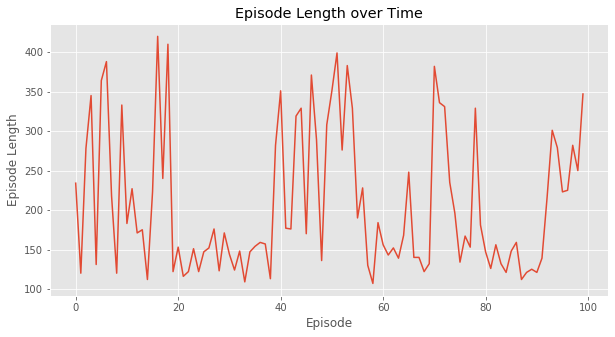

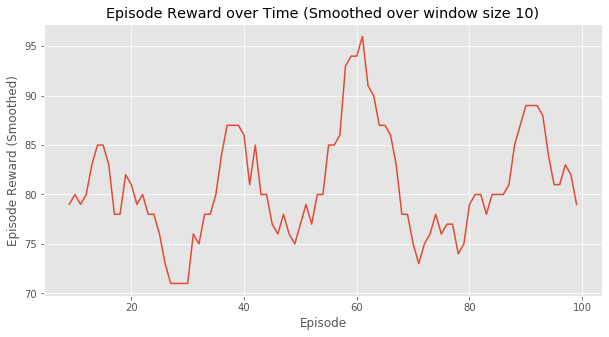

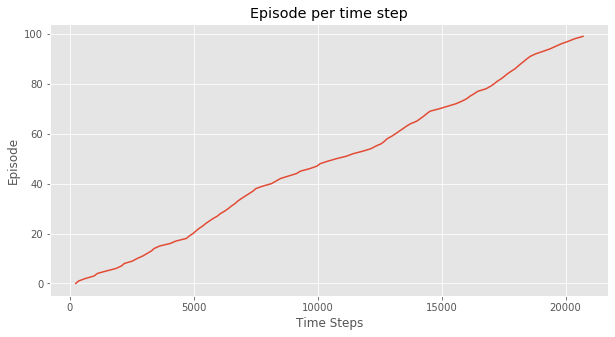

(<Figure size 720x360 with 1 Axes>,
 <Figure size 720x360 with 1 Axes>,
 <Figure size 720x360 with 1 Axes>)

In [41]:
plotting.plot_episode_stats(stats)

In [42]:
Q

defaultdict(<function __main__.qLearning.<locals>.<lambda>()>,
            {0: array([1799.00109337,  716.29096449]),
             8: array([1848.59083891, 1813.37498436]),
             5: array([1796.38949545, 1847.05695919]),
             4: array([1756.24407008, 1765.53456427]),
             7: array([1826.50639926, 1687.91544515]),
             1: array([1779.42092473, 1467.73459675]),
             2: array([  0.        , 167.14378498])})

In [43]:
state

5

In [44]:
np.argmax(Q[0])

0

In [54]:
Q1 = defaultdict(lambda: np.zeros(sim.action_space.n)) 

In [55]:
for i in Q1:
    print(i)
    break

In [56]:
np.zeros(sim.action_space.n)

array([0., 0.])

In [77]:
stats

Stats(episode_lengths=array([234., 120., 278., 345., 131., 364., 388., 218., 120., 333., 183.,
       227., 171., 175., 112., 223., 420., 240., 410., 122., 153., 116.,
       122., 151., 122., 147., 152., 176., 123., 171., 144., 124., 148.,
       109., 147., 154., 159., 157., 113., 282., 351., 177., 176., 319.,
       329., 170., 371., 289., 136., 308., 351., 399., 276., 383., 329.,
       190., 228., 130., 107., 184., 156., 143., 152., 139., 168., 248.,
       140., 140., 122., 132., 382., 336., 331., 235., 196., 134., 167.,
       153., 329., 181., 147., 126., 156., 132., 121., 148., 159., 112.,
       121., 125., 121., 139., 216., 301., 279., 223., 225., 282., 250.,
       347.]), episode_rewards=array([ 80.,  90.,  70.,  60.,  70.,  80., 100., 110.,  90.,  40.,  90.,
        80.,  80.,  90.,  90.,  80.,  80.,  60.,  90.,  80.,  80.,  60.,
        90.,  70.,  90.,  60.,  50.,  40.,  90.,  80.,  80., 110.,  80.,
       100.,  90.,  80.,  90.,  70.,  90.,  80.,  70.,  60., 120.,  50.